In [ ]:
!pip install pillow==8.1.0
!pip install matplotlib==3.3.4
!pip install numpy==1.19.3
!pip install opencv-python==4.5.1.48
!pip install tqdm==4.56.0
!pip install requests==2.25.1

!pip install mediapipe==0.8.3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.2 MB 30.1 MB/s 
  Attempting uninstall: pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 11.5 MB 26.7 MB/s 
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 14.9 MB 26.8 MB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.21.6
    Uninstalling numpy-1.21.6:
      Successfully uninstalled numpy-1.21.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
xarray-einstats 0.2.2 requires numpy>=1.21, but you have numpy 1.19.3 which is incompatible.
tensorflow 2.8.2+zzzcolab20220527125636 requires numpy>=1.20, but you have numpy 1.19.3 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 50.4 MB 94 kB/s 
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30


In [ ]:
import mediapipe as mp # Import mediapipe
import cv2 # Import opencv
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
df = pd.read_csv('./output_dance_poses_csvs_out.csv')

In [ ]:
df.head()

,tga_0002.jpg,tga,370.8836,166.19737,-158.52812,377.1752,156.68784,-148.35297,381.45898,156.48665,...,19.746988,333.53094,597.6098,-2.9106781,400.40195,581.9634,-70.42072,337.55884,636.1778,-108.77513
0,tga_0003.jpg,tga,373.88547,169.10236,-172.79427,380.69003,159.09082,-159.86575,385.18295,159.04402,...,-96.02622,339.59967,603.83264,13.693551,389.71560,596.6481,-206.828400,335.31458,652.91530,-94.48515
1,tga_0004.jpg,tga,373.88547,169.10236,-172.79427,380.69003,159.09082,-159.86575,385.18295,159.04402,...,-96.02622,339.59967,603.83264,13.693551,389.71560,596.6481,-206.828400,335.31458,652.91530,-94.48515
2,tga_0005.jpg,tga,382.42444,176.01562,-115.29100,388.34305,165.25612,-101.94307,392.51846,165.12318,...,110.59864,330.13620,594.99950,148.462550,400.01163,641.3073,3.791495,326.22250,633.32495,34.80406
3,tga_0006.jpg,tga,390.24576,170.34291,-215.08824,396.24158,159.79216,-203.20999,400.59302,159.65700,...,59.75993,342.04767,543.66220,217.578640,390.86987,643.8339,-41.989532,317.53500,587.37630,152.29976
4,tga_0007.jpg,tga,390.24576,170.34291,-215.08824,396.24158,159.79216,-203.20999,400.59302,159.65700,...,59.75993,342.04767,543.66220,217.578640,390.86987,643.8339,-41.989532,317.53500,587.37630,152.29976


In [ ]:
df.tail()

,tga_0002.jpg,tga,370.8836,166.19737,-158.52812,377.1752,156.68784,-148.35297,381.45898,156.48665,...,19.746988,333.53094,597.6098,-2.9106781,400.40195,581.9634,-70.42072,337.55884,636.1778,-108.77513
5632,tg_2159.jpg,tg,252.27792,166.00749,-128.95714,256.00104,148.35939,-126.869446,260.89860,145.98608,...,74.753020,322.10220,646.91740,119.47690,427.34040,677.17390,-37.855583,315.61227,683.86360,12.597491
5633,tg_2161.jpg,tg,249.84763,176.19060,-138.83406,257.14060,160.68027,-139.571720,261.98758,159.12600,...,66.862860,333.63724,647.56600,130.55782,420.87640,673.44446,-44.486840,323.29675,675.20500,29.879799
5634,tg_2162.jpg,tg,263.58650,180.81192,-147.85199,271.68317,164.40701,-153.224580,276.51608,162.54940,...,23.522306,346.19922,660.77450,74.59125,430.91315,682.64996,-77.461105,317.89093,683.53880,-17.789398
5635,tg_2163.jpg,tg,273.01240,177.35669,-202.66020,280.14700,159.53467,-206.446010,285.39752,157.56187,...,65.903910,355.04620,646.10610,143.65323,432.61917,668.64307,-43.329860,342.79468,669.87695,45.376790
5636,tg_2164.jpg,tg,287.46295,174.14392,-153.41057,296.96924,157.35324,-156.493040,302.30700,155.92776,...,53.682720,353.04266,663.97974,123.21069,443.40057,685.66266,-41.407185,321.44510,692.64404,33.005690


In [ ]:
X = [list(i[2:].flatten()) for i in np.array(df)]
X = pd.DataFrame(X)

y = [list(i[1:2].flatten()) for i in np.array(df)]
y = pd.DataFrame(y)
print(len(X), len(y))

5637 5637


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.05, random_state=1234)

In [ ]:
from sklearn.pipeline import make_pipeline 
from sklearn.preprocessing import StandardScaler 

from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
pipelines = {
    'lr':make_pipeline(StandardScaler(), LogisticRegression(solver='lbfgs', max_iter=500)),
    'rf':make_pipeline(StandardScaler(), RandomForestClassifier()),
    'gb':make_pipeline(StandardScaler(), GradientBoostingClassifier()),
    'knn': make_pipeline(StandardScaler(), KNeighborsClassifier(metric='euclidean'))
}

In [ ]:
fit_models = {}
for algo, pipeline in pipelines.items():
    model = pipeline.fit(X_train, y_train.values.ravel())
    fit_models[algo] = model

In [ ]:
fit_models

{'lr': Pipeline(steps=[('standardscaler', StandardScaler()),
                 ('logisticregression', LogisticRegression(max_iter=500))]),
 'rf': Pipeline(steps=[('standardscaler', StandardScaler()),
                 ('randomforestclassifier', RandomForestClassifier())]),
 'gb': Pipeline(steps=[('standardscaler', StandardScaler()),
                 ('gradientboostingclassifier', GradientBoostingClassifier())]),
 'knn': Pipeline(steps=[('standardscaler', StandardScaler()),
                 ('kneighborsclassifier',
                  KNeighborsClassifier(metric='euclidean'))])}

In [ ]:
from sklearn.metrics import accuracy_score # Accuracy metrics 
import pickle

for algo, model in fit_models.items():
    yhat = model.predict(X_test)
    print(algo, accuracy_score(y_test, yhat))

lr 0.9219858156028369
rf 0.9858156028368794
gb 0.975177304964539
knn 0.9680851063829787


In [ ]:
fit_models['rf'].predict(X_test)

array(['tga', 'tga', 'tg', 'tt', 'tt', 'tg', 'tt', 'tt', 'tga', 'tt',
       'tg', 'tt', 'tg', 'tt', 'tg', 'tg', 'tt', 'tga', 'tt', 'tg', 'tg',
       'tga', 'tga', 'tg', 'tg', 'tt', 'tt', 'tga', 'tt', 'tg', 'tga',
       'tg', 'tga', 'tga', 'tg', 'tg', 'tga', 'tga', 'tga', 'tt', 'tga',
       'tga', 'tga', 'tg', 'tt', 'tg', 'tga', 'tt', 'tt', 'tt', 'tg',
       'tga', 'tg', 'tg', 'tg', 'tt', 'tt', 'tg', 'tt', 'tt', 'tg', 'tg',
       'tt', 'tg', 'tga', 'tt', 'tg', 'tg', 'tga', 'tga', 'tga', 'tga',
       'tg', 'tg', 'tt', 'tg', 'tg', 'tt', 'tg', 'tt', 'tt', 'tga', 'tt',
       'tg', 'tga', 'tg', 'tg', 'tga', 'tt', 'tga', 'tga', 'tga', 'tga',
       'tg', 'tga', 'tt', 'tg', 'tg', 'tt', 'tt', 'tg', 'tga', 'tt', 'tg',
       'tg', 'tga', 'tg', 'tg', 'tt', 'tga', 'tga', 'tga', 'tt', 'tg',
       'tt', 'tga', 'tt', 'tg', 'tt', 'tga', 'tt', 'tt', 'tga', 'tt',
       'tt', 'tt', 'tg', 'tga', 'tg', 'tt', 'tt', 'tg', 'tg', 'tt', 'tg',
       'tg', 'tt', 'tga', 'tg', 'tt', 'tt', 'tt', 'tg', 'tg

In [ ]:
with open('pose_classification.pkl', 'wb') as f:
    pickle.dump(fit_models['rf'], f)

In [ ]:
with open('pose_classification.pkl', 'rb') as f:
    model = pickle.load(f)

In [ ]:
model

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestclassifier', RandomForestClassifier())])

In [ ]:
mp_drawing = mp.solutions.drawing_utils # Drawing helpers
mp_pose = mp.solutions.pose # Mediapipe Solutions
mp_holistic = mp.solutions.holistic

In [ ]:
cap = cv2.VideoCapture(0)
# Initiate Pose model
with mp_holistic.Holistic(min_detection_confidence=0.5, min_tracking_confidence=0.5) as holistic:
    while cap.isOpened():
        ret, frame = cap.read()
        # Recolor image to RGB
        # frame = cv2.resize(frame, (700,700), interpolation = cv2.INTER_AREA)
        
        image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        image.flags.writeable = False
      
        # Make detection
        results = holistic.process(image)
    
        # Recolor back to BGR
        image.flags.writeable = True
        image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
        
        
        # Render detections
        mp_drawing.draw_landmarks(image, results.pose_landmarks, mp_pose.POSE_CONNECTIONS,
                                mp_drawing.DrawingSpec(color=(245,117,66), thickness=2, circle_radius=2), 
                                mp_drawing.DrawingSpec(color=(245,66,230), thickness=2, circle_radius=2) 
                                 )               
        # Extract landmarks
        try:
            output_image = image.copy()
            frame_height, frame_width, _ = output_image.shape
            pose_landmarks = results.pose_landmarks.landmark
            # print(pose_landmarks)
            pose_row = list(np.array([[landmark.x*frame_width, landmark.y*frame_height, landmark.z*frame_width] for landmark in pose_landmarks]).flatten())

            # Make Predictions
            X = pd.DataFrame([pose_row])

            dance_class = fit_models['rf'].predict(X)[0]
            dance_class_prob = model.predict_proba(X)[0]
            # print(dance_class, dance_class_prob)

            # Get status box
            cv2.rectangle(image, (0,0), (250, 60), (245, 117, 16), -1)
            
            # Display Class
            cv2.putText(image, 'CLASS'
                        , (95,12), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
            cv2.putText(image, dance_class.split(' ')[0]
                        , (90,40), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
            
            # Display Probability
            cv2.putText(image, 'PROB'
                        , (15,12), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
            cv2.putText(image, str(round(dance_class_prob[np.argmax(dance_class_prob)], 2))
                        , (10,40), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
        except:
            pass
        
        
        cv2.imshow('Mediapipe Feed', image)

        if cv2.waitKey(10) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

In [ ]:
IMAGE_FILES = ['D:/SKRIPSI 2021/Bahan skripsi/Dataset/2/tg/tg_0400.jpg']

with mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5, min_tracking_confidence=0.5) as pose:
  for idx, file in enumerate(IMAGE_FILES):
    image = cv2.imread(file)
    image_height, image_width, _ = image.shape

    # Convert the BGR image to RGB before processing.
    input_image = pose.process(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    

    pose_landmarks = input_image.pose_landmarks.landmark
    pose_row = list(np.array([[landmark.x*image_width, landmark.y*image_height, landmark.z*image_width] for landmark in pose_landmarks], dtype=np.float32).flatten())
    # Make Predictions
    X = pd.DataFrame([pose_row])

    dance_class = model.predict(X)[0]
    dance_class_prob = model.predict_proba(X)[0]
    print(dance_class, dance_class_prob)

    # # Get status box
    cv2.rectangle(image, (0,0), (250, 60), (245, 117, 16), -1)

    # Display Class
    cv2.putText(image, 'CLASS'
            , (95,12), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
    cv2.putText(image, dance_class.split(' ')[0]
            , (90,40), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)

    # Display Probability
    cv2.putText(image, 'PROB'
            , (15,12), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
    cv2.putText(image, str(round(dance_class_prob[np.argmax(dance_class_prob)], 2))
            , (10,40), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)

    # Draw pose landmarks on the image.
    annotated_image = image.copy()
    results = input_image.pose_landmarks
    mp_drawing.draw_landmarks(annotated_image, results, mp_pose.POSE_CONNECTIONS)
    cv2.imwrite('./' + str(idx) + '.png', annotated_image)

tg [0.97 0.   0.03]


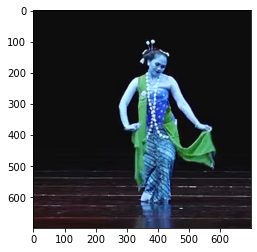

In [ ]:
img_sample = cv2.imread(IMAGE_FILES[0])
plt.imshow(img_sample)

In [ ]:
def show_image(img, figsize=(10, 10)):
  """Shows output PIL image."""
  plt.figure(figsize=figsize)
  plt.imshow(img)
  plt.show()


  0%|                                                                                       | 0/3000.0 [00:00<?, ?it/s]

1270 714


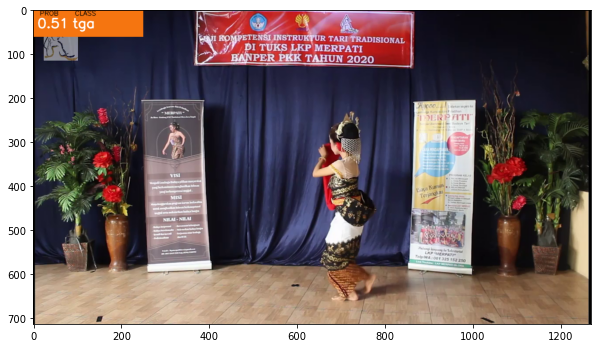

  0%|                                                                               | 3/3000.0 [00:00<09:42,  5.14it/s]

tga [0.35 0.6  0.05]
tga [0.4  0.52 0.08]
tga [0.41 0.53 0.06]


  0%|▏                                                                              | 7/3000.0 [00:01<05:46,  8.65it/s]

tga [0.44 0.51 0.05]
tga [0.37 0.56 0.07]
tga [0.46 0.48 0.06]



  0%|▏                                                                              | 9/3000.0 [00:01<05:13,  9.55it/s]

tga [0.35 0.59 0.06]
tga [0.34 0.6  0.06]
tga [0.35 0.61 0.04]


  0%|▎                                                                             | 13/3000.0 [00:01<05:39,  8.79it/s]

tga [0.36 0.59 0.05]
tga [0.38 0.57 0.05]



  0%|▍                                                                             | 15/3000.0 [00:01<05:15,  9.45it/s]

tga [0.35 0.61 0.04]
tga [0.36 0.56 0.08]
tga [0.33 0.61 0.06]



  1%|▍                                                                             | 17/3000.0 [00:02<05:07,  9.69it/s]

tga [0.31 0.64 0.05]
tga [0.31 0.64 0.05]
tga [0.33 0.62 0.05]


  1%|▌                                                                             | 20/3000.0 [00:02<05:07,  9.69it/s]

tga [0.31 0.64 0.05]
tga [0.31 0.64 0.05]
tga [0.32 0.64 0.04]


  1%|▌                                                                             | 24/3000.0 [00:02<04:38, 10.70it/s]

tga [0.32 0.64 0.04]
tga [0.3  0.65 0.05]
tga [0.33 0.63 0.04]



  1%|▋                                                                             | 26/3000.0 [00:02<04:28, 11.09it/s]

tga [0.33 0.61 0.06]
tga [0.33 0.61 0.06]
tga 

  1%|▊                                                                             | 30/3000.0 [00:03<04:31, 10.95it/s]

[0.28 0.68 0.04]
tga [0.3  0.62 0.08]
tga [0.35 0.58 0.07]



  1%|▊                                                                             | 32/3000.0 [00:03<04:33, 10.87it/s]

tga [0.32 0.6  0.08]
tga [0.39 0.55 0.06]
tga [0.38 0.49 0.13]



  1%|▉                                                                             | 34/3000.0 [00:03<04:29, 10.99it/s]

tga [0.33 0.46 0.21]
tga [0.32 0.44 0.24]
tga [0.39 0.5  0.11]


  1%|▉                                                                             | 38/3000.0 [00:03<04:16, 11.54it/s]

tg [0.45 0.42 0.13]
tga [0.44 0.48 0.08]
tga [0.42 0.51 0.07]


  1%|█                                                                             | 42/3000.0 [00:04<04:03, 12.16it/s]

tga [0.41 0.54 0.05]
tga [0.45 0.46 0.09]
tga [0.44 0.5  0.06]



  1%|█▏                                                                            | 44/3000.0 [00:04<04:29, 10.97it/s]

tga [0.41 0.53 0.06]
tga [0.44 0.51 0.05]
tga [0.43 0.5  0.07]


  2%|█▏                                                                            | 48/3000.0 [00:04<04:21, 11.30it/s]

tga [0.37 0.53 0.1 ]
tga [0.41 0.49 0.1 ]
tg [0.49 0.48 0.03]



  2%|█▎                                                                            | 50/3000.0 [00:05<04:21, 11.28it/s]

tg [0.48 0.48 0.04]
tg [0.51 0.46 0.03]
tg [0.5  0.46 0.04]


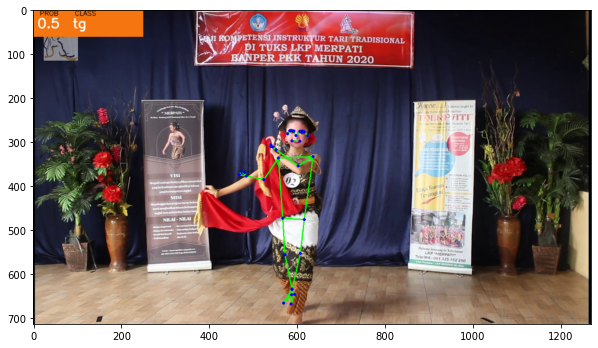

  2%|█▍                                                                            | 54/3000.0 [00:05<06:10,  7.95it/s]

tg [0.51 0.45 0.04]
tg [0.49 0.47 0.04]
tg [0.55 0.42 0.03]



  2%|█▍                                                                            | 56/3000.0 [00:05<05:39,  8.67it/s]

tg [0.48 0.45 0.07]
tg [0.52 0.43 0.05]
tg [0.53 0.43 0.04]


  2%|█▌                                                                            | 60/3000.0 [00:06<04:46, 10.27it/s]

tg [0.52 0.44 0.04]
tg [0.54 0.42 0.04]
tg [0.56 0.33 0.11]



  2%|█▌                                                                            | 62/3000.0 [00:06<04:46, 10.26it/s]

tg [0.56 0.36 0.08]
tg [0.56 0.39 0.05]



  2%|█▋                                                                            | 64/3000.0 [00:06<04:40, 10.48it/s]

tg [0.56 0.34 0.1 ]
tg [0.56 0.35 0.09]
tg [0.56 0.34 0.1 ]


  2%|█▊                                                                            | 68/3000.0 [00:06<04:25, 11.05it/s]

tg [0.55 0.36 0.09]
tg [0.5 0.4 0.1]
tg [0.49 0.39 0.12]



  2%|█▊                                                                            | 70/3000.0 [00:07<04:16, 11.41it/s]

tg [0.48 0.39 0.13]
tg [0.46 0.4  0.14]
tg [0.48 0.35 0.17]



  2%|█▊                                                                            | 72/3000.0 [00:07<04:24, 11.08it/s]

tg [0.5  0.38 0.12]
tg [0.46 0.39 0.15]
tga [0.34 0.48 0.18]


  3%|█▉                                                                            | 76/3000.0 [00:07<04:13, 11.56it/s]

tga [0.32 0.51 0.17]
tga [0.35 0.51 0.14]
tga [0.37 0.5  0.13]


  3%|██                                                                            | 80/3000.0 [00:07<04:09, 11.70it/s]

tga [0.29 0.5  0.21]
tga [0.38 0.46 0.16]
tga [0.39 0.47 0.14]



  3%|██▏                                                                           | 82/3000.0 [00:08<04:16, 11.36it/s]

tga [0.38 0.49 0.13]
tga [0.37 0.49 0.14]
tga [0.36 0.5  0.14]



  3%|██▏                                                                           | 84/3000.0 [00:08<04:22, 11.10it/s]

tga [0.32 0.5  0.18]
tga [0.37 0.49 0.14]


  3%|██▎                                                                           | 88/3000.0 [00:08<04:35, 10.56it/s]

tga [0.39 0.5  0.11]
tga [0.36 0.48 0.16]
tga [0.31 0.59 0.1 ]



  3%|██▎                                                                           | 90/3000.0 [00:08<04:26, 10.91it/s]

tga [0.35 0.52 0.13]
tga [0.36 0.54 0.1 ]
tga [0.4  0.51 0.09]



  3%|██▍                                                                           | 92/3000.0 [00:09<04:25, 10.95it/s]

tga [0.39 0.55 0.06]
tga [0.32 0.61 0.07]
tga [0.38 0.53 0.09]


  3%|██▍                                                                           | 96/3000.0 [00:09<04:26, 10.92it/s]

tga [0.37 0.51 0.12]
tga [0.38 0.47 0.15]
tga [0.39 0.43 0.18]


  3%|██▌                                                                          | 100/3000.0 [00:09<04:15, 11.36it/s]

tga [0.38 0.45 0.17]
tga [0.29 0.56 0.15]
tga [0.32 0.54 0.14]
tga [0.32 0.57 0.11]


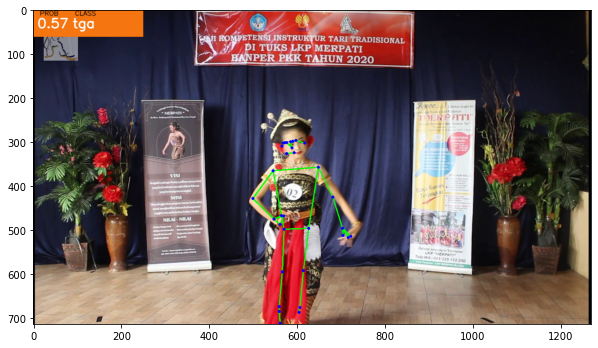


  3%|██▌                                                                          | 102/3000.0 [00:10<07:26,  6.49it/s]

tga [0.31 0.59 0.1 ]


  3%|██▋                                                                          | 104/3000.0 [00:10<07:23,  6.53it/s]

tga [0.3  0.59 0.11]
tga [0.32 0.58 0.1 ]
tga [0.3  0.59 0.11]



  4%|██▋                                                                          | 106/3000.0 [00:10<06:16,  7.69it/s]

tga [0.32 0.59 0.09]
tga [0.32 0.58 0.1 ]
tga 


  4%|██▊                                                                          | 108/3000.0 [00:11<05:44,  8.39it/s]

[0.34 0.57 0.09]
tga [0.37 0.52 0.11]
tga [0.37 0.52 0.11]


  4%|██▉                                                                          | 113/3000.0 [00:11<05:05,  9.46it/s]

tga [0.38 0.51 0.11]
tga [0.37 0.52 0.11]
tga [0.35 0.54 0.11]


  4%|██▉                                                                          | 115/3000.0 [00:11<05:06,  9.42it/s]

tga [0.38 0.51 0.11]
tga [0.37 0.52 0.11]
tga [0.38 0.51 0.11]



  4%|███                                                                          | 117/3000.0 [00:12<04:41, 10.23it/s]

tga [0.37 0.52 0.11]
tga [0.38 0.51 0.11]
tga [0.37 0.52 0.11]


  4%|███                                                                          | 121/3000.0 [00:12<04:30, 10.64it/s]

tga [0.37 0.53 0.1 ]
tga [0.36 0.54 0.1 ]
tga [0.36 0.54 0.1 ]


  4%|███▏                                                                         | 125/3000.0 [00:12<04:04, 11.77it/s]

tga [0.35 0.55 0.1 ]
tga [0.35 0.55 0.1 ]
tga [0.33 0.55 0.12]



  4%|███▎                                                                         | 127/3000.0 [00:12<04:11, 11.43it/s]

tga [0.37 0.51 0.12]
tga [0.38 0.49 0.13]
tga [0.39 0.48 0.13]


  4%|███▎                                                                         | 131/3000.0 [00:13<04:03, 11.76it/s]

tga [0.43 0.44 0.13]
tga [0.43 0.46 0.11]
tga [0.43 0.46 0.11]



  4%|███▍                                                                         | 133/3000.0 [00:13<04:03, 11.75it/s]

tga [0.43 0.46 0.11]
tga [0.41 0.47 0.12]
tga [0.33 0.56 0.11]


  5%|███▌                                                                         | 137/3000.0 [00:13<03:57, 12.04it/s]

tga [0.34 0.56 0.1 ]
tga [0.32 0.58 0.1 ]
tga [0.34 0.55 0.11]



  5%|███▌                                                                         | 139/3000.0 [00:13<03:57, 12.05it/s]

tga [0.32 0.57 0.11]
tga [0.34 0.55 0.11]
tga [0.36 0.55 0.09]


  5%|███▋                                                                         | 143/3000.0 [00:14<03:55, 12.16it/s]

tga [0.38 0.53 0.09]
tga [0.36 0.54 0.1 ]
tg [0.44 0.44 0.12]



  5%|███▋                                                                         | 145/3000.0 [00:14<03:59, 11.91it/s]

tg [0.43 0.42 0.15]
tg [0.43 0.43 0.14]
tg [0.45 0.41 0.14]


  5%|███▊                                                                         | 149/3000.0 [00:14<03:54, 12.14it/s]

tg [0.45 0.43 0.12]
tga [0.42 0.47 0.11]
tg [0.45 0.44 0.11]
tg [0.44 0.43 0.13]
tga [0.39 0.5  0.11]


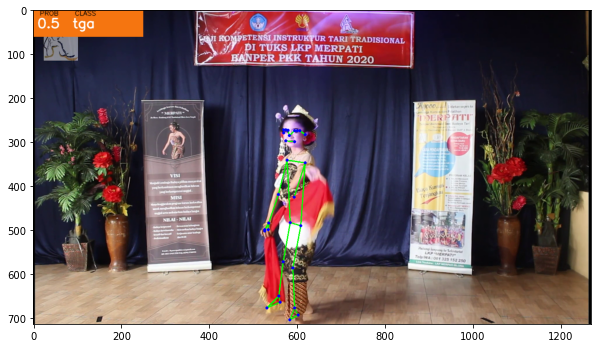

  5%|███▉                                                                         | 153/3000.0 [00:15<05:44,  8.26it/s]

tga [0.38 0.52 0.1 ]
tga [0.33 0.51 0.16]
tga [0.34 0.48 0.18]


  5%|████                                                                         | 157/3000.0 [00:15<04:46,  9.91it/s]

tga [0.34 0.51 0.15]
tga [0.37 0.48 0.15]
tga [0.44 0.45 0.11]



  5%|████                                                                         | 159/3000.0 [00:15<04:35, 10.32it/s]

tga [0.4  0.48 0.12]
tga [0.39 0.51 0.1 ]
tga [0.36 0.49 0.15]


  5%|████▏                                                                        | 163/3000.0 [00:16<04:14, 11.17it/s]

tga [0.34 0.52 0.14]
tga [0.33 0.51 0.16]
tga [0.37 0.49 0.14]



  6%|████▏                                                                        | 165/3000.0 [00:16<04:09, 11.36it/s]

tga [0.41 0.43 0.16]
tg [0.45 0.38 0.17]
tg [0.44 0.4  0.16]


  6%|████▎                                                                        | 169/3000.0 [00:16<04:01, 11.74it/s]

tga [0.39 0.46 0.15]
tga [0.38 0.48 0.14]
tga [0.39 0.49 0.12]



  6%|████▍                                                                        | 171/3000.0 [00:16<03:54, 12.07it/s]

tga [0.4  0.47 0.13]
tga [0.39 0.48 0.13]
tga [0.37 0.49 0.14]


  6%|████▍                                                                        | 175/3000.0 [00:17<03:51, 12.21it/s]

tga [0.37 0.52 0.11]
tga [0.38 0.51 0.11]
tga [0.4  0.47 0.13]



  6%|████▌                                                                        | 177/3000.0 [00:17<03:57, 11.90it/s]

tga [0.4  0.49 0.11]
tga [0.36 0.53 0.11]
tga [0.34 0.55 0.11]


  6%|████▋                                                                        | 181/3000.0 [00:17<03:54, 12.00it/s]

tga [0.33 0.55 0.12]
tga [0.33 0.55 0.12]
tga [0.4  0.47 0.13]



  6%|████▋                                                                        | 183/3000.0 [00:17<03:51, 12.15it/s]

tga [0.42 0.45 0.13]
tga [0.41 0.48 0.11]
tga [0.37 0.51 0.12]


  6%|████▊                                                                        | 187/3000.0 [00:18<03:50, 12.21it/s]

tga [0.31 0.55 0.14]
tga [0.3  0.52 0.18]
tga [0.39 0.45 0.16]



  6%|████▊                                                                        | 189/3000.0 [00:18<03:53, 12.03it/s]

tga [0.32 0.55 0.13]
tga [0.38 0.48 0.14]
tga [0.33 0.5  0.17]


  6%|████▉                                                                        | 193/3000.0 [00:18<04:00, 11.67it/s]

tga [0.34 0.49 0.17]
tga [0.35 0.46 0.19]
tga [0.38 0.47 0.15]



  6%|█████                                                                        | 195/3000.0 [00:18<04:12, 11.11it/s]

tga [0.38 0.45 0.17]
tg [0.43 0.39 0.18]
tga [0.37 0.46 0.17]



  7%|█████                                                                        | 197/3000.0 [00:19<04:23, 10.65it/s]

tg [0.43 0.42 0.15]
tga [0.42 0.44 0.14]



  7%|█████                                                                        | 199/3000.0 [00:19<04:30, 10.35it/s]

tga [0.41 0.45 0.14]
tga [0.35 0.48 0.17]
tga [0.42 0.46 0.12]


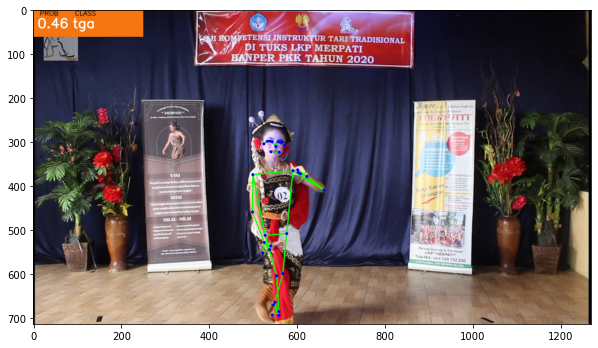

  7%|█████▏                                                                       | 203/3000.0 [00:20<06:25,  7.26it/s]

tga [0.42 0.44 0.14]
tg [0.43 0.43 0.14]
tga [0.42 0.46 0.12]


  7%|█████▎                                                                       | 207/3000.0 [00:20<05:15,  8.84it/s]

tga [0.39 0.48 0.13]
tga [0.42 0.45 0.13]
tga [0.39 0.5  0.11]



  7%|█████▎                                                                       | 209/3000.0 [00:20<04:53,  9.50it/s]

tga [0.41 0.48 0.11]
tga [0.39 0.5  0.11]
tga [0.4 0.5 0.1]


  7%|█████▍                                                                       | 213/3000.0 [00:20<04:18, 10.78it/s]

tga [0.35 0.51 0.14]
tga [0.38 0.51 0.11]
tga [0.37 0.51 0.12]



  7%|█████▌                                                                       | 215/3000.0 [00:21<04:06, 11.28it/s]

tga [0.39 0.49 0.12]
tga [0.39 0.5  0.11]
tga [0.36 0.5  0.14]


  7%|█████▌                                                                       | 219/3000.0 [00:21<03:57, 11.72it/s]

tga [0.37 0.52 0.11]
tga [0.37 0.51 0.12]
tga [0.34 0.52 0.14]



  7%|█████▋                                                                       | 221/3000.0 [00:21<03:53, 11.90it/s]

tga [0.36 0.52 0.12]
tga [0.37 0.5  0.13]
tga [0.38 0.5  0.12]


  8%|█████▊                                                                       | 225/3000.0 [00:21<03:47, 12.17it/s]

tga [0.39 0.5  0.11]
tga [0.4 0.5 0.1]
tga [0.4 0.5 0.1]



  8%|█████▊                                                                       | 227/3000.0 [00:22<03:48, 12.11it/s]

tga [0.42 0.5  0.08]
tga [0.39 0.53 0.08]
tga [0.38 0.54 0.08]



  8%|█████▉                                                                       | 229/3000.0 [00:22<03:59, 11.55it/s]

tga [0.34 0.55 0.11]
tga [0.36 0.53 0.11]
tga [0.38 0.53 0.09]


  8%|█████▉                                                                       | 233/3000.0 [00:22<04:09, 11.09it/s]

tga [0.39 0.54 0.07]
tga [0.37 0.56 0.07]
tga [0.36 0.54 0.1 ]



  8%|██████                                                                       | 235/3000.0 [00:22<04:15, 10.81it/s]

tga [0.37 0.53 0.1 ]
tga [0.36 0.54 0.1 ]
tga 


  8%|██████                                                                       | 237/3000.0 [00:23<04:18, 10.67it/s]

[0.35 0.52 0.13]
tga [0.36 0.55 0.09]
tga [0.36 0.53 0.11]


  8%|██████▏                                                                      | 241/3000.0 [00:23<04:12, 10.91it/s]

tga [0.35 0.54 0.11]
tga [0.35 0.54 0.11]
tga [0.34 0.55 0.11]


  8%|██████▎                                                                      | 245/3000.0 [00:23<04:04, 11.29it/s]

tga [0.35 0.54 0.11]
tga [0.36 0.53 0.11]
tga [0.37 0.52 0.11]



  8%|██████▎                                                                      | 247/3000.0 [00:23<04:11, 10.94it/s]

tga [0.37 0.52 0.11]
tga [0.35 0.54 0.11]
tga [0.37 0.53 0.1 ]



  8%|██████▍                                                                      | 249/3000.0 [00:24<04:14, 10.81it/s]

tga [0.36 0.54 0.1 ]
tga [0.33 0.55 0.12]
tga [0.32 0.57 0.11]


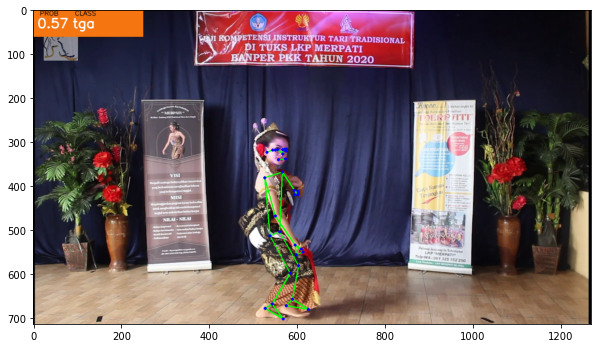

  8%|██████▌                                                                      | 254/3000.0 [00:25<05:36,  8.16it/s]

tga [0.32 0.55 0.13]
tga [0.35 0.53 0.12]
tga [0.37 0.52 0.11]



  9%|██████▌                                                                      | 256/3000.0 [00:25<04:57,  9.24it/s]

tga [0.38 0.52 0.1 ]
tga [0.39 0.51 0.1 ]
tga [0.36 0.53 0.11]


  9%|██████▋                                                                      | 260/3000.0 [00:25<04:21, 10.47it/s]

tga [0.36 0.56 0.08]
tga [0.38 0.51 0.11]
tga [0.37 0.52 0.11]



  9%|██████▋                                                                      | 262/3000.0 [00:25<04:12, 10.85it/s]

tga [0.35 0.53 0.12]
tga [0.39 0.5  0.11]
tga [0.34 0.51 0.15]


  9%|██████▊                                                                      | 266/3000.0 [00:26<04:05, 11.15it/s]

tga [0.41 0.45 0.14]
tga [0.39 0.47 0.14]
tga [0.36 0.52 0.12]



  9%|██████▉                                                                      | 268/3000.0 [00:26<03:59, 11.41it/s]

tga [0.35 0.5  0.15]
tga [0.42 0.46 0.12]
tga [0.41 0.48 0.11]


  9%|██████▉                                                                      | 272/3000.0 [00:26<03:55, 11.59it/s]

tga [0.43 0.45 0.12]
tga [0.36 0.52 0.12]
tga [0.43 0.47 0.1 ]



  9%|███████                                                                      | 274/3000.0 [00:26<03:53, 11.66it/s]

tga [0.4  0.48 0.12]
tg [0.43 0.41 0.16]
tg [0.44 0.41 0.15]



  9%|███████                                                                      | 276/3000.0 [00:26<04:02, 11.22it/s]

tg [0.46 0.35 0.19]
tg [0.46 0.42 0.12]
tg 


  9%|███████▏                                                                     | 278/3000.0 [00:27<04:10, 10.86it/s]

[0.44 0.41 0.15]
tga [0.4  0.44 0.16]
tga [0.42 0.48 0.1 ]


  9%|███████▏                                                                     | 282/3000.0 [00:27<04:21, 10.38it/s]

tg [0.45 0.45 0.1 ]
tga [0.41 0.47 0.12]
tga [0.41 0.43 0.16]


 10%|███████▎                                                                     | 286/3000.0 [00:27<04:19, 10.48it/s]

tga [0.4  0.43 0.17]
tga [0.41 0.44 0.15]
tga [0.4  0.44 0.16]



 10%|███████▍                                                                     | 288/3000.0 [00:28<04:17, 10.53it/s]

tga [0.39 0.49 0.12]
tga [0.34 0.51 0.15]
tga [0.34 0.55 0.11]


 10%|███████▍                                                                     | 292/3000.0 [00:28<04:04, 11.09it/s]

tga [0.29 0.59 0.12]
tga [0.33 0.53 0.14]
tga [0.31 0.58 0.11]



 10%|███████▌                                                                     | 294/3000.0 [00:28<03:59, 11.30it/s]

tga [0.29 0.58 0.13]
tga [0.27 0.59 0.14]
tga [0.32 0.54 0.14]


 10%|███████▋                                                                     | 298/3000.0 [00:28<03:53, 11.58it/s]

tga [0.31 0.57 0.12]
tga [0.35 0.54 0.11]
tga [0.36 0.53 0.11]



 10%|███████▋                                                                     | 300/3000.0 [00:29<03:50, 11.69it/s]

tga [0.34 0.57 0.09]
tga [0.34 0.58 0.08]
tga [0.34 0.57 0.09]


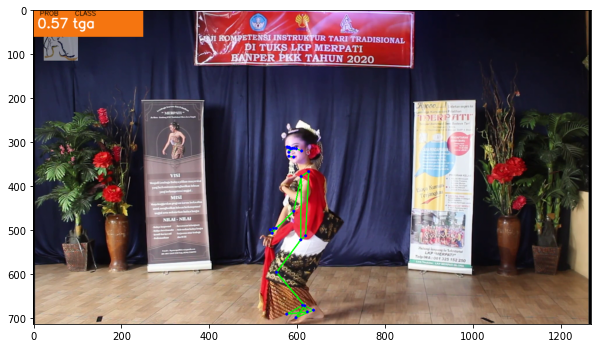


 10%|███████▊                                                                     | 302/3000.0 [00:30<09:04,  4.96it/s]

tga [0.38 0.51 0.11]
tga [0.35 0.56 0.09]
tga [0.38 0.5  0.12]


 10%|███████▊                                                                     | 305/3000.0 [00:30<07:14,  6.20it/s]

tga [0.38 0.49 0.13]



 10%|███████▊                                                                     | 306/3000.0 [00:30<07:46,  5.77it/s]

tga [0.34 0.52 0.14]
tga [0.37 0.53 0.1 ]
tga [0.37 0.52 0.11]


 10%|███████▉                                                                     | 309/3000.0 [00:30<06:07,  7.33it/s]

tga [0.37 0.49 0.14]
tga [0.33 0.53 0.14]
tga [0.35 0.49 0.16]


 10%|████████                                                                     | 313/3000.0 [00:31<04:57,  9.03it/s]

tga [0.41 0.48 0.11]
tga [0.36 0.55 0.09]
tga [0.34 0.56 0.1 ]



 10%|████████                                                                     | 315/3000.0 [00:31<04:44,  9.45it/s]

tga [0.34 0.57 0.09]
tga [0.34 0.58 0.08]
tga [0.35 0.55 0.1 ]


 11%|████████▏                                                                    | 319/3000.0 [00:31<04:26, 10.05it/s]

tga [0.37 0.54 0.09]
tga [0.36 0.55 0.09]
tga 


 11%|████████▏                                                                    | 321/3000.0 [00:31<04:12, 10.60it/s]

[0.4 0.5 0.1]
tga [0.38 0.48 0.14]
tga [0.34 0.5  0.16]


 11%|████████▎                                                                    | 325/3000.0 [00:32<03:56, 11.32it/s]

tga [0.41 0.45 0.14]
tga [0.38 0.49 0.13]
tga [0.37 0.51 0.12]



 11%|████████▍                                                                    | 327/3000.0 [00:32<03:56, 11.32it/s]

tga [0.37 0.52 0.11]
tga [0.36 0.52 0.12]
tga [0.37 0.57 0.06]



 11%|████████▍                                                                    | 329/3000.0 [00:32<04:21, 10.20it/s]

tga [0.4  0.54 0.06]
tga [0.44 0.49 0.07]
tga [0.36 0.51 0.13]


 11%|████████▌                                                                    | 333/3000.0 [00:33<04:31,  9.83it/s]

tga [0.39 0.51 0.1 ]
tga [0.3  0.56 0.14]
tga [0.26 0.58 0.16]


 11%|████████▌                                                                    | 335/3000.0 [00:33<04:35,  9.66it/s]

tga [0.38 0.46 0.16]
tg [0.43 0.4  0.17]
tga [0.42 0.46 0.12]


 11%|████████▋                                                                    | 339/3000.0 [00:33<04:15, 10.43it/s]

tga [0.39 0.45 0.16]
tga [0.39 0.46 0.15]
tga [0.42 0.45 0.13]



 11%|████████▊                                                                    | 341/3000.0 [00:33<04:08, 10.68it/s]

tga [0.4  0.48 0.12]
tga [0.42 0.44 0.14]



 11%|████████▊                                                                    | 343/3000.0 [00:34<04:22, 10.13it/s]

tga [0.45 0.46 0.09]
tg [0.44 0.41 0.15]



 12%|████████▊                                                                    | 345/3000.0 [00:34<04:23, 10.06it/s]

tg [0.43 0.42 0.15]
tga [0.43 0.45 0.12]


 12%|████████▉                                                                    | 348/3000.0 [00:34<05:05,  8.67it/s]

tga [0.35 0.51 0.14]
tga [0.4  0.48 0.12]


 12%|████████▉                                                                    | 350/3000.0 [00:35<06:23,  6.91it/s]

tga [0.41 0.46 0.13]
tga [0.42 0.45 0.13]
tga [0.36 0.5  0.14]


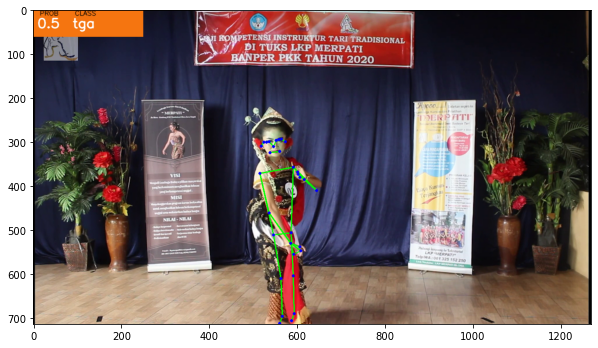

 12%|█████████                                                                    | 353/3000.0 [00:36<09:07,  4.84it/s]

tga [0.4  0.47 0.13]
tga [0.37 0.48 0.15]



 12%|█████████                                                                    | 354/3000.0 [00:36<07:52,  5.60it/s]

tga [0.36 0.49 0.15]
tga [0.37 0.5  0.13]


 12%|█████████▏                                                                   | 357/3000.0 [00:36<06:09,  7.15it/s]

tga [0.35 0.52 0.13]
tga [0.4  0.49 0.11]



 12%|█████████▏                                                                   | 359/3000.0 [00:36<05:23,  8.16it/s]

tga [0.42 0.46 0.12]
tga [0.38 0.5  0.12]



 12%|█████████▎                                                                   | 361/3000.0 [00:36<04:59,  8.81it/s]

tga [0.4  0.49 0.11]
tga [0.38 0.52 0.1 ]
tga [0.39 0.54 0.07]


 12%|█████████▎                                                                   | 364/3000.0 [00:37<05:12,  8.44it/s]

tga [0.45 0.48 0.07]
tga [0.4  0.51 0.09]


 12%|█████████▍                                                                   | 366/3000.0 [00:37<05:00,  8.77it/s]

tga [0.45 0.48 0.07]
tga [0.44 0.5  0.06]



 12%|█████████▍                                                                   | 367/3000.0 [00:37<04:52,  9.01it/s]

tga [0.44 0.49 0.07]
tga [0.42 0.51 0.07]
tga [0.44 0.49 0.07]


 12%|█████████▌                                                                   | 371/3000.0 [00:37<04:24,  9.96it/s]

tga [0.43 0.5  0.07]
tga [0.4  0.53 0.07]
tga [0.39 0.54 0.07]


 12%|█████████▌                                                                   | 374/3000.0 [00:38<04:40,  9.37it/s]

tga [0.4  0.52 0.08]
tga [0.39 0.54 0.07]


 13%|█████████▋                                                                   | 376/3000.0 [00:38<04:38,  9.41it/s]

tga [0.37 0.57 0.06]
tga [0.38 0.56 0.06]



 13%|█████████▋                                                                   | 378/3000.0 [00:38<04:28,  9.76it/s]

tga [0.37 0.56 0.07]
tga [0.38 0.52 0.1 ]
tga [0.37 0.53 0.1 ]


 13%|█████████▊                                                                   | 381/3000.0 [00:38<04:15, 10.27it/s]

tga [0.39 0.53 0.08]
tga [0.37 0.54 0.09]
tga [0.38 0.52 0.1 ]



 13%|█████████▊                                                                   | 383/3000.0 [00:39<04:16, 10.21it/s]

tga [0.37 0.53 0.1 ]
tga [0.35 0.54 0.11]
tga [0.35 0.53 0.12]


 13%|█████████▉                                                                   | 387/3000.0 [00:39<04:29,  9.71it/s]

tga [0.36 0.54 0.1 ]
tga [0.36 0.54 0.1 ]


 13%|█████████▉                                                                   | 389/3000.0 [00:39<04:49,  9.03it/s]

tga [0.34 0.55 0.11]
tga [0.33 0.54 0.13]


 13%|██████████                                                                   | 391/3000.0 [00:40<05:05,  8.55it/s]

tga [0.34 0.54 0.12]
tga [0.3  0.58 0.12]


 13%|██████████                                                                   | 393/3000.0 [00:40<05:05,  8.54it/s]

tga [0.3  0.58 0.12]
tga [0.29 0.57 0.14]



 13%|██████████                                                                   | 394/3000.0 [00:40<05:23,  8.06it/s]

tga [0.34 0.54 0.12]



 13%|██████████▏                                                                  | 395/3000.0 [00:40<06:40,  6.51it/s]

tga [0.36 0.52 0.12]



 13%|██████████▏                                                                  | 396/3000.0 [00:40<08:09,  5.32it/s]

tga [0.37 0.52 0.11]


 13%|██████████▏                                                                  | 398/3000.0 [00:41<07:50,  5.53it/s]

tga [0.37 0.52 0.11]
tga [0.39 0.51 0.1 ]


 13%|██████████▎                                                                  | 400/3000.0 [00:41<06:33,  6.61it/s]

tga [0.4  0.49 0.11]
tga [0.4 0.5 0.1]
tga [0.34 0.52 0.14]


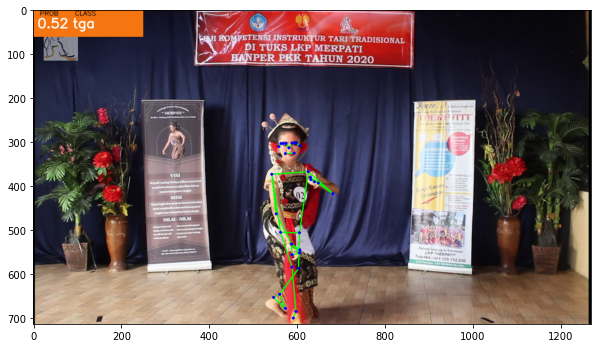

 13%|██████████▎                                                                  | 403/3000.0 [00:42<08:31,  5.08it/s]

tga [0.37 0.51 0.12]
tga [0.39 0.47 0.14]


 14%|██████████▍                                                                  | 405/3000.0 [00:42<06:58,  6.21it/s]

tga [0.42 0.46 0.12]
tg [0.44 0.44 0.12]


 14%|██████████▍                                                                  | 407/3000.0 [00:42<06:20,  6.82it/s]

tga [0.37 0.5  0.13]
tga [0.4  0.49 0.11]


 14%|██████████▍                                                                  | 409/3000.0 [00:43<05:27,  7.91it/s]

tga [0.36 0.48 0.16]
tg [0.43 0.41 0.16]


 14%|██████████▌                                                                  | 411/3000.0 [00:43<04:59,  8.66it/s]

tga [0.39 0.44 0.17]
tga [0.33 0.53 0.14]
tga [0.35 0.52 0.13]


 14%|██████████▋                                                                  | 414/3000.0 [00:43<04:48,  8.96it/s]

tga [0.35 0.56 0.09]
tga [0.39 0.49 0.12]


 14%|██████████▋                                                                  | 416/3000.0 [00:43<05:00,  8.61it/s]

tga [0.39 0.47 0.14]
tga [0.39 0.47 0.14]
tga [0.41 0.49 0.1 ]


 14%|██████████▊                                                                  | 420/3000.0 [00:44<04:15, 10.08it/s]

tga [0.43 0.46 0.11]
tga [0.43 0.46 0.11]
tga [0.42 0.47 0.11]



 14%|██████████▊                                                                  | 422/3000.0 [00:44<04:19,  9.93it/s]

tga [0.41 0.44 0.15]
tg [0.44 0.44 0.12]


 14%|██████████▉                                                                  | 424/3000.0 [00:44<04:43,  9.08it/s]

tga [0.39 0.48 0.13]
tga [0.41 0.43 0.16]



 14%|██████████▉                                                                  | 425/3000.0 [00:44<04:44,  9.06it/s]

tga [0.39 0.44 0.17]
tga [0.27 0.59 0.14]
tga 

 14%|███████████                                                                  | 429/3000.0 [00:45<04:12, 10.19it/s]

[0.37 0.46 0.17]
tga [0.31 0.55 0.14]
tga [0.28 0.57 0.15]



 14%|███████████                                                                  | 431/3000.0 [00:45<04:18,  9.95it/s]

tga [0.33 0.53 0.14]
tga [0.29 0.58 0.13]



 14%|███████████                                                                  | 432/3000.0 [00:45<04:19,  9.88it/s]

tga [0.28 0.61 0.11]
tga [0.3  0.55 0.15]
tga [0.33 0.55 0.12]


 15%|███████████▏                                                                 | 436/3000.0 [00:45<04:09, 10.29it/s]

tga [0.29 0.57 0.14]
tga [0.28 0.6  0.12]
tga [0.32 0.57 0.11]



 15%|███████████▏                                                                 | 438/3000.0 [00:46<04:10, 10.24it/s]

tga [0.37 0.52 0.11]
tga [0.38 0.53 0.09]
tga [0.36 0.56 0.08]


 15%|███████████▎                                                                 | 442/3000.0 [00:46<04:00, 10.62it/s]

tga [0.35 0.54 0.11]
tga [0.36 0.56 0.08]
tga [0.35 0.57 0.08]


 15%|███████████▍                                                                 | 446/3000.0 [00:46<03:52, 10.98it/s]

tga [0.38 0.53 0.09]
tga [0.37 0.54 0.09]
tga [0.34 0.56 0.1 ]



 15%|███████████▍                                                                 | 448/3000.0 [00:46<04:03, 10.48it/s]

tga [0.36 0.56 0.08]
tga [0.34 0.57 0.09]
tga 


 15%|███████████▌                                                                 | 450/3000.0 [00:47<04:04, 10.42it/s]

[0.35 0.56 0.09]
tga [0.35 0.56 0.09]
tga [0.35 0.56 0.09]


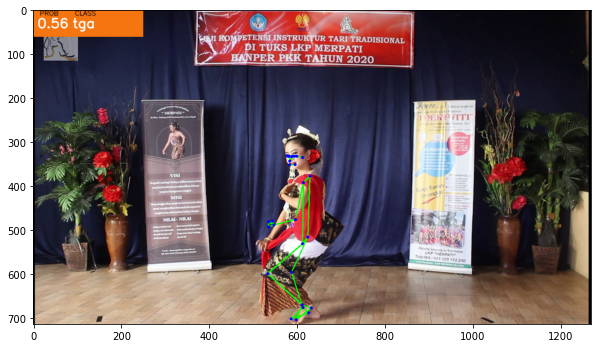


 15%|███████████▌                                                                 | 452/3000.0 [00:47<07:06,  5.97it/s]

tga [0.33 0.59 0.08]
tga [0.33 0.57 0.1 ]
tga [0.33 0.58 0.09]


 15%|███████████▋                                                                 | 455/3000.0 [00:48<05:56,  7.13it/s]

tga [0.35 0.57 0.08]
tga [0.36 0.55 0.09]
tga [0.38 0.49 0.13]


 15%|███████████▊                                                                 | 459/3000.0 [00:48<04:43,  8.97it/s]

tga [0.35 0.53 0.12]
tga [0.4  0.48 0.12]
tga [0.38 0.51 0.11]



 15%|███████████▊                                                                 | 461/3000.0 [00:48<04:16,  9.88it/s]

tga [0.39 0.5  0.11]
tga [0.39 0.51 0.1 ]
tga [0.42 0.48 0.1 ]


 16%|███████████▉                                                                 | 465/3000.0 [00:49<04:07, 10.23it/s]

tga [0.42 0.49 0.09]
tga [0.41 0.51 0.08]
tga [0.41 0.51 0.08]



 16%|███████████▉                                                                 | 467/3000.0 [00:49<04:05, 10.33it/s]

tga [0.44 0.49 0.07]
tg [0.43 0.43 0.14]
tga [0.4  0.43 0.17]


 16%|████████████                                                                 | 471/3000.0 [00:49<04:02, 10.41it/s]

tga [0.37 0.48 0.15]
tga [0.37 0.49 0.14]
tga [0.35 0.55 0.1 ]



 16%|████████████▏                                                                | 473/3000.0 [00:49<04:00, 10.53it/s]

tga [0.42 0.43 0.15]
tg [0.47 0.42 0.11]
tga [0.42 0.45 0.13]


 16%|████████████▏                                                                | 477/3000.0 [00:50<03:53, 10.81it/s]

tg [0.42 0.39 0.19]
tga [0.37 0.45 0.18]
tga [0.39 0.46 0.15]



 16%|████████████▎                                                                | 479/3000.0 [00:50<03:46, 11.13it/s]

tga [0.4  0.45 0.15]
tga [0.38 0.46 0.16]
tga [0.39 0.5  0.11]


 16%|████████████▍                                                                | 483/3000.0 [00:50<03:59, 10.52it/s]

tga [0.39 0.5  0.11]
tga [0.37 0.51 0.12]
tga [0.36 0.52 0.12]



 16%|████████████▍                                                                | 485/3000.0 [00:50<04:06, 10.21it/s]

tga [0.35 0.51 0.14]
tga [0.36 0.52 0.12]



 16%|████████████▍                                                                | 487/3000.0 [00:51<04:32,  9.22it/s]

tga [0.36 0.52 0.12]


 16%|████████████▌                                                                | 489/3000.0 [00:51<05:35,  7.48it/s]

tga [0.36 0.5  0.14]
tga [0.37 0.5  0.13]


 16%|████████████▌                                                                | 491/3000.0 [00:51<05:37,  7.44it/s]

tga [0.36 0.51 0.13]
tga [0.35 0.53 0.12]


 16%|████████████▋                                                                | 493/3000.0 [00:52<05:10,  8.08it/s]

tga [0.36 0.52 0.12]
tga [0.35 0.52 0.13]
tga [0.38 0.5  0.12]

 16%|████████████▋                                                                | 495/3000.0 [00:52<05:05,  8.19it/s]


tga [0.38 0.5  0.12]


 17%|████████████▊                                                                | 497/3000.0 [00:52<05:30,  7.58it/s]

tga [0.37 0.51 0.12]
tga [0.37 0.51 0.12]


 17%|████████████▊                                                                | 499/3000.0 [00:52<05:40,  7.34it/s]

tga [0.35 0.53 0.12]
tga [0.34 0.53 0.13]



 17%|████████████▊                                                                | 500/3000.0 [00:53<05:23,  7.73it/s]

tga [0.35 0.52 0.13]
tga [0.34 0.53 0.13]


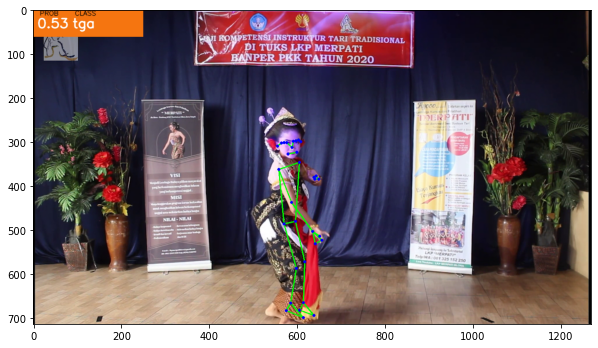

 17%|████████████▉                                                                | 503/3000.0 [00:53<08:22,  4.97it/s]

tga [0.37 0.51 0.12]
tga [0.37 0.52 0.11]
tga [0.36 0.52 0.12]


 17%|█████████████                                                                | 507/3000.0 [00:54<05:19,  7.81it/s]

tga [0.36 0.52 0.12]
tga [0.4  0.48 0.12]
tga [0.36 0.51 0.13]



 17%|█████████████                                                                | 509/3000.0 [00:54<04:38,  8.94it/s]

tga [0.4  0.47 0.13]
tga [0.34 0.53 0.13]
tga [0.39 0.49 0.12]


 17%|█████████████▏                                                               | 513/3000.0 [00:54<03:52, 10.71it/s]

tga [0.4  0.54 0.06]
tga [0.4  0.53 0.07]
tga [0.41 0.53 0.06]



 17%|█████████████▏                                                               | 515/3000.0 [00:54<03:38, 11.38it/s]

tga [0.42 0.52 0.06]
tga [0.4  0.53 0.07]
tga [0.39 0.55 0.06]


 17%|█████████████▎                                                               | 519/3000.0 [00:55<03:32, 11.67it/s]

tga [0.39 0.54 0.07]
tga [0.34 0.58 0.08]
tga [0.34 0.58 0.08]



 17%|█████████████▎                                                               | 521/3000.0 [00:55<03:29, 11.84it/s]

tga [0.31 0.6  0.09]
tga [0.35 0.56 0.09]
tga [0.38 0.54 0.08]


 18%|█████████████▍                                                               | 525/3000.0 [00:55<03:30, 11.77it/s]

tga [0.38 0.54 0.08]
tga [0.36 0.56 0.08]
tga [0.32 0.58 0.1 ]



 18%|█████████████▌                                                               | 527/3000.0 [00:55<03:33, 11.61it/s]

tga [0.31 0.56 0.13]
tga [0.31 0.56 0.13]
tga [0.31 0.55 0.14]


 18%|█████████████▋                                                               | 531/3000.0 [00:56<03:29, 11.76it/s]

tga [0.3  0.57 0.13]
tga [0.31 0.56 0.13]
tga [0.31 0.55 0.14]



 18%|█████████████▋                                                               | 533/3000.0 [00:56<03:32, 11.62it/s]

tga [0.37 0.52 0.11]
tga [0.37 0.53 0.1 ]
tga [0.38 0.5  0.12]


 18%|█████████████▊                                                               | 537/3000.0 [00:56<03:29, 11.75it/s]

tga [0.37 0.49 0.14]
tga [0.35 0.52 0.13]
tga [0.35 0.5  0.15]



 18%|█████████████▊                                                               | 539/3000.0 [00:56<03:46, 10.85it/s]

tga [0.38 0.49 0.13]
tga [0.36 0.51 0.13]



 18%|█████████████▉                                                               | 541/3000.0 [00:57<04:07,  9.92it/s]

tga [0.41 0.49 0.1 ]
tga [0.38 0.48 0.14]



 18%|█████████████▉                                                               | 543/3000.0 [00:57<04:04, 10.04it/s]

tga [0.39 0.47 0.14]
tga [0.41 0.46 0.13]
tga [0.41 0.47 0.12]


 18%|██████████████                                                               | 547/3000.0 [00:57<03:45, 10.85it/s]

tga [0.38 0.5  0.12]
tga [0.38 0.47 0.15]
tga [0.38 0.47 0.15]



 18%|██████████████                                                               | 549/3000.0 [00:57<03:33, 11.46it/s]

tga [0.36 0.48 0.16]
tga [0.31 0.55 0.14]
tga [0.37 0.5  0.13]
tga [0.37 0.51 0.12]


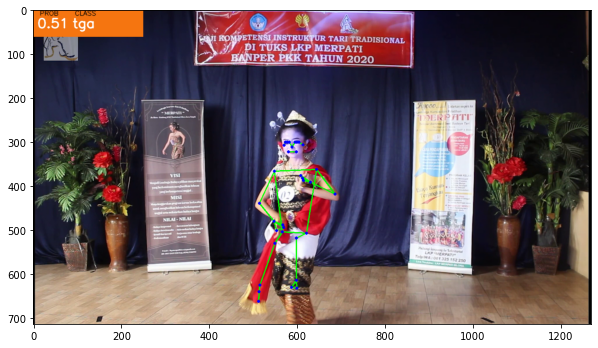

 18%|██████████████▏                                                              | 553/3000.0 [00:58<05:06,  7.99it/s]

tga [0.42 0.44 0.14]
tga [0.41 0.43 0.16]
tga [0.42 0.46 0.12]



 18%|██████████████▏                                                              | 555/3000.0 [00:58<04:36,  8.86it/s]

tga [0.41 0.47 0.12]
tga [0.4  0.49 0.11]
tga [0.43 0.47 0.1 ]


 19%|██████████████▎                                                              | 559/3000.0 [00:59<04:00, 10.14it/s]

tga [0.36 0.5  0.14]
tga [0.36 0.51 0.13]
tga [0.39 0.47 0.14]



 19%|██████████████▍                                                              | 561/3000.0 [00:59<03:50, 10.58it/s]

tga [0.35 0.51 0.14]
tga [0.35 0.52 0.13]
tga [0.36 0.5  0.14]


 19%|██████████████▌                                                              | 565/3000.0 [00:59<03:53, 10.42it/s]

tga [0.33 0.52 0.15]
tga [0.4  0.51 0.09]
tga 


 19%|██████████████▌                                                              | 567/3000.0 [00:59<03:56, 10.29it/s]

[0.32 0.62 0.06]
tga [0.31 0.61 0.08]
tga [0.31 0.63 0.06]



 19%|██████████████▌                                                              | 569/3000.0 [01:00<03:51, 10.51it/s]

tga [0.29 0.61 0.1 ]
tga [0.32 0.59 0.09]
tga [0.29 0.66 0.05]


 19%|██████████████▋                                                              | 573/3000.0 [01:00<03:49, 10.58it/s]

tga [0.34 0.6  0.06]
tga [0.33 0.61 0.06]
tga [0.31 0.6  0.09]



 19%|██████████████▊                                                              | 575/3000.0 [01:00<04:05,  9.89it/s]

tga [0.31 0.59 0.1 ]
tga [0.33 0.59 0.08]


 19%|██████████████▊                                                              | 578/3000.0 [01:01<04:33,  8.86it/s]

tga [0.34 0.54 0.12]
tga [0.39 0.52 0.09]
tga [0.38 0.51 0.11]



 19%|██████████████▉                                                              | 580/3000.0 [01:01<04:41,  8.60it/s]

tga [0.37 0.51 0.12]


 19%|██████████████▉                                                              | 582/3000.0 [01:01<05:35,  7.21it/s]

tga [0.34 0.54 0.12]
tga [0.34 0.53 0.13]


 19%|██████████████▉                                                              | 584/3000.0 [01:01<05:24,  7.44it/s]

tga [0.31 0.58 0.11]
tga [0.34 0.55 0.11]


 20%|███████████████                                                              | 586/3000.0 [01:02<04:52,  8.24it/s]

tga [0.34 0.53 0.13]
tga [0.33 0.56 0.11]
tga 


 20%|███████████████                                                              | 588/3000.0 [01:02<04:15,  9.46it/s]

[0.35 0.55 0.1 ]
tga [0.31 0.59 0.1 ]
tga [0.34 0.57 0.09]



 20%|███████████████▏                                                             | 590/3000.0 [01:02<04:01,  9.97it/s]

tga [0.32 0.59 0.09]
tga [0.33 0.58 0.09]


 20%|███████████████▏                                                             | 593/3000.0 [01:02<04:24,  9.10it/s]

tga [0.31 0.59 0.1 ]
tga [0.31 0.57 0.12]
tga [0.31 0.58 0.11]



 20%|███████████████▎                                                             | 595/3000.0 [01:03<04:09,  9.65it/s]

tga [0.32 0.57 0.11]
tga [0.37 0.51 0.12]
tga [0.36 0.53 0.11]


 20%|███████████████▍                                                             | 600/3000.0 [01:03<03:52, 10.30it/s]

tga [0.38 0.51 0.11]
tga [0.38 0.51 0.11]
tga [0.35 0.51 0.14]
tga [0.36 0.49 0.15]


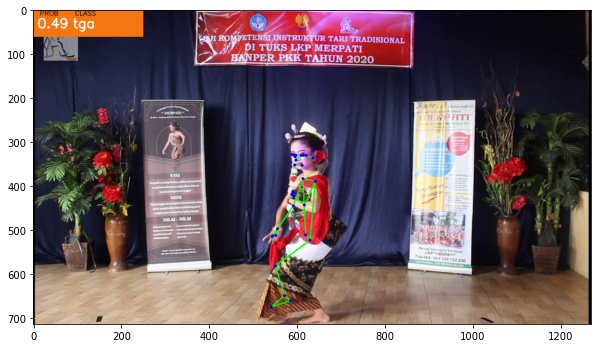

 20%|███████████████▍                                                             | 603/3000.0 [01:04<06:30,  6.14it/s]

tga [0.33 0.5  0.17]
tga [0.33 0.53 0.14]


 20%|███████████████▌                                                             | 605/3000.0 [01:04<05:42,  6.99it/s]

tga [0.35 0.57 0.08]
tga [0.39 0.55 0.06]


 20%|███████████████▌                                                             | 607/3000.0 [01:04<05:07,  7.79it/s]

tga [0.39 0.55 0.06]
tga [0.43 0.44 0.13]



 20%|███████████████▌                                                             | 608/3000.0 [01:04<04:49,  8.27it/s]

tga [0.39 0.49 0.12]
tga [0.41 0.43 0.16]
tga [0.35 0.45 0.2 ]


 20%|███████████████▋                                                             | 612/3000.0 [01:05<03:59,  9.98it/s]

tga [0.34 0.49 0.17]
tga [0.37 0.44 0.19]
tga [0.36 0.48 0.16]


 20%|███████████████▊                                                             | 615/3000.0 [01:05<04:14,  9.37it/s]

tga [0.39 0.47 0.14]
tga [0.38 0.45 0.17]


 21%|███████████████▊                                                             | 617/3000.0 [01:05<04:21,  9.10it/s]

tga [0.4  0.43 0.17]
tga [0.36 0.47 0.17]
tga [0.38 0.45 0.17]


 21%|███████████████▉                                                             | 620/3000.0 [01:06<04:07,  9.63it/s]

tga [0.42 0.44 0.14]
tga [0.42 0.45 0.13]


 21%|███████████████▉                                                             | 622/3000.0 [01:06<04:40,  8.46it/s]

tga [0.44 0.45 0.11]
tg [0.45 0.43 0.12]



 21%|███████████████▉                                                             | 623/3000.0 [01:06<04:30,  8.79it/s]

tga [0.43 0.46 0.11]
tga [0.4  0.48 0.12]
tga [0.38 0.5  0.12]


 21%|████████████████                                                             | 627/3000.0 [01:06<03:52, 10.18it/s]

tga [0.37 0.5  0.13]
tga [0.38 0.49 0.13]
tga [0.37 0.51 0.12]



 21%|████████████████▏                                                            | 629/3000.0 [01:06<03:45, 10.49it/s]

tga [0.38 0.51 0.11]
tga [0.36 0.51 0.13]
tga [0.34 0.51 0.15]


 21%|████████████████▏                                                            | 633/3000.0 [01:07<03:45, 10.50it/s]

tga [0.35 0.5  0.15]
tga [0.39 0.49 0.12]



 21%|████████████████▎                                                            | 635/3000.0 [01:07<03:55, 10.04it/s]

tga [0.39 0.48 0.13]
tga [0.38 0.48 0.14]
tga [0.34 0.5  0.16]



 21%|████████████████▎                                                            | 637/3000.0 [01:07<03:50, 10.23it/s]

tga [0.36 0.51 0.13]
tga [0.37 0.51 0.12]
tga [0.39 0.5  0.11]


 21%|████████████████▍                                                            | 641/3000.0 [01:08<03:38, 10.81it/s]

tga [0.39 0.5  0.11]
tga [0.4 0.5 0.1]
tga [0.39 0.5  0.11]


 22%|████████████████▌                                                            | 645/3000.0 [01:08<03:31, 11.12it/s]

tga [0.42 0.49 0.09]
tga [0.42 0.47 0.11]
tga [0.41 0.48 0.11]



 22%|████████████████▌                                                            | 647/3000.0 [01:08<03:33, 11.01it/s]

tga [0.35 0.52 0.13]
tga [0.38 0.5  0.12]
tga [0.43 0.49 0.08]



 22%|████████████████▋                                                            | 649/3000.0 [01:08<03:38, 10.77it/s]

tga [0.42 0.5  0.08]
tga [0.42 0.51 0.07]
tga [0.42 0.51 0.07]


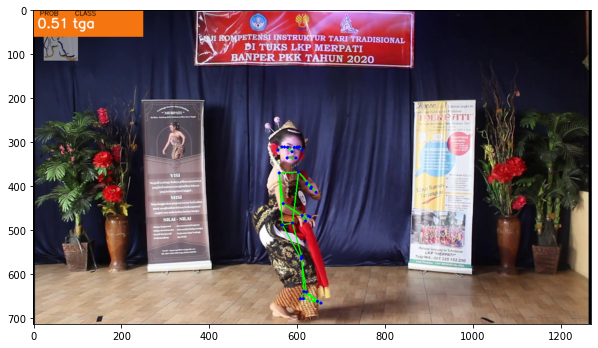

 22%|████████████████▊                                                            | 653/3000.0 [01:09<05:12,  7.52it/s]

tga [0.39 0.53 0.08]
tga [0.36 0.54 0.1 ]


 22%|████████████████▊                                                            | 655/3000.0 [01:09<05:09,  7.57it/s]

tga [0.41 0.5  0.09]
tga [0.4  0.52 0.08]



 22%|████████████████▊                                                            | 656/3000.0 [01:09<04:55,  7.93it/s]

tga [0.4  0.53 0.07]
tga [0.39 0.53 0.08]
tga [0.35 0.57 0.08]


 22%|████████████████▉                                                            | 659/3000.0 [01:10<04:20,  8.98it/s]

tga [0.39 0.52 0.09]
tga [0.39 0.51 0.1 ]
tga [0.38 0.52 0.1 ]


 22%|█████████████████                                                            | 663/3000.0 [01:10<04:08,  9.41it/s]

tga [0.38 0.5  0.12]
tga [0.37 0.49 0.14]


 22%|█████████████████                                                            | 666/3000.0 [01:10<03:56,  9.85it/s]

tga [0.36 0.53 0.11]
tga [0.41 0.47 0.12]
tga [0.42 0.46 0.12]



 22%|█████████████████▏                                                           | 668/3000.0 [01:11<03:49, 10.18it/s]

tga [0.42 0.48 0.1 ]
tga [0.42 0.46 0.12]
tga [0.4  0.47 0.13]



 22%|█████████████████▏                                                           | 670/3000.0 [01:11<03:42, 10.45it/s]

tga [0.41 0.5  0.09]
tga [0.41 0.43 0.16]


 22%|█████████████████▎                                                           | 673/3000.0 [01:11<04:22,  8.86it/s]

tga [0.42 0.46 0.12]
tg [0.46 0.46 0.08]



 22%|█████████████████▎                                                           | 675/3000.0 [01:11<04:08,  9.35it/s]

tga [0.44 0.45 0.11]
tga [0.36 0.47 0.17]
tg [0.45 0.44 0.11]



 23%|█████████████████▍                                                           | 677/3000.0 [01:12<04:03,  9.52it/s]

tga [0.42 0.43 0.15]
tga [0.37 0.48 0.15]
tga [0.38 0.48 0.14]


 23%|█████████████████▍                                                           | 681/3000.0 [01:12<03:53,  9.92it/s]

tga [0.38 0.48 0.14]
tga [0.34 0.48 0.18]



 23%|█████████████████▌                                                           | 683/3000.0 [01:12<03:46, 10.23it/s]

tga [0.4  0.46 0.14]
tga [0.36 0.5  0.14]
tga [0.39 0.43 0.18]


 23%|█████████████████▋                                                           | 687/3000.0 [01:13<03:34, 10.79it/s]

tga [0.34 0.44 0.22]
tg [0.42 0.42 0.16]
tg [0.4  0.39 0.21]



 23%|█████████████████▋                                                           | 689/3000.0 [01:13<03:30, 10.99it/s]

tga [0.4  0.42 0.18]
tga [0.42 0.43 0.15]
tg [0.44 0.37 0.19]



 23%|█████████████████▋                                                           | 691/3000.0 [01:13<03:53,  9.88it/s]

tg [0.43 0.43 0.14]
tga [0.38 0.55 0.07]
tga [0.39 0.53 0.08]


 23%|█████████████████▊                                                           | 695/3000.0 [01:13<03:40, 10.44it/s]

tga [0.42 0.51 0.07]
tga [0.41 0.48 0.11]
tga [0.35 0.48 0.17]



 23%|█████████████████▉                                                           | 697/3000.0 [01:14<03:40, 10.43it/s]

tga [0.37 0.47 0.16]
tga [0.35 0.49 0.16]
tga [0.33 0.51 0.16]



 23%|█████████████████▉                                                           | 699/3000.0 [01:14<03:36, 10.64it/s]

tga [0.32 0.53 0.15]
tga [0.31 0.56 0.13]


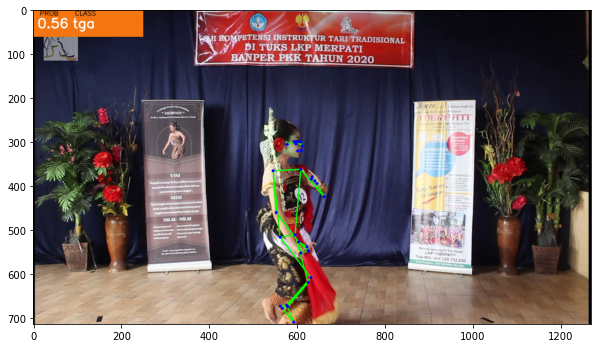

 23%|██████████████████                                                           | 702/3000.0 [01:14<05:38,  6.79it/s]

tga [0.29 0.57 0.14]
tga [0.3  0.55 0.15]


 24%|██████████████████                                                           | 705/3000.0 [01:15<05:00,  7.65it/s]

tga [0.3  0.57 0.13]
tga [0.32 0.57 0.11]
tga


 24%|██████████████████▏                                                          | 707/3000.0 [01:15<04:30,  8.48it/s]

 [0.31 0.59 0.1 ]
tga [0.31 0.59 0.1 ]
tga [0.32 0.59 0.09]



 24%|██████████████████▏                                                          | 709/3000.0 [01:15<04:08,  9.24it/s]

tga [0.33 0.6  0.07]
tga [0.32 0.56 0.12]
tga [0.3  0.58 0.12]


 24%|██████████████████▎                                                          | 713/3000.0 [01:15<03:41, 10.35it/s]

tga [0.31 0.59 0.1 ]
tga [0.37 0.51 0.12]
tga [0.34 0.55 0.11]



 24%|██████████████████▎                                                          | 715/3000.0 [01:16<03:34, 10.66it/s]

tga [0.37 0.56 0.07]
tga [0.38 0.55 0.07]
tga [0.36 0.54 0.1 ]


 24%|██████████████████▍                                                          | 719/3000.0 [01:16<03:27, 10.98it/s]

tga [0.38 0.53 0.09]
tga [0.35 0.57 0.08]
tga [0.36 0.54 0.1 ]



 24%|██████████████████▌                                                          | 721/3000.0 [01:16<03:23, 11.18it/s]

tga [0.35 0.52 0.13]
tga [0.31 0.56 0.13]
tga [0.33 0.56 0.11]


 24%|██████████████████▌                                                          | 725/3000.0 [01:17<03:17, 11.52it/s]

tga [0.36 0.57 0.07]
tga [0.32 0.6  0.08]


 25%|██████████████████▉                                                          | 739/3000.0 [01:18<03:35, 10.50it/s]

tga [0.23 0.65 0.12]
tga [0.23 0.7  0.07]


 25%|███████████████████▏                                                         | 747/3000.0 [01:18<04:01,  9.33it/s]

tga [0.23 0.55 0.22]
tga [0.25 0.58 0.17]
tga [0.34 0.43 0.23]



 25%|███████████████████▏                                                         | 749/3000.0 [01:19<03:47,  9.90it/s]

tga [0.37 0.44 0.19]
tga [0.3  0.48 0.22]


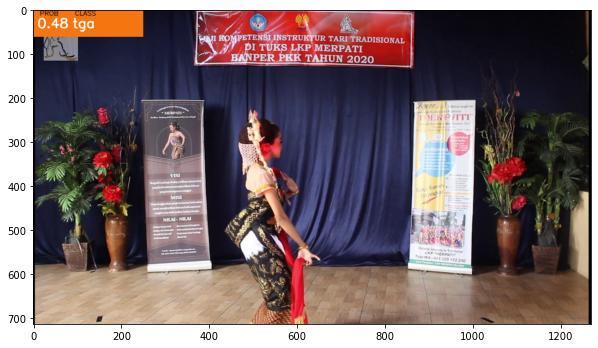

 25%|███████████████████▎                                                         | 754/3000.0 [01:20<05:14,  7.15it/s]

tga [0.32 0.54 0.14]
tga [0.26 0.62 0.12]
tga 


 25%|███████████████████▍                                                         | 755/3000.0 [01:20<05:00,  7.48it/s]

[0.32 0.55 0.13]
tga [0.3 0.6 0.1]
tga [0.32 0.62 0.06]


 25%|███████████████████▍                                                         | 758/3000.0 [01:20<04:22,  8.55it/s]

tga [0.3  0.58 0.12]
tga [0.38 0.41 0.21]


 25%|███████████████████▌                                                         | 762/3000.0 [01:20<03:57,  9.43it/s]

tga [0.28 0.58 0.14]
tga [0.34 0.51 0.15]
tga [0.36 0.51 0.13]



 25%|███████████████████▌                                                         | 764/3000.0 [01:21<03:45,  9.91it/s]

tga [0.25 0.58 0.17]
tga [0.28 0.57 0.15]
tga [0.25 0.67 0.08]


 26%|███████████████████▋                                                         | 768/3000.0 [01:21<03:35, 10.34it/s]

tga [0.37 0.53 0.1 ]
tga [0.28 0.63 0.09]
tga [0.41 0.47 0.12]



 26%|███████████████████▊                                                         | 770/3000.0 [01:21<03:34, 10.42it/s]

tga [0.37 0.48 0.15]
tga [0.39 0.49 0.12]
tga [0.33 0.6  0.07]


 26%|███████████████████▊                                                         | 774/3000.0 [01:22<03:26, 10.79it/s]

tga [0.38 0.51 0.11]
tga [0.37 0.53 0.1 ]
tga [0.36 0.53 0.11]



 26%|███████████████████▉                                                         | 776/3000.0 [01:22<03:23, 10.92it/s]

tga [0.34 0.55 0.11]
tga [0.35 0.55 0.1 ]



 26%|███████████████████▉                                                         | 778/3000.0 [01:22<03:39, 10.12it/s]

tga [0.35 0.58 0.07]
tga [0.31 0.59 0.1 ]
tga [0.37 0.53 0.1 ]


 26%|████████████████████                                                         | 782/3000.0 [01:22<03:46,  9.80it/s]

tga [0.37 0.57 0.06]
tga [0.32 0.59 0.09]


 26%|████████████████████                                                         | 784/3000.0 [01:23<03:55,  9.41it/s]

tga [0.31 0.63 0.06]
tga [0.24 0.61 0.15]



 26%|████████████████████▏                                                        | 785/3000.0 [01:23<04:59,  7.40it/s]

tga [0.28 0.58 0.14]



 26%|████████████████████▏                                                        | 786/3000.0 [01:23<06:03,  6.09it/s]

tga [0.31 0.54 0.15]
tga [0.3  0.58 0.12]


 26%|████████████████████▏                                                        | 788/3000.0 [01:23<06:38,  5.55it/s]

tga [0.31 0.55 0.14]



 26%|████████████████████▎                                                        | 789/3000.0 [01:24<07:07,  5.17it/s]

tga [0.28 0.6  0.12]



 26%|████████████████████▎                                                        | 790/3000.0 [01:24<07:54,  4.66it/s]

tga [0.32 0.56 0.12]


 26%|████████████████████▎                                                        | 792/3000.0 [01:24<07:24,  4.97it/s]

tga [0.29 0.61 0.1 ]
tga [0.32 0.57 0.11]


 26%|████████████████████▍                                                        | 794/3000.0 [01:25<06:54,  5.32it/s]

tga [0.29 0.57 0.14]
tga [0.32 0.58 0.1 ]



 26%|████████████████████▍                                                        | 795/3000.0 [01:25<07:22,  4.99it/s]

tga [0.3  0.56 0.14]


 27%|████████████████████▍                                                        | 797/3000.0 [01:25<06:41,  5.49it/s]

tga [0.34 0.59 0.07]
tga [0.31 0.62 0.07]


 27%|████████████████████▌                                                        | 799/3000.0 [01:26<05:59,  6.12it/s]

tga [0.43 0.5  0.07]
tga [0.35 0.56 0.09]



 27%|████████████████████▌                                                        | 800/3000.0 [01:26<05:29,  6.69it/s]

tga [0.35 0.56 0.09]
tga [0.35 0.57 0.08]


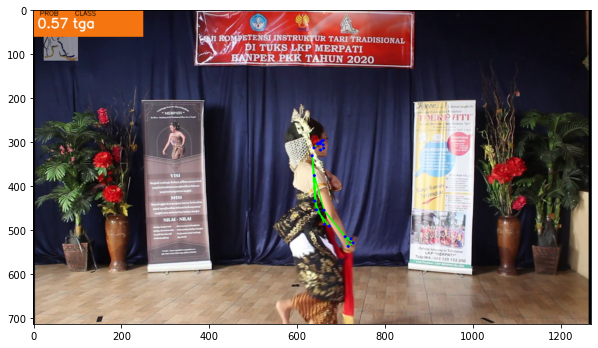

 27%|████████████████████▌                                                        | 802/3000.0 [01:27<10:05,  3.63it/s]

tga [0.26 0.6  0.14]


 27%|████████████████████▋                                                        | 807/3000.0 [01:27<05:45,  6.35it/s]

tga [0.31 0.56 0.13]
tga [0.31 0.56 0.13]


 27%|████████████████████▊                                                        | 810/3000.0 [01:28<05:16,  6.92it/s]

tga [0.3  0.59 0.11]
tga [0.31 0.58 0.11]


 27%|████████████████████▊                                                        | 812/3000.0 [01:28<05:41,  6.41it/s]

tga [0.31 0.59 0.1 ]
tga [0.3  0.59 0.11]


 27%|████████████████████▉                                                        | 814/3000.0 [01:28<05:51,  6.21it/s]

tga [0.31 0.58 0.11]
tga [0.32 0.64 0.04]



 27%|████████████████████▉                                                        | 815/3000.0 [01:28<06:15,  5.82it/s]

tga [0.33 0.63 0.04]
tga


 27%|████████████████████▉                                                        | 816/3000.0 [01:29<06:28,  5.62it/s]

 [0.3  0.66 0.04]
tga [0.31 0.61 0.08]


 27%|████████████████████▉                                                        | 818/3000.0 [01:29<08:04,  4.50it/s]

tga [0.33 0.59 0.08]



 27%|█████████████████████                                                        | 819/3000.0 [01:29<08:13,  4.42it/s]

tga [0.31 0.63 0.06]
tga [0.33 0.57 0.1 ]


 27%|█████████████████████                                                        | 821/3000.0 [01:30<07:22,  4.92it/s]

tga [0.34 0.57 0.09]



 27%|█████████████████████                                                        | 822/3000.0 [01:30<08:00,  4.54it/s]

tga [0.31 0.59 0.1 ]



 27%|█████████████████████                                                        | 823/3000.0 [01:30<08:21,  4.34it/s]

tga [0.3  0.58 0.12]



 27%|█████████████████████▏                                                       | 824/3000.0 [01:30<08:22,  4.33it/s]

tga [0.31 0.59 0.1 ]



 28%|█████████████████████▏                                                       | 825/3000.0 [01:31<08:15,  4.39it/s]

tga [0.32 0.56 0.12]



 28%|█████████████████████▏                                                       | 826/3000.0 [01:31<08:11,  4.42it/s]

tga [0.31 0.54 0.15]



 28%|█████████████████████▏                                                       | 827/3000.0 [01:31<08:23,  4.32it/s]

tga [0.33 0.54 0.13]



 28%|█████████████████████▎                                                       | 828/3000.0 [01:31<08:12,  4.41it/s]

tga [0.3  0.56 0.14]



 28%|█████████████████████▎                                                       | 829/3000.0 [01:32<08:31,  4.25it/s]

tga [0.35 0.55 0.1 ]



 28%|█████████████████████▎                                                       | 830/3000.0 [01:32<09:29,  3.81it/s]

tga [0.29 0.63 0.08]



 28%|█████████████████████▎                                                       | 831/3000.0 [01:32<09:44,  3.71it/s]

tga [0.31 0.57 0.12]



 28%|█████████████████████▎                                                       | 832/3000.0 [01:32<09:21,  3.86it/s]

tga [0.3  0.58 0.12]



 28%|█████████████████████▍                                                       | 833/3000.0 [01:33<09:05,  3.97it/s]

tga [0.31 0.59 0.1 ]



 28%|█████████████████████▍                                                       | 834/3000.0 [01:33<08:57,  4.03it/s]

tga [0.31 0.6  0.09]



 28%|█████████████████████▍                                                       | 835/3000.0 [01:33<08:43,  4.14it/s]

tga [0.32 0.56 0.12]


 28%|█████████████████████▍                                                       | 837/3000.0 [01:34<07:25,  4.85it/s]

tga [0.31 0.57 0.12]
tga [0.32 0.56 0.12]



 28%|█████████████████████▌                                                       | 838/3000.0 [01:34<07:00,  5.15it/s]

tga [0.33 0.54 0.13]


 28%|█████████████████████▌                                                       | 840/3000.0 [01:34<06:42,  5.36it/s]

tga [0.33 0.54 0.13]
tga [0.33 0.55 0.12]



 28%|█████████████████████▌                                                       | 841/3000.0 [01:34<06:18,  5.70it/s]

tga [0.32 0.55 0.13]
tga 

 28%|█████████████████████▋                                                       | 843/3000.0 [01:35<06:12,  5.79it/s]

[0.32 0.56 0.12]
tga [0.32 0.55 0.13]


 28%|█████████████████████▋                                                       | 845/3000.0 [01:35<05:29,  6.53it/s]

tga [0.34 0.52 0.14]
tga [0.33 0.54 0.13]


 28%|█████████████████████▋                                                       | 847/3000.0 [01:35<04:57,  7.25it/s]

tga [0.34 0.53 0.13]
tga [0.33 0.56 0.11]



 28%|█████████████████████▊                                                       | 848/3000.0 [01:35<04:36,  7.77it/s]

tga [0.34 0.54 0.12]
tga [0.32 0.55 0.13]
tga 


 28%|█████████████████████▊                                                       | 850/3000.0 [01:35<04:08,  8.64it/s]

[0.32 0.55 0.13]
tga [0.34 0.54 0.12]


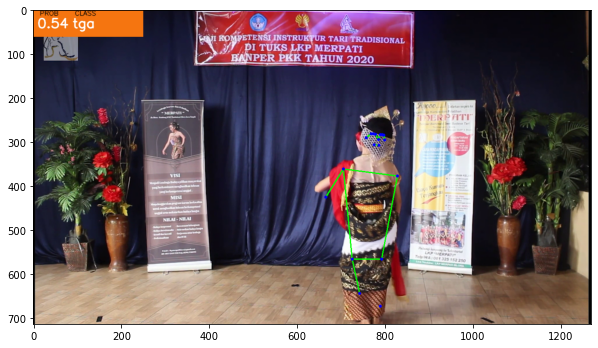

 28%|█████████████████████▉                                                       | 853/3000.0 [01:36<06:43,  5.31it/s]

tga [0.35 0.52 0.13]
tga [0.32 0.55 0.13]



 28%|█████████████████████▉                                                       | 854/3000.0 [01:36<06:18,  5.67it/s]

tga [0.33 0.55 0.12]
tga [0.33 0.57 0.1 ]


 29%|█████████████████████▉                                                       | 856/3000.0 [01:37<06:39,  5.36it/s]

tga [0.29 0.6  0.11]
tga [0.26 0.64 0.1 ]


 29%|██████████████████████                                                       | 859/3000.0 [01:37<05:35,  6.39it/s]

tga [0.27 0.66 0.07]
tga [0.29 0.63 0.08]



 29%|██████████████████████                                                       | 861/3000.0 [01:37<04:40,  7.63it/s]

tga [0.32 0.6  0.08]
tga [0.32 0.59 0.09]



 29%|██████████████████████                                                       | 862/3000.0 [01:38<04:33,  7.82it/s]

tga [0.29 0.61 0.1 ]



 29%|██████████████████████▏                                                      | 863/3000.0 [01:38<07:30,  4.74it/s]

tga [0.3 0.6 0.1]



 29%|██████████████████████▏                                                      | 864/3000.0 [01:38<07:47,  4.57it/s]

tga [0.33 0.58 0.09]



 29%|██████████████████████▏                                                      | 865/3000.0 [01:38<07:48,  4.56it/s]

tga [0.32 0.59 0.09]
tga [0.32 0.6  0.08]


 29%|██████████████████████▎                                                      | 868/3000.0 [01:39<05:51,  6.06it/s]

tga [0.33 0.59 0.08]
tga [0.33 0.58 0.09]


 29%|██████████████████████▎                                                      | 870/3000.0 [01:39<05:27,  6.51it/s]

tga [0.32 0.59 0.09]
tga [0.31 0.58 0.11]



 29%|██████████████████████▎                                                      | 871/3000.0 [01:39<05:07,  6.93it/s]

tga [0.32 0.59 0.09]
tga [0.33 0.58 0.09]


 29%|██████████████████████▍                                                      | 873/3000.0 [01:40<06:49,  5.20it/s]

tga [0.33 0.59 0.08]


 29%|██████████████████████▍                                                      | 875/3000.0 [01:40<06:52,  5.16it/s]

tga [0.33 0.57 0.1 ]
tga [0.33 0.55 0.12]


 29%|██████████████████████▌                                                      | 877/3000.0 [01:40<05:40,  6.24it/s]

tga [0.34 0.53 0.13]
tga [0.3  0.58 0.12]


 29%|██████████████████████▌                                                      | 879/3000.0 [01:41<05:06,  6.91it/s]

tga [0.3  0.59 0.11]
tga [0.3  0.57 0.13]


 29%|██████████████████████▌                                                      | 881/3000.0 [01:41<04:49,  7.32it/s]

tga [0.34 0.53 0.13]
tga [0.35 0.52 0.13]


 29%|██████████████████████▋                                                      | 883/3000.0 [01:41<04:41,  7.53it/s]

tga [0.34 0.53 0.13]
tga [0.32 0.55 0.13]


 30%|██████████████████████▋                                                      | 885/3000.0 [01:41<04:29,  7.84it/s]

tga [0.29 0.59 0.12]
tga [0.3  0.59 0.11]


 30%|██████████████████████▊                                                      | 887/3000.0 [01:42<04:13,  8.35it/s]

tga [0.32 0.55 0.13]
tga [0.32 0.57 0.11]


 30%|██████████████████████▊                                                      | 889/3000.0 [01:42<04:14,  8.28it/s]

tga [0.31 0.59 0.1 ]
tga [0.33 0.57 0.1 ]


 30%|██████████████████████▊                                                      | 891/3000.0 [01:42<04:09,  8.47it/s]

tga [0.33 0.55 0.12]
tga [0.29 0.59 0.12]


 30%|██████████████████████▉                                                      | 893/3000.0 [01:42<04:05,  8.58it/s]

tga [0.32 0.59 0.09]
tga [0.33 0.57 0.1 ]



 30%|██████████████████████▉                                                      | 895/3000.0 [01:43<03:42,  9.47it/s]

tga [0.35 0.52 0.13]
tga [0.31 0.6  0.09]
tga [0.33 0.56 0.11]


 30%|███████████████████████                                                      | 898/3000.0 [01:43<03:51,  9.10it/s]

tga [0.32 0.58 0.1 ]
tga [0.3  0.56 0.14]



 30%|███████████████████████                                                      | 900/3000.0 [01:43<03:40,  9.52it/s]

tga [0.3  0.56 0.14]
tga [0.31 0.56 0.13]
tga [0.33 0.58 0.09]


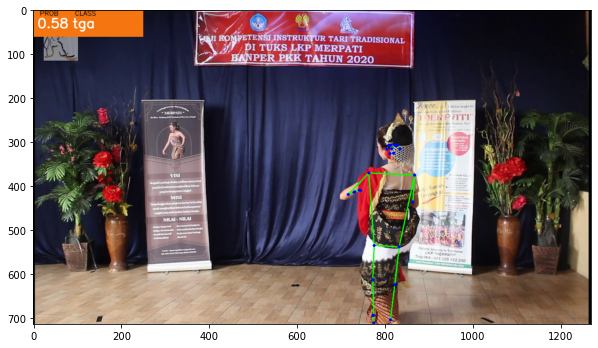

 30%|███████████████████████▏                                                     | 903/3000.0 [01:44<05:50,  5.98it/s]

tga [0.32 0.59 0.09]
tga [0.32 0.59 0.09]


 30%|███████████████████████▏                                                     | 905/3000.0 [01:44<04:53,  7.13it/s]

tga [0.31 0.6  0.09]
tga [0.3 0.6 0.1]


 30%|███████████████████████▎                                                     | 907/3000.0 [01:44<04:46,  7.30it/s]

tga [0.35 0.55 0.1 ]
tga [0.33 0.58 0.09]


 30%|███████████████████████▎                                                     | 909/3000.0 [01:45<04:28,  7.78it/s]

tga [0.33 0.56 0.11]
tga [0.33 0.58 0.09]


 30%|███████████████████████▍                                                     | 911/3000.0 [01:45<04:13,  8.24it/s]

tga [0.31 0.59 0.1 ]
tga [0.34 0.54 0.12]


 30%|███████████████████████▍                                                     | 913/3000.0 [01:45<04:10,  8.34it/s]

tga [0.32 0.58 0.1 ]
tga [0.33 0.58 0.09]


 30%|███████████████████████▍                                                     | 915/3000.0 [01:45<03:56,  8.81it/s]

tga [0.33 0.58 0.09]
tga [0.33 0.55 0.12]



 31%|███████████████████████▌                                                     | 916/3000.0 [01:45<03:49,  9.09it/s]

tga [0.3  0.59 0.11]
tga [0.3  0.59 0.11]
tga [0.31 0.57 0.12]


 31%|███████████████████████▌                                                     | 920/3000.0 [01:46<03:29,  9.94it/s]

tga [0.32 0.55 0.13]
tga [0.32 0.56 0.12]



 31%|███████████████████████▋                                                     | 922/3000.0 [01:46<03:26, 10.07it/s]

tga [0.35 0.55 0.1 ]
tga [0.34 0.56 0.1 ]
tga [0.33 0.56 0.11]



 31%|███████████████████████▋                                                     | 924/3000.0 [01:46<03:19, 10.39it/s]

tga [0.34 0.55 0.11]
tga [0.32 0.56 0.12]
tga 


 31%|███████████████████████▊                                                     | 926/3000.0 [01:46<03:16, 10.56it/s]

[0.32 0.58 0.1 ]
tga [0.3  0.58 0.12]
tga [0.32 0.59 0.09]


 31%|███████████████████████▊                                                     | 930/3000.0 [01:47<03:25, 10.07it/s]

tga [0.31 0.63 0.06]
tga [0.32 0.62 0.06]



 31%|███████████████████████▉                                                     | 932/3000.0 [01:47<03:34,  9.64it/s]

tga [0.31 0.59 0.1 ]
tga [0.33 0.58 0.09]


 31%|███████████████████████▉                                                     | 934/3000.0 [01:47<03:37,  9.49it/s]

tga [0.33 0.57 0.1 ]
tga [0.33 0.58 0.09]


 31%|████████████████████████                                                     | 936/3000.0 [01:47<03:41,  9.32it/s]

tga [0.33 0.59 0.08]
tga [0.3  0.63 0.07]


 31%|████████████████████████                                                     | 938/3000.0 [01:48<03:45,  9.16it/s]

tga [0.31 0.62 0.07]
tga [0.31 0.63 0.06]


 31%|████████████████████████▏                                                    | 940/3000.0 [01:48<03:51,  8.89it/s]

tga [0.31 0.61 0.08]
tga [0.32 0.6  0.08]


 31%|████████████████████████▏                                                    | 942/3000.0 [01:48<03:45,  9.13it/s]

tga [0.33 0.6  0.07]
tga [0.32 0.61 0.07]


 31%|████████████████████████▏                                                    | 944/3000.0 [01:48<04:10,  8.20it/s]

tga [0.31 0.62 0.07]
tga [0.33 0.59 0.08]


 32%|████████████████████████▎                                                    | 946/3000.0 [01:49<04:05,  8.35it/s]

tga [0.3  0.61 0.09]
tga [0.29 0.61 0.1 ]


 32%|████████████████████████▎                                                    | 948/3000.0 [01:49<04:17,  7.97it/s]

tga [0.33 0.59 0.08]
tga [0.32 0.62 0.06]


 32%|████████████████████████▍                                                    | 950/3000.0 [01:49<04:18,  7.93it/s]

tga [0.32 0.61 0.07]
tga [0.3  0.63 0.07]
tga [0.3  0.63 0.07]


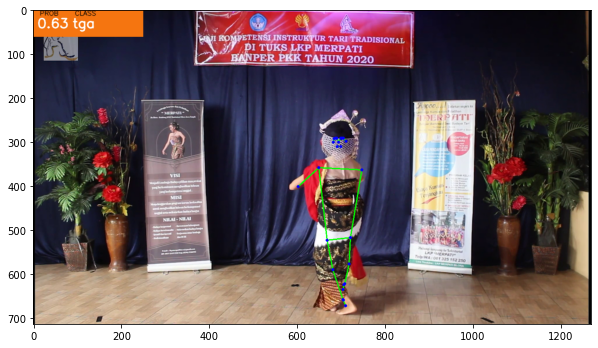

 32%|████████████████████████▍                                                    | 952/3000.0 [01:50<11:56,  2.86it/s]

tga [0.31 0.61 0.08]



 32%|████████████████████████▍                                                    | 953/3000.0 [01:51<11:22,  3.00it/s]

tga [0.31 0.62 0.07]



 32%|████████████████████████▍                                                    | 954/3000.0 [01:51<10:28,  3.26it/s]

tga [0.32 0.61 0.07]



 32%|████████████████████████▌                                                    | 955/3000.0 [01:51<09:59,  3.41it/s]

tga [0.31 0.62 0.07]


 32%|████████████████████████▌                                                    | 957/3000.0 [01:51<07:41,  4.43it/s]

tga [0.34 0.57 0.09]
tga [0.3  0.62 0.08]


 32%|████████████████████████▌                                                    | 959/3000.0 [01:52<05:54,  5.76it/s]

tga [0.3  0.64 0.06]
tga [0.29 0.65 0.06]



 32%|████████████████████████▋                                                    | 960/3000.0 [01:52<05:41,  5.98it/s]

tga [0.35 0.55 0.1 ]


 32%|████████████████████████▋                                                    | 962/3000.0 [01:52<06:18,  5.38it/s]

tga [0.34 0.59 0.07]
tga [0.33 0.61 0.06]


 32%|████████████████████████▋                                                    | 964/3000.0 [01:53<05:26,  6.24it/s]

tga [0.32 0.62 0.06]
tga [0.33 0.58 0.09]


 32%|████████████████████████▊                                                    | 966/3000.0 [01:53<04:44,  7.15it/s]

tga [0.36 0.54 0.1 ]
tga [0.38 0.47 0.15]
tga [0.32 0.61 0.07]


 32%|████████████████████████▊                                                    | 969/3000.0 [01:53<04:01,  8.40it/s]

tga [0.34 0.58 0.08]
tga [0.37 0.57 0.06]



 32%|████████████████████████▉                                                    | 970/3000.0 [01:53<03:57,  8.56it/s]

tga [0.38 0.52 0.1 ]
tga [0.38 0.53 0.09]
tga [0.34 0.55 0.11]


 32%|████████████████████████▉                                                    | 974/3000.0 [01:54<03:26,  9.81it/s]

tga [0.36 0.52 0.12]
tga [0.31 0.6  0.09]
tga [0.31 0.59 0.1 ]



 33%|█████████████████████████                                                    | 976/3000.0 [01:54<03:16, 10.28it/s]

tga [0.35 0.54 0.11]
tga [0.3  0.57 0.13]
tga [0.34 0.57 0.09]


 33%|█████████████████████████▏                                                   | 980/3000.0 [01:54<03:15, 10.31it/s]

tga [0.33 0.57 0.1 ]
tga [0.31 0.59 0.1 ]
tga [0.36 0.56 0.08]



 33%|█████████████████████████▏                                                   | 982/3000.0 [01:54<03:11, 10.51it/s]

tga [0.36 0.54 0.1 ]
tga [0.35 0.56 0.09]
tga [0.41 0.5  0.09]


 33%|█████████████████████████▎                                                   | 986/3000.0 [01:55<03:10, 10.58it/s]

tga [0.37 0.54 0.09]
tga [0.36 0.54 0.1 ]
tga


 33%|█████████████████████████▎                                                   | 988/3000.0 [01:55<03:09, 10.60it/s]

 [0.37 0.54 0.09]
tga [0.31 0.61 0.08]
tga [0.34 0.57 0.09]



 33%|█████████████████████████▍                                                   | 990/3000.0 [01:55<03:08, 10.66it/s]

tga [0.34 0.57 0.09]
tga [0.34 0.57 0.09]
tga [0.34 0.55 0.11]


 33%|█████████████████████████▌                                                   | 994/3000.0 [01:56<03:10, 10.54it/s]

tga [0.34 0.52 0.14]
tga [0.36 0.49 0.15]
tga [0.37 0.49 0.14]



 33%|█████████████████████████▌                                                   | 996/3000.0 [01:56<03:14, 10.30it/s]

tga [0.36 0.49 0.15]
tga [0.34 0.53 0.13]


 33%|█████████████████████████▋                                                   | 999/3000.0 [01:56<03:25,  9.75it/s]

tga [0.36 0.51 0.13]
tga [0.36 0.53 0.11]
tga [0.38 0.51 0.11]
tga [0.36 0.51 0.13]


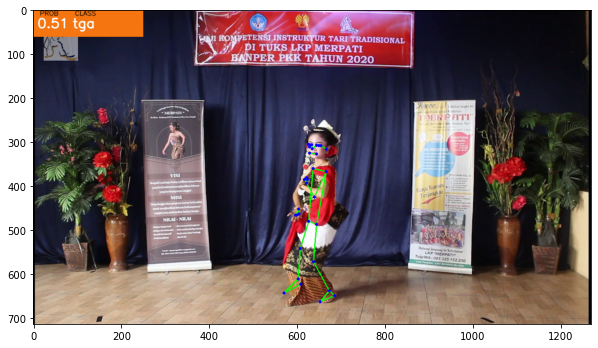

 33%|█████████████████████████▍                                                  | 1003/3000.0 [01:57<04:55,  6.75it/s]

tga [0.34 0.53 0.13]
tga [0.34 0.54 0.12]
tga [0.35 0.52 0.13]


 34%|█████████████████████████▍                                                  | 1006/3000.0 [01:57<04:08,  8.01it/s]

tga [0.35 0.54 0.11]
tga [0.37 0.5  0.13]
tga 


 34%|█████████████████████████▌                                                  | 1008/3000.0 [01:57<03:43,  8.93it/s]

[0.38 0.49 0.13]
tga [0.4  0.48 0.12]
tga 


 34%|█████████████████████████▌                                                  | 1009/3000.0 [01:57<03:38,  9.12it/s]

[0.35 0.56 0.09]
tga [0.34 0.56 0.1 ]
tga [0.34 0.55 0.11]


 34%|█████████████████████████▋                                                  | 1013/3000.0 [01:58<03:36,  9.17it/s]

tga [0.33 0.55 0.12]
tga [0.32 0.56 0.12]


 34%|█████████████████████████▋                                                  | 1015/3000.0 [01:58<03:36,  9.17it/s]

tga [0.28 0.59 0.13]
tga [0.31 0.59 0.1 ]
tga [0.31 0.6  0.09]


 34%|█████████████████████████▊                                                  | 1018/3000.0 [01:58<03:28,  9.52it/s]

tga [0.33 0.59 0.08]
tga [0.31 0.61 0.08]
tga [0.31 0.61 0.08]


 34%|█████████████████████████▊                                                  | 1021/3000.0 [01:59<03:32,  9.31it/s]

tga [0.29 0.62 0.09]
tga [0.3 0.6 0.1]


 34%|█████████████████████████▉                                                  | 1023/3000.0 [01:59<03:30,  9.38it/s]

tga [0.32 0.58 0.1 ]
tga [0.31 0.6  0.09]
tga [0.29 0.61 0.1 ]



 34%|█████████████████████████▉                                                  | 1025/3000.0 [01:59<03:20,  9.86it/s]

tga [0.29 0.61 0.1 ]
tga [0.27 0.64 0.09]
tga [0.35 0.59 0.06]


 34%|██████████████████████████                                                  | 1029/3000.0 [02:00<03:11, 10.27it/s]

tga [0.35 0.5  0.15]
tga [0.3  0.67 0.03]
tga [0.29 0.58 0.13]



 34%|██████████████████████████                                                  | 1031/3000.0 [02:00<03:05, 10.62it/s]

tga [0.31 0.61 0.08]
tga [0.32 0.64 0.04]
tga [0.33 0.61 0.06]


 34%|██████████████████████████▏                                                 | 1035/3000.0 [02:00<03:11, 10.27it/s]

tga [0.37 0.56 0.07]
tga [0.35 0.57 0.08]



 35%|██████████████████████████▎                                                 | 1037/3000.0 [02:00<03:20,  9.81it/s]

tga [0.3  0.63 0.07]
tga [0.38 0.54 0.08]
tga [0.3  0.63 0.07]



 35%|██████████████████████████▎                                                 | 1039/3000.0 [02:01<03:16, 10.00it/s]

tga [0.33 0.58 0.09]
tga [0.32 0.6  0.08]
tga [0.27 0.65 0.08]


 35%|██████████████████████████▍                                                 | 1043/3000.0 [02:01<03:18,  9.84it/s]

tga [0.3 0.6 0.1]
tga [0.3  0.62 0.08]


 35%|██████████████████████████▍                                                 | 1045/3000.0 [02:01<03:24,  9.55it/s]

tga [0.31 0.59 0.1 ]
tga [0.3 0.6 0.1]



 35%|██████████████████████████▍                                                 | 1046/3000.0 [02:01<03:24,  9.56it/s]

tga [0.3  0.58 0.12]
tga [0.3  0.58 0.12]
tga [0.32 0.57 0.11]


 35%|██████████████████████████▌                                                 | 1050/3000.0 [02:02<03:19,  9.76it/s]

tga [0.33 0.56 0.11]
tga [0.34 0.55 0.11]
tga [0.36 0.55 0.09]


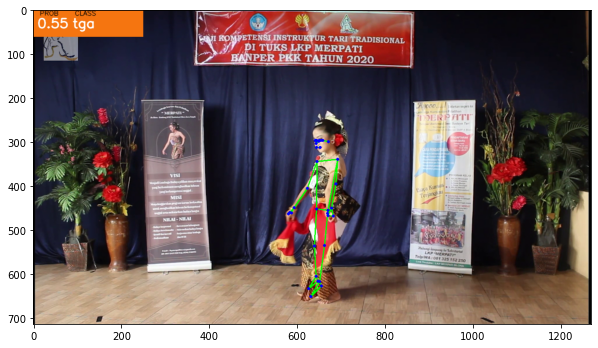

 35%|██████████████████████████▋                                                 | 1053/3000.0 [02:02<05:16,  6.14it/s]

tga [0.34 0.54 0.12]
tga [0.35 0.52 0.13]
tga [0.32 0.59 0.09]


 35%|██████████████████████████▊                                                 | 1056/3000.0 [02:03<04:20,  7.46it/s]

tga [0.39 0.48 0.13]
tga [0.41 0.47 0.12]


 35%|██████████████████████████▊                                                 | 1058/3000.0 [02:03<04:00,  8.07it/s]

tga [0.34 0.56 0.1 ]
tga [0.38 0.48 0.14]


 35%|██████████████████████████▊                                                 | 1060/3000.0 [02:03<03:51,  8.39it/s]

tga [0.35 0.55 0.1 ]
tga [0.33 0.57 0.1 ]



 35%|██████████████████████████▉                                                 | 1061/3000.0 [02:03<03:43,  8.66it/s]

tga [0.32 0.59 0.09]
tga [0.33 0.58 0.09]


 35%|██████████████████████████▉                                                 | 1064/3000.0 [02:04<03:46,  8.56it/s]

tga [0.4  0.54 0.06]
tga [0.38 0.56 0.06]


 36%|███████████████████████████                                                 | 1066/3000.0 [02:04<03:39,  8.82it/s]

tga [0.37 0.56 0.07]
tga [0.41 0.53 0.06]


 36%|███████████████████████████                                                 | 1068/3000.0 [02:04<03:36,  8.93it/s]

tga [0.35 0.57 0.08]
tga [0.34 0.58 0.08]



 36%|███████████████████████████                                                 | 1069/3000.0 [02:04<03:35,  8.97it/s]

tga [0.31 0.61 0.08]
tga [0.32 0.6  0.08]
tga [0.38 0.54 0.08]


 36%|███████████████████████████▏                                                | 1072/3000.0 [02:04<03:23,  9.48it/s]

tga [0.37 0.56 0.07]
tga [0.36 0.56 0.08]
tga [0.37 0.57 0.06]


 36%|███████████████████████████▎                                                | 1076/3000.0 [02:05<03:12,  9.98it/s]

tga [0.36 0.56 0.08]
tga [0.36 0.55 0.09]
tga [0.36 0.53 0.11]


 36%|███████████████████████████▎                                                | 1078/3000.0 [02:05<03:16,  9.78it/s]

tga [0.36 0.55 0.09]
tga [0.38 0.54 0.08]
tga [0.37 0.52 0.11]


 36%|███████████████████████████▍                                                | 1082/3000.0 [02:05<03:10, 10.09it/s]

tga [0.37 0.55 0.08]
tga [0.3  0.59 0.11]
tga [0.31 0.6  0.09]


 36%|███████████████████████████▍                                                | 1085/3000.0 [02:06<03:07, 10.20it/s]

tga [0.36 0.56 0.08]
tga [0.34 0.58 0.08]
tga [0.33 0.59 0.08]


 36%|███████████████████████████▌                                                | 1088/3000.0 [02:06<03:15,  9.79it/s]

tga [0.34 0.55 0.11]
tga [0.32 0.56 0.12]
tga [0.32 0.57 0.11]


 36%|███████████████████████████▋                                                | 1091/3000.0 [02:06<03:12,  9.90it/s]

tga [0.33 0.55 0.12]
tga [0.37 0.55 0.08]
tga [0.35 0.57 0.08]


 36%|███████████████████████████▋                                                | 1093/3000.0 [02:07<03:14,  9.78it/s]

tga [0.31 0.59 0.1 ]
tga [0.34 0.54 0.12]
tga [0.28 0.44 0.28]


 37%|███████████████████████████▊                                                | 1097/3000.0 [02:07<03:18,  9.57it/s]

tt [0.27 0.33 0.4 ]
tt [0.18 0.36 0.46]



 37%|███████████████████████████▊                                                | 1098/3000.0 [02:07<03:20,  9.51it/s]

tt [0.21 0.35 0.44]
tt [0.16 0.39 0.45]
tt 


 37%|███████████████████████████▊                                                | 1100/3000.0 [02:07<03:14,  9.77it/s]

[0.22 0.31 0.47]
tt [0.29 0.31 0.4 ]


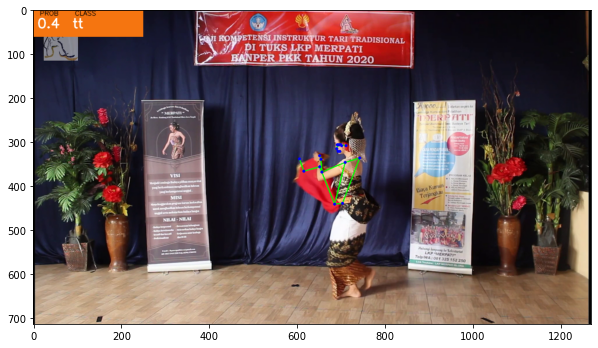

 37%|███████████████████████████▉                                                | 1103/3000.0 [02:08<04:48,  6.57it/s]

tga [0.3  0.35 0.35]
tt [0.26 0.28 0.46]
tt [0.21 0.35 0.44]



 37%|███████████████████████████▉                                                | 1105/3000.0 [02:08<04:05,  7.71it/s]

tt [0.23 0.35 0.42]
tga [0.29 0.42 0.29]
tt [0.24 0.33 0.43]


 37%|████████████████████████████                                                | 1109/3000.0 [02:09<03:40,  8.60it/s]

tt [0.2  0.36 0.44]
tt [0.26 0.3  0.44]
tt [0.25 0.31 0.44]


 37%|████████████████████████████▏                                               | 1112/3000.0 [02:09<03:18,  9.53it/s]

tt [0.24 0.34 0.42]
tt [0.23 0.33 0.44]
tga 

 37%|████████████████████████████▏                                               | 1114/3000.0 [02:09<03:24,  9.21it/s]

[0.26 0.39 0.35]
tt [0.26 0.36 0.38]


 37%|████████████████████████████▎                                               | 1117/3000.0 [02:09<03:13,  9.74it/s]

tga [0.37 0.38 0.25]
tga [0.4  0.54 0.06]
tga [0.34 0.58 0.08]



 37%|████████████████████████████▎                                               | 1119/3000.0 [02:10<03:05, 10.14it/s]

tga [0.35 0.57 0.08]
tga [0.35 0.59 0.06]
tga [0.38 0.58 0.04]


 37%|████████████████████████████▍                                               | 1122/3000.0 [02:10<03:15,  9.61it/s]

tga [0.32 0.46 0.22]
tga [0.34 0.55 0.11]
tga [0.29 0.64 0.07]



 37%|████████████████████████████▍                                               | 1124/3000.0 [02:10<03:07,  9.98it/s]

tga [0.31 0.63 0.06]
tga [0.32 0.65 0.03]
tga [0.26 0.67 0.07]


 38%|████████████████████████████▌                                               | 1128/3000.0 [02:10<02:55, 10.65it/s]

tga [0.26 0.66 0.08]
tga [0.3  0.63 0.07]
tga [0.33 0.6  0.07]



 38%|████████████████████████████▋                                               | 1130/3000.0 [02:11<02:55, 10.67it/s]

tga [0.36 0.58 0.06]
tga [0.38 0.53 0.09]
tga [0.41 0.49 0.1 ]


 38%|████████████████████████████▋                                               | 1134/3000.0 [02:11<02:59, 10.41it/s]

tga [0.36 0.53 0.11]
tga [0.38 0.47 0.15]
tga [0.35 0.48 0.17]



 38%|████████████████████████████▊                                               | 1136/3000.0 [02:11<02:55, 10.60it/s]

tga [0.35 0.54 0.11]
tga [0.42 0.5  0.08]
tga [0.4  0.53 0.07]


 38%|████████████████████████████▉                                               | 1140/3000.0 [02:12<02:49, 10.99it/s]

tga [0.44 0.48 0.08]
tga [0.41 0.5  0.09]
tga [0.44 0.47 0.09]



 38%|████████████████████████████▉                                               | 1142/3000.0 [02:12<02:48, 11.01it/s]

tga [0.36 0.52 0.12]
tga [0.48 0.49 0.03]



 38%|████████████████████████████▉                                               | 1144/3000.0 [02:12<02:52, 10.77it/s]

tga [0.46 0.49 0.05]
tga [0.44 0.51 0.05]
tga [0.44 0.5  0.06]


 38%|█████████████████████████████                                               | 1148/3000.0 [02:12<02:50, 10.86it/s]

tga [0.41 0.51 0.08]
tg [0.5  0.43 0.07]
tg [0.49 0.43 0.08]



 38%|█████████████████████████████▏                                              | 1150/3000.0 [02:12<02:49, 10.93it/s]

tg [0.48 0.42 0.1 ]
tg [0.49 0.46 0.05]


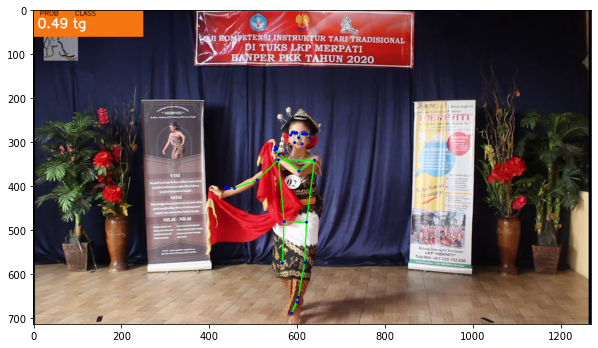

 38%|█████████████████████████████▏                                              | 1153/3000.0 [02:13<04:34,  6.72it/s]

tg [0.46 0.45 0.09]
tga [0.44 0.45 0.11]
tg [0.5  0.39 0.11]


 39%|█████████████████████████████▎                                              | 1156/3000.0 [02:14<03:48,  8.06it/s]

tga [0.36 0.5  0.14]
tg [0.53 0.42 0.05]
tg [0.53 0.44 0.03]



 39%|█████████████████████████████▎                                              | 1158/3000.0 [02:14<03:30,  8.75it/s]

tg [0.48 0.46 0.06]
tg [0.5  0.38 0.12]
tg [0.52 0.38 0.1 ]


 39%|█████████████████████████████▍                                              | 1162/3000.0 [02:14<03:23,  9.02it/s]

tg [0.52 0.36 0.12]
tg [0.51 0.35 0.14]


 39%|█████████████████████████████▍                                              | 1164/3000.0 [02:14<03:28,  8.83it/s]

tg [0.53 0.35 0.12]
tg [0.53 0.36 0.11]



 39%|█████████████████████████████▌                                              | 1165/3000.0 [02:14<03:24,  8.96it/s]

tg [0.49 0.36 0.15]
tg [0.51 0.34 0.15]


 39%|█████████████████████████████▌                                              | 1168/3000.0 [02:15<03:11,  9.56it/s]

tg [0.49 0.37 0.14]
tg [0.5  0.34 0.16]
tg [0.51 0.36 0.13]


 39%|█████████████████████████████▋                                              | 1171/3000.0 [02:15<03:05,  9.86it/s]

tg [0.54 0.34 0.12]
tg [0.51 0.35 0.14]


 39%|█████████████████████████████▋                                              | 1173/3000.0 [02:15<03:08,  9.71it/s]

tg [0.51 0.41 0.08]
tg [0.52 0.41 0.07]
tg [0.49 0.37 0.14]


 39%|█████████████████████████████▊                                              | 1175/3000.0 [02:16<03:08,  9.69it/s]

tg [0.49 0.39 0.12]
tg [0.48 0.39 0.13]
tg [0.42 0.42 0.16]


 39%|█████████████████████████████▊                                              | 1178/3000.0 [02:16<03:05,  9.82it/s]

tg [0.47 0.37 0.16]
tga [0.38 0.43 0.19]
tga [0.33 0.48 0.19]


 39%|█████████████████████████████▉                                              | 1181/3000.0 [02:16<02:59, 10.12it/s]

tga [0.31 0.59 0.1 ]
tga [0.36 0.5  0.14]
tga [0.39 0.44 0.17]


 40%|██████████████████████████████                                              | 1185/3000.0 [02:16<02:58, 10.18it/s]

tga [0.4  0.43 0.17]
tga [0.41 0.5  0.09]
tga [0.39 0.44 0.17]



 40%|██████████████████████████████                                              | 1187/3000.0 [02:17<02:56, 10.26it/s]

tg [0.44 0.43 0.13]
tga [0.38 0.45 0.17]
tga [0.4  0.45 0.15]


 40%|██████████████████████████████▏                                             | 1191/3000.0 [02:17<02:56, 10.26it/s]

tga [0.42 0.43 0.15]
tga [0.4  0.43 0.17]
tga [0.38 0.46 0.16]



 40%|██████████████████████████████▏                                             | 1193/3000.0 [02:17<02:57, 10.19it/s]

tg [0.44 0.41 0.15]
tga [0.35 0.48 0.17]
tga [0.34 0.45 0.21]


 40%|██████████████████████████████▎                                             | 1197/3000.0 [02:18<02:57, 10.17it/s]

tga [0.37 0.49 0.14]
tga [0.36 0.47 0.17]



 40%|██████████████████████████████▎                                             | 1199/3000.0 [02:18<02:58, 10.07it/s]

tga [0.34 0.48 0.18]
tga [0.34 0.46 0.2 ]
tga [0.35 0.44 0.21]
tg [0.42 0.39 0.19]


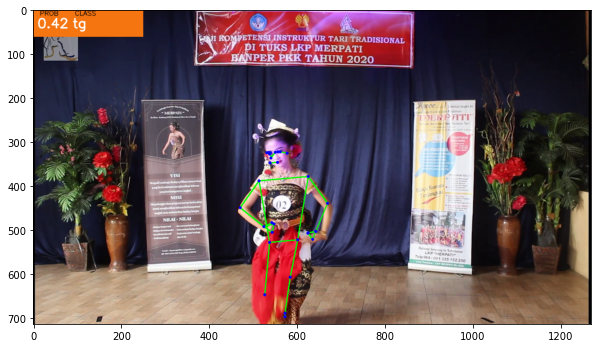

 40%|██████████████████████████████▍                                             | 1203/3000.0 [02:19<04:25,  6.77it/s]

tga [0.39 0.41 0.2 ]
tga [0.33 0.54 0.13]
tga [0.29 0.54 0.17]


 40%|██████████████████████████████▌                                             | 1206/3000.0 [02:19<03:34,  8.37it/s]

tga [0.35 0.51 0.14]
tga [0.35 0.51 0.14]
tga [0.31 0.57 0.12]



 40%|██████████████████████████████▌                                             | 1208/3000.0 [02:19<03:15,  9.15it/s]

tga [0.3  0.59 0.11]
tga [0.3  0.58 0.12]
tga [0.29 0.59 0.12]


 40%|██████████████████████████████▋                                             | 1212/3000.0 [02:20<03:08,  9.50it/s]

tga [0.31 0.57 0.12]
tga [0.31 0.57 0.12]



 40%|██████████████████████████████▋                                             | 1213/3000.0 [02:20<03:24,  8.73it/s]

tga [0.31 0.57 0.12]
tga [0.32 0.56 0.12]


 41%|██████████████████████████████▊                                             | 1216/3000.0 [02:20<04:07,  7.22it/s]

tga [0.35 0.52 0.13]
tga [0.35 0.52 0.13]



 41%|██████████████████████████████▊                                             | 1217/3000.0 [02:20<04:14,  7.01it/s]

tga [0.34 0.53 0.13]



 41%|██████████████████████████████▊                                             | 1218/3000.0 [02:21<04:45,  6.23it/s]

tga [0.37 0.51 0.12]



 41%|██████████████████████████████▉                                             | 1219/3000.0 [02:21<05:23,  5.50it/s]

tga [0.36 0.51 0.13]



 41%|██████████████████████████████▉                                             | 1220/3000.0 [02:21<05:31,  5.37it/s]

tga [0.38 0.5  0.12]
tga 


 41%|██████████████████████████████▉                                             | 1221/3000.0 [02:21<05:43,  5.18it/s]

[0.38 0.51 0.11]


 41%|██████████████████████████████▉                                             | 1223/3000.0 [02:22<05:25,  5.46it/s]

tga [0.38 0.51 0.11]
tga [0.38 0.51 0.11]



 41%|███████████████████████████████                                             | 1224/3000.0 [02:22<05:19,  5.55it/s]

tga [0.32 0.55 0.13]
tga [0.36 0.52 0.12]


 41%|███████████████████████████████                                             | 1227/3000.0 [02:22<04:12,  7.02it/s]

tga [0.32 0.54 0.14]
tga [0.33 0.54 0.13]
tga [0.3  0.59 0.11]


 41%|███████████████████████████████▏                                            | 1231/3000.0 [02:23<03:03,  9.64it/s]

tga [0.31 0.56 0.13]
tga [0.32 0.54 0.14]
tga [0.33 0.54 0.13]



 41%|███████████████████████████████▏                                            | 1233/3000.0 [02:23<02:51, 10.31it/s]

tga [0.34 0.53 0.13]
tga [0.35 0.51 0.14]
tga [0.43 0.44 0.13]
tg [0.43 0.43 0.14]


 41%|███████████████████████████████▎                                            | 1237/3000.0 [02:23<03:53,  7.55it/s]

tg [0.44 0.42 0.14]
tga [0.42 0.44 0.14]
tga [0.39 0.45 0.16]


 41%|███████████████████████████████▍                                            | 1241/3000.0 [02:24<03:03,  9.58it/s]

tga [0.38 0.46 0.16]
tga [0.4  0.45 0.15]
tga [0.39 0.46 0.15]



 41%|███████████████████████████████▍                                            | 1243/3000.0 [02:24<03:04,  9.55it/s]

tga [0.37 0.47 0.16]
tga [0.39 0.46 0.15]
tga [0.4  0.46 0.14]


 42%|███████████████████████████████▌                                            | 1247/3000.0 [02:24<02:45, 10.58it/s]

tga [0.42 0.44 0.14]
tga [0.42 0.45 0.13]
tga [0.43 0.46 0.11]



 42%|███████████████████████████████▋                                            | 1249/3000.0 [02:24<02:38, 11.08it/s]

tga [0.41 0.49 0.1 ]
tga [0.41 0.46 0.13]
tga [0.43 0.46 0.11]
tga [0.42 0.47 0.11]


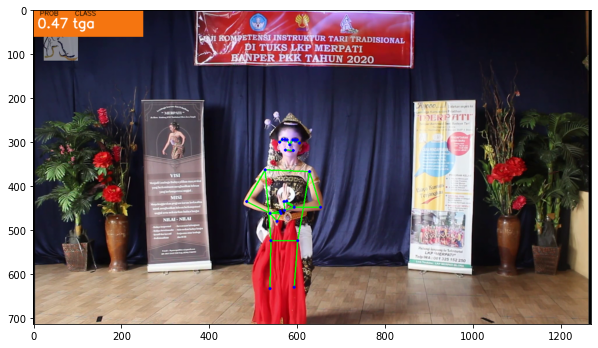

 42%|███████████████████████████████▋                                            | 1253/3000.0 [02:25<03:35,  8.11it/s]

tga [0.42 0.48 0.1 ]
tga [0.42 0.47 0.11]
tga [0.43 0.46 0.11]


 42%|███████████████████████████████▊                                            | 1256/3000.0 [02:25<03:30,  8.29it/s]

tga [0.42 0.46 0.12]
tga [0.42 0.46 0.12]
tga [0.41 0.46 0.13]



 42%|███████████████████████████████▊                                            | 1258/3000.0 [02:26<03:07,  9.28it/s]

tga [0.41 0.47 0.12]
tga [0.42 0.44 0.14]
tga [0.36 0.47 0.17]


 42%|███████████████████████████████▉                                            | 1262/3000.0 [02:26<02:51, 10.12it/s]

tga [0.31 0.52 0.17]
tga [0.3  0.53 0.17]
tga [0.3  0.54 0.16]


 42%|████████████████████████████████                                            | 1266/3000.0 [02:26<02:39, 10.90it/s]

tga [0.3  0.54 0.16]
tga [0.33 0.52 0.15]
tga [0.35 0.51 0.14]



 42%|████████████████████████████████                                            | 1268/3000.0 [02:27<02:33, 11.31it/s]

tga [0.4  0.48 0.12]
tga [0.42 0.47 0.11]



 42%|████████████████████████████████▏                                           | 1270/3000.0 [02:27<03:08,  9.18it/s]

tga [0.37 0.5  0.13]
tga [0.34 0.53 0.13]


 42%|████████████████████████████████▏                                           | 1272/3000.0 [02:27<03:14,  8.87it/s]

tga [0.36 0.51 0.13]
tga [0.35 0.52 0.13]



 42%|████████████████████████████████▏                                           | 1273/3000.0 [02:27<03:40,  7.83it/s]

tga [0.34 0.54 0.12]
tga [0.32 0.55 0.13]


 43%|████████████████████████████████▎                                           | 1276/3000.0 [02:28<04:15,  6.75it/s]

tga [0.31 0.56 0.13]
tga [0.32 0.54 0.14]



 43%|████████████████████████████████▎                                           | 1277/3000.0 [02:28<04:22,  6.56it/s]

tga [0.31 0.54 0.15]
tga

 43%|████████████████████████████████▍                                           | 1279/3000.0 [02:28<04:25,  6.49it/s]

 [0.34 0.54 0.12]
tga [0.37 0.51 0.12]


 43%|████████████████████████████████▍                                           | 1281/3000.0 [02:29<04:26,  6.44it/s]

tga [0.37 0.51 0.12]
tga [0.39 0.5  0.11]


 43%|████████████████████████████████▌                                           | 1283/3000.0 [02:29<04:15,  6.71it/s]

tga [0.44 0.47 0.09]
tga [0.39 0.51 0.1 ]


 43%|████████████████████████████████▌                                           | 1285/3000.0 [02:29<04:14,  6.74it/s]

tga [0.35 0.53 0.12]
tga [0.36 0.51 0.13]


 43%|████████████████████████████████▌                                           | 1287/3000.0 [02:29<04:02,  7.06it/s]

tga [0.36 0.51 0.13]
tga [0.35 0.53 0.12]


 43%|████████████████████████████████▋                                           | 1289/3000.0 [02:30<04:01,  7.09it/s]

tga [0.36 0.53 0.11]
tga [0.36 0.52 0.12]


 43%|████████████████████████████████▋                                           | 1291/3000.0 [02:30<04:13,  6.74it/s]

tga [0.35 0.52 0.13]
tga [0.37 0.53 0.1 ]


 43%|████████████████████████████████▊                                           | 1293/3000.0 [02:30<04:20,  6.55it/s]

tga [0.36 0.5  0.14]
tga [0.34 0.5  0.16]


 43%|████████████████████████████████▊                                           | 1295/3000.0 [02:31<04:52,  5.83it/s]

tga [0.32 0.52 0.16]
tga [0.31 0.53 0.16]


 43%|████████████████████████████████▊                                           | 1297/3000.0 [02:31<04:31,  6.27it/s]

tga [0.31 0.53 0.16]
tga [0.3  0.54 0.16]


 43%|████████████████████████████████▉                                           | 1299/3000.0 [02:31<04:05,  6.94it/s]

tga [0.32 0.52 0.16]
tga [0.3  0.54 0.16]



 43%|████████████████████████████████▉                                           | 1300/3000.0 [02:31<04:35,  6.17it/s]

tga [0.33 0.51 0.16]
tga [0.39 0.47 0.14]


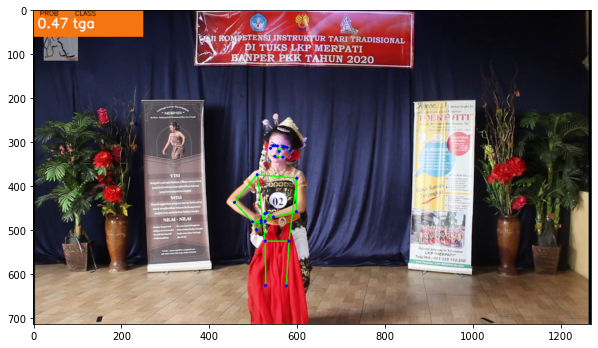

 43%|████████████████████████████████▉                                           | 1302/3000.0 [02:32<07:35,  3.73it/s]

tga [0.43 0.44 0.13]


 43%|█████████████████████████████████                                           | 1304/3000.0 [02:33<06:14,  4.53it/s]

tga [0.43 0.44 0.13]
tga [0.42 0.45 0.13]


 44%|█████████████████████████████████                                           | 1306/3000.0 [02:33<04:45,  5.93it/s]

tg [0.46 0.43 0.11]
tga [0.42 0.46 0.12]



 44%|█████████████████████████████████                                           | 1307/3000.0 [02:33<04:16,  6.61it/s]

tga [0.43 0.45 0.12]
tg [0.44 0.44 0.12]
tga [0.43 0.44 0.13]


 44%|█████████████████████████████████▏                                          | 1311/3000.0 [02:33<03:04,  9.15it/s]

tg [0.45 0.43 0.12]
tga [0.41 0.44 0.15]
tga [0.42 0.45 0.13]



 44%|█████████████████████████████████▎                                          | 1313/3000.0 [02:34<02:55,  9.60it/s]

tg [0.43 0.43 0.14]
tga [0.43 0.45 0.12]
tg [0.45 0.45 0.1 ]


 44%|█████████████████████████████████▎                                          | 1317/3000.0 [02:34<02:44, 10.24it/s]

tga [0.43 0.47 0.1 ]
tga [0.42 0.49 0.09]
tga [0.43 0.48 0.09]


 44%|█████████████████████████████████▍                                          | 1321/3000.0 [02:34<02:23, 11.67it/s]

tga [0.43 0.48 0.09]
tga [0.42 0.47 0.11]
tga [0.42 0.46 0.12]



 44%|█████████████████████████████████▌                                          | 1323/3000.0 [02:34<02:29, 11.23it/s]

tga [0.42 0.46 0.12]
tga [0.43 0.44 0.13]
tga [0.42 0.47 0.11]



 44%|█████████████████████████████████▌                                          | 1325/3000.0 [02:35<02:36, 10.68it/s]

tga [0.43 0.44 0.13]
tga [0.36 0.52 0.12]



 44%|█████████████████████████████████▌                                          | 1327/3000.0 [02:35<02:50,  9.81it/s]

tga [0.38 0.48 0.14]
tga [0.33 0.53 0.14]



 44%|█████████████████████████████████▋                                          | 1329/3000.0 [02:35<03:04,  9.08it/s]

tga [0.36 0.49 0.15]
tga [0.35 0.52 0.13]
tga [0.39 0.47 0.14]


 44%|█████████████████████████████████▊                                          | 1333/3000.0 [02:36<02:51,  9.75it/s]

tga [0.41 0.46 0.13]
tga [0.4  0.48 0.12]
tga [0.37 0.5  0.13]


 45%|█████████████████████████████████▊                                          | 1336/3000.0 [02:36<03:01,  9.15it/s]

tga [0.38 0.47 0.15]
tga [0.39 0.46 0.15]


 45%|█████████████████████████████████▉                                          | 1339/3000.0 [02:36<02:51,  9.71it/s]

tga [0.39 0.46 0.15]
tga [0.39 0.46 0.15]
tga [0.4  0.46 0.14]



 45%|█████████████████████████████████▉                                          | 1341/3000.0 [02:36<02:47,  9.91it/s]

tga [0.4  0.46 0.14]
tg [0.43 0.43 0.14]
tga 


 45%|██████████████████████████████████                                          | 1343/3000.0 [02:37<02:52,  9.63it/s]

[0.41 0.45 0.14]
tga [0.4  0.46 0.14]


 45%|██████████████████████████████████                                          | 1345/3000.0 [02:37<03:36,  7.66it/s]

tg [0.43 0.43 0.14]
tga [0.43 0.44 0.13]


 45%|██████████████████████████████████                                          | 1347/3000.0 [02:37<03:18,  8.32it/s]

tga [0.42 0.44 0.14]
tg [0.45 0.43 0.12]
tga [0.43 0.45 0.12]


 45%|██████████████████████████████████▏                                         | 1350/3000.0 [02:37<03:05,  8.92it/s]

tga [0.42 0.46 0.12]
tga [0.42 0.45 0.13]
tga [0.43 0.46 0.11]


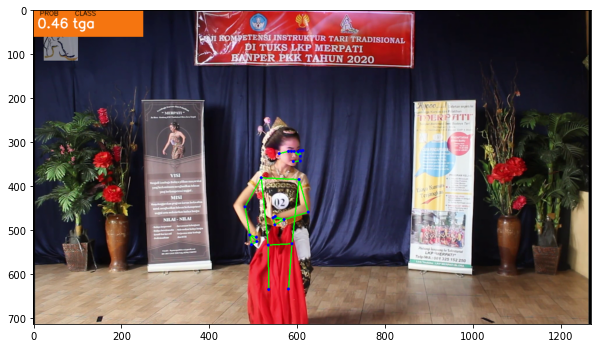

 45%|██████████████████████████████████▎                                         | 1353/3000.0 [02:38<04:47,  5.72it/s]

tga [0.42 0.45 0.13]
tga [0.42 0.44 0.14]
tga 

 45%|██████████████████████████████████▎                                         | 1355/3000.0 [02:38<03:49,  7.16it/s]

[0.41 0.46 0.13]
tga [0.43 0.44 0.13]
tg [0.47 0.41 0.12]


 45%|██████████████████████████████████▍                                         | 1358/3000.0 [02:39<03:22,  8.09it/s]

tg [0.45 0.42 0.13]
tg [0.44 0.44 0.12]


 45%|██████████████████████████████████▍                                         | 1360/3000.0 [02:39<03:45,  7.26it/s]

tg [0.46 0.42 0.12]
tg [0.45 0.43 0.12]


 45%|██████████████████████████████████▌                                         | 1362/3000.0 [02:39<03:56,  6.94it/s]

tga [0.42 0.46 0.12]
tga [0.42 0.46 0.12]



 45%|██████████████████████████████████▌                                         | 1363/3000.0 [02:40<04:07,  6.61it/s]

tga [0.42 0.45 0.13]
tga

 46%|██████████████████████████████████▌                                         | 1365/3000.0 [02:40<04:30,  6.03it/s]

 [0.41 0.46 0.13]
tga [0.4  0.47 0.13]


 46%|██████████████████████████████████▋                                         | 1367/3000.0 [02:40<04:07,  6.59it/s]

tga [0.41 0.46 0.13]
tga [0.41 0.45 0.14]


 46%|██████████████████████████████████▋                                         | 1369/3000.0 [02:40<03:51,  7.04it/s]

tga [0.41 0.45 0.14]
tga [0.37 0.49 0.14]


 46%|██████████████████████████████████▋                                         | 1371/3000.0 [02:41<03:49,  7.09it/s]

tga [0.39 0.47 0.14]
tga [0.42 0.44 0.14]


 46%|██████████████████████████████████▊                                         | 1373/3000.0 [02:41<03:48,  7.13it/s]

tga [0.42 0.45 0.13]
tg [0.43 0.43 0.14]


 46%|██████████████████████████████████▊                                         | 1375/3000.0 [02:41<03:46,  7.16it/s]

tga [0.42 0.45 0.13]
tga [0.41 0.46 0.13]


 46%|██████████████████████████████████▉                                         | 1377/3000.0 [02:42<03:31,  7.69it/s]

tga [0.43 0.45 0.12]
tga [0.42 0.43 0.15]
tga [0.36 0.47 0.17]



 46%|██████████████████████████████████▉                                         | 1379/3000.0 [02:42<02:56,  9.19it/s]

tga [0.41 0.45 0.14]
tga [0.35 0.5  0.15]
tga [0.41 0.44 0.15]


 46%|███████████████████████████████████                                         | 1383/3000.0 [02:42<02:28, 10.86it/s]

tga [0.41 0.44 0.15]
tga [0.42 0.44 0.14]
tg [0.44 0.44 0.12]



 46%|███████████████████████████████████                                         | 1385/3000.0 [02:42<02:22, 11.31it/s]

tga [0.43 0.45 0.12]
tga [0.43 0.45 0.12]
tg [0.45 0.43 0.12]


 46%|███████████████████████████████████▏                                        | 1389/3000.0 [02:43<02:23, 11.20it/s]

tga [0.4  0.46 0.14]
tga [0.41 0.46 0.13]
tga [0.41 0.45 0.14]



 46%|███████████████████████████████████▏                                        | 1391/3000.0 [02:43<02:24, 11.17it/s]

tga [0.41 0.45 0.14]
tga [0.42 0.46 0.12]
tga [0.42 0.45 0.13]


 46%|███████████████████████████████████▎                                        | 1395/3000.0 [02:43<02:23, 11.19it/s]

tga [0.42 0.45 0.13]
tga [0.4  0.46 0.14]
tga [0.39 0.46 0.15]


 47%|███████████████████████████████████▍                                        | 1399/3000.0 [02:43<02:20, 11.42it/s]

tga [0.35 0.5  0.15]
tga [0.38 0.47 0.15]
tga [0.41 0.44 0.15]
tga [0.32 0.54 0.14]
tga [0.28 0.59 0.13]


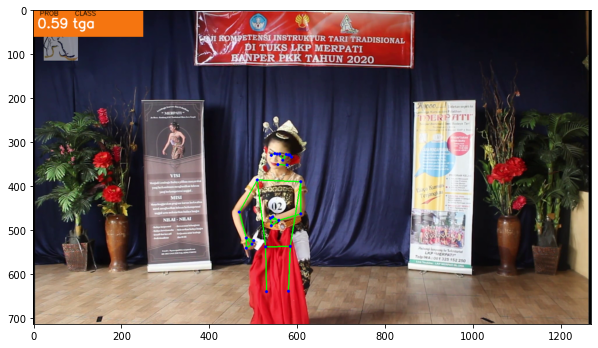

 47%|███████████████████████████████████▌                                        | 1403/3000.0 [02:44<03:24,  7.80it/s]

tga [0.3  0.55 0.15]
tga [0.37 0.48 0.15]
tga [0.37 0.48 0.15]


 47%|███████████████████████████████████▋                                        | 1407/3000.0 [02:45<02:47,  9.51it/s]

tga [0.37 0.47 0.16]
tga [0.4  0.44 0.16]
tga [0.37 0.47 0.16]



 47%|███████████████████████████████████▋                                        | 1409/3000.0 [02:45<02:39, 10.00it/s]

tga [0.38 0.48 0.14]
tga [0.35 0.49 0.16]
tga [0.33 0.5  0.17]


 47%|███████████████████████████████████▊                                        | 1413/3000.0 [02:45<02:29, 10.60it/s]

tga [0.34 0.5  0.16]
tga [0.33 0.54 0.13]
tga [0.34 0.52 0.14]



 47%|███████████████████████████████████▊                                        | 1415/3000.0 [02:45<02:23, 11.01it/s]

tga [0.37 0.51 0.12]
tga [0.35 0.51 0.14]
tga [0.28 0.57 0.15]


 47%|███████████████████████████████████▉                                        | 1419/3000.0 [02:46<02:18, 11.41it/s]

tga [0.32 0.53 0.15]
tga [0.33 0.53 0.14]
tga [0.33 0.5  0.17]



 47%|███████████████████████████████████▉                                        | 1421/3000.0 [02:46<02:14, 11.72it/s]

tga [0.33 0.52 0.15]
tga [0.34 0.5  0.16]
tga [0.33 0.49 0.18]


 48%|████████████████████████████████████                                        | 1425/3000.0 [02:46<02:08, 12.27it/s]

tga [0.32 0.52 0.16]
tga [0.34 0.51 0.15]
tga [0.37 0.49 0.14]



 48%|████████████████████████████████████▏                                       | 1427/3000.0 [02:46<02:09, 12.18it/s]

tga [0.36 0.5  0.14]
tga [0.38 0.5  0.12]
tga [0.4  0.47 0.13]


 48%|████████████████████████████████████▎                                       | 1431/3000.0 [02:47<02:10, 12.03it/s]

tga [0.43 0.45 0.12]
tga [0.38 0.51 0.11]
tga [0.39 0.52 0.09]



 48%|████████████████████████████████████▎                                       | 1433/3000.0 [02:47<02:07, 12.25it/s]

tga [0.35 0.51 0.14]
tga [0.36 0.5  0.14]
tga [0.32 0.52 0.16]


 48%|████████████████████████████████████▍                                       | 1437/3000.0 [02:47<02:05, 12.41it/s]

tga [0.3  0.55 0.15]
tga [0.3  0.55 0.15]
tga [0.33 0.52 0.15]



 48%|████████████████████████████████████▍                                       | 1439/3000.0 [02:47<02:05, 12.48it/s]

tga [0.32 0.53 0.15]
tga [0.32 0.53 0.15]
tga [0.36 0.51 0.13]


 48%|████████████████████████████████████▌                                       | 1443/3000.0 [02:48<02:02, 12.71it/s]

tg [0.47 0.43 0.1 ]
tga [0.43 0.45 0.12]
tga [0.41 0.45 0.14]



 48%|████████████████████████████████████▌                                       | 1445/3000.0 [02:48<02:03, 12.55it/s]

tga [0.35 0.49 0.16]
tga [0.42 0.44 0.14]
tga [0.42 0.45 0.13]


 48%|████████████████████████████████████▋                                       | 1449/3000.0 [02:48<02:10, 11.91it/s]

tga [0.35 0.52 0.13]
tga [0.35 0.52 0.13]
tga [0.35 0.5  0.15]
tga [0.35 0.53 0.12]
tga [0.36 0.53 0.11]


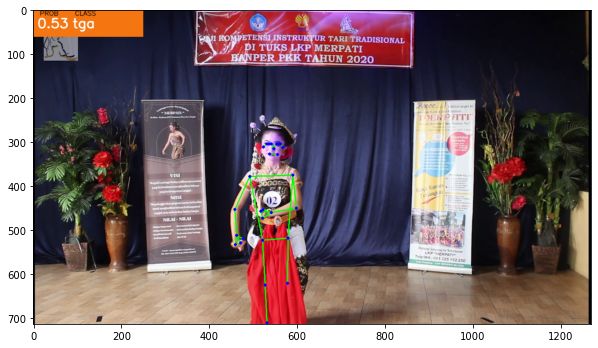

 48%|████████████████████████████████████▊                                       | 1453/3000.0 [02:49<03:07,  8.26it/s]

tga [0.33 0.53 0.14]
tga [0.36 0.51 0.13]
tg [0.44 0.44 0.12]


 49%|████████████████████████████████████▉                                       | 1457/3000.0 [02:49<02:41,  9.56it/s]

tga [0.43 0.45 0.12]
tga [0.43 0.48 0.09]
tga [0.43 0.48 0.09]



 49%|████████████████████████████████████▉                                       | 1459/3000.0 [02:49<02:34,  9.95it/s]

tga [0.43 0.47 0.1 ]
tga [0.42 0.48 0.1 ]
tga [0.42 0.47 0.11]


 49%|█████████████████████████████████████                                       | 1463/3000.0 [02:50<02:18, 11.12it/s]

tga [0.41 0.47 0.12]
tga [0.41 0.47 0.12]
tga [0.42 0.46 0.12]



 49%|█████████████████████████████████████                                       | 1465/3000.0 [02:50<02:13, 11.52it/s]

tga [0.4  0.47 0.13]
tga [0.42 0.46 0.12]
tga [0.42 0.46 0.12]


 49%|█████████████████████████████████████▏                                      | 1469/3000.0 [02:50<02:10, 11.74it/s]

tg [0.46 0.42 0.12]
tga [0.42 0.44 0.14]
tg [0.44 0.44 0.12]



 49%|█████████████████████████████████████▎                                      | 1471/3000.0 [02:50<02:06, 12.06it/s]

tga [0.44 0.45 0.11]
tga [0.41 0.47 0.12]
tga [0.39 0.48 0.13]


 49%|█████████████████████████████████████▎                                      | 1475/3000.0 [02:51<02:02, 12.42it/s]

tga [0.38 0.48 0.14]
tga [0.38 0.48 0.14]
tga [0.41 0.44 0.15]



 49%|█████████████████████████████████████▍                                      | 1477/3000.0 [02:51<02:03, 12.34it/s]

tga [0.41 0.45 0.14]
tga [0.39 0.47 0.14]
tga [0.39 0.46 0.15]


 49%|█████████████████████████████████████▌                                      | 1481/3000.0 [02:51<02:06, 12.02it/s]

tga [0.41 0.45 0.14]
tga [0.4  0.46 0.14]
tga [0.39 0.47 0.14]



 49%|█████████████████████████████████████▌                                      | 1483/3000.0 [02:51<02:05, 12.11it/s]

tga [0.39 0.47 0.14]
tga [0.37 0.49 0.14]
tga [0.38 0.47 0.15]


 50%|█████████████████████████████████████▋                                      | 1487/3000.0 [02:52<02:03, 12.23it/s]

tga [0.41 0.46 0.13]
tga [0.41 0.47 0.12]
tga [0.41 0.47 0.12]



 50%|█████████████████████████████████████▋                                      | 1489/3000.0 [02:52<02:07, 11.85it/s]

tga [0.41 0.46 0.13]
tga [0.39 0.47 0.14]
tga [0.41 0.46 0.13]


 50%|█████████████████████████████████████▊                                      | 1493/3000.0 [02:52<02:06, 11.91it/s]

tga [0.39 0.47 0.14]
tga [0.42 0.45 0.13]
tg [0.45 0.42 0.13]



 50%|█████████████████████████████████████▊                                      | 1495/3000.0 [02:52<02:03, 12.16it/s]

tga [0.41 0.44 0.15]
tga [0.42 0.43 0.15]
tg [0.43 0.41 0.16]


 50%|█████████████████████████████████████▉                                      | 1499/3000.0 [02:53<02:02, 12.23it/s]

tg [0.45 0.41 0.14]
tga [0.41 0.48 0.11]
tg [0.46 0.42 0.12]
tg [0.44 0.44 0.12]
tg [0.44 0.44 0.12]


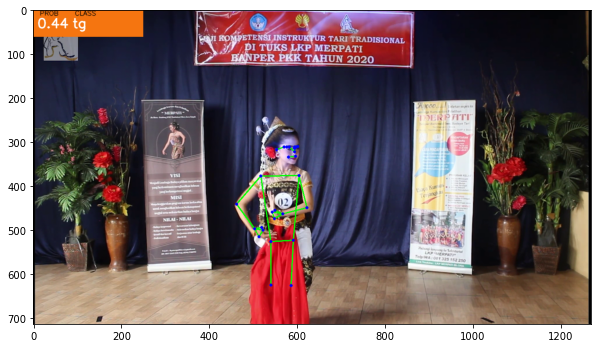

 50%|██████████████████████████████████████                                      | 1503/3000.0 [02:53<03:00,  8.31it/s]

tga [0.4  0.47 0.13]
tga [0.4  0.47 0.13]
tga [0.42 0.45 0.13]


 50%|██████████████████████████████████████▏                                     | 1507/3000.0 [02:54<02:30,  9.93it/s]

tga [0.41 0.46 0.13]
tga [0.4  0.46 0.14]
tga [0.4  0.46 0.14]



 50%|██████████████████████████████████████▏                                     | 1509/3000.0 [02:54<02:30,  9.88it/s]

tga [0.38 0.49 0.13]
tga [0.4  0.46 0.14]
tga [0.39 0.47 0.14]


 50%|██████████████████████████████████████▎                                     | 1513/3000.0 [02:54<02:24, 10.30it/s]

tga [0.42 0.44 0.14]
tga [0.42 0.44 0.14]
tga [0.41 0.45 0.14]



 50%|██████████████████████████████████████▍                                     | 1515/3000.0 [02:54<02:16, 10.86it/s]

tga [0.41 0.46 0.13]
tga [0.41 0.47 0.12]
tga [0.33 0.53 0.14]


 51%|██████████████████████████████████████▍                                     | 1519/3000.0 [02:55<02:06, 11.66it/s]

tga [0.34 0.51 0.15]
tga [0.34 0.51 0.15]
tga [0.36 0.5  0.14]



 51%|██████████████████████████████████████▌                                     | 1521/3000.0 [02:55<02:03, 11.99it/s]

tga [0.36 0.49 0.15]
tga [0.42 0.44 0.14]
tga [0.43 0.45 0.12]


 51%|██████████████████████████████████████▋                                     | 1525/3000.0 [02:55<01:59, 12.29it/s]

tg [0.44 0.43 0.13]
tga [0.41 0.47 0.12]
tga [0.43 0.44 0.13]



 51%|██████████████████████████████████████▋                                     | 1527/3000.0 [02:55<01:57, 12.59it/s]

tga [0.42 0.44 0.14]
tga [0.42 0.44 0.14]
tga [0.42 0.45 0.13]


 51%|██████████████████████████████████████▊                                     | 1531/3000.0 [02:56<01:55, 12.67it/s]

tga [0.43 0.45 0.12]
tga [0.42 0.46 0.12]
tga [0.41 0.48 0.11]



 51%|██████████████████████████████████████▊                                     | 1533/3000.0 [02:56<01:53, 12.91it/s]

tga [0.4  0.49 0.11]
tga [0.37 0.5  0.13]
tga [0.36 0.52 0.12]


 51%|██████████████████████████████████████▉                                     | 1537/3000.0 [02:56<01:53, 12.85it/s]

tga [0.34 0.52 0.14]
tga [0.34 0.52 0.14]
tga [0.35 0.52 0.13]



 51%|██████████████████████████████████████▉                                     | 1539/3000.0 [02:56<01:52, 12.96it/s]

tga [0.35 0.52 0.13]
tga [0.35 0.52 0.13]
tga [0.31 0.53 0.16]


 51%|███████████████████████████████████████                                     | 1543/3000.0 [02:56<01:50, 13.14it/s]

tga [0.36 0.48 0.16]
tga [0.37 0.49 0.14]
tga [0.39 0.47 0.14]



 52%|███████████████████████████████████████▏                                    | 1545/3000.0 [02:57<01:49, 13.25it/s]

tga [0.39 0.47 0.14]
tga [0.41 0.45 0.14]
tga [0.42 0.45 0.13]


 52%|███████████████████████████████████████▏                                    | 1549/3000.0 [02:57<01:51, 13.02it/s]

tga [0.41 0.46 0.13]
tga [0.4  0.46 0.14]
tga [0.42 0.45 0.13]
tga [0.42 0.46 0.12]
tga [0.43 0.45 0.12]


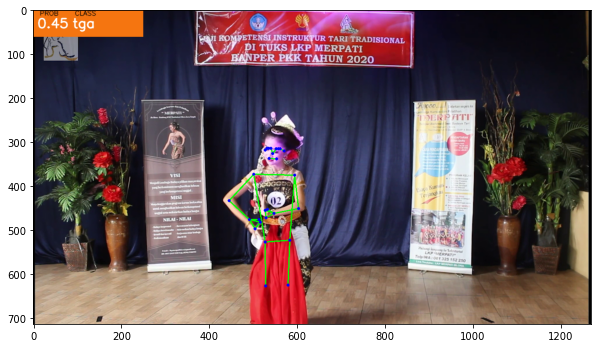

 52%|███████████████████████████████████████▎                                    | 1553/3000.0 [02:58<02:42,  8.92it/s]

tga [0.42 0.46 0.12]
tga [0.43 0.47 0.1 ]
tga [0.4  0.46 0.14]


 52%|███████████████████████████████████████▍                                    | 1557/3000.0 [02:58<02:14, 10.73it/s]

tga [0.36 0.5  0.14]
tga [0.34 0.53 0.13]
tga [0.33 0.53 0.14]



 52%|███████████████████████████████████████▍                                    | 1559/3000.0 [02:58<02:06, 11.40it/s]

tga [0.35 0.49 0.16]
tga [0.33 0.5  0.17]
tga [0.34 0.5  0.16]


 52%|███████████████████████████████████████▌                                    | 1563/3000.0 [02:58<01:57, 12.21it/s]

tga [0.34 0.52 0.14]
tga [0.34 0.52 0.14]
tga [0.36 0.49 0.15]



 52%|███████████████████████████████████████▋                                    | 1565/3000.0 [02:59<01:58, 12.09it/s]

tga [0.42 0.46 0.12]
tga [0.43 0.45 0.12]
tga [0.43 0.46 0.11]


 52%|███████████████████████████████████████▋                                    | 1569/3000.0 [02:59<01:54, 12.51it/s]

tga [0.43 0.44 0.13]
tga [0.39 0.46 0.15]
tga [0.4  0.46 0.14]



 52%|███████████████████████████████████████▊                                    | 1571/3000.0 [02:59<01:52, 12.69it/s]

tga [0.38 0.48 0.14]
tga [0.32 0.51 0.17]
tga [0.32 0.52 0.16]


 52%|███████████████████████████████████████▉                                    | 1575/3000.0 [02:59<01:52, 12.62it/s]

tga [0.32 0.52 0.16]
tga [0.31 0.54 0.15]
tga [0.3  0.55 0.15]



 53%|███████████████████████████████████████▉                                    | 1577/3000.0 [02:59<01:56, 12.19it/s]

tga [0.32 0.53 0.15]
tga [0.33 0.52 0.15]



 53%|████████████████████████████████████████                                    | 1579/3000.0 [03:00<02:03, 11.50it/s]

tga [0.36 0.51 0.13]
tga [0.39 0.49 0.12]
tga [0.34 0.49 0.17]


 53%|████████████████████████████████████████                                    | 1583/3000.0 [03:00<02:04, 11.34it/s]

tga [0.35 0.49 0.16]
tga [0.39 0.46 0.15]
tg [0.44 0.44 0.12]



 53%|████████████████████████████████████████▏                                   | 1585/3000.0 [03:00<02:08, 11.03it/s]

tga [0.43 0.45 0.12]
tga [0.43 0.45 0.12]
tga [0.44 0.45 0.11]


 53%|████████████████████████████████████████▎                                   | 1589/3000.0 [03:01<02:01, 11.57it/s]

tga [0.43 0.46 0.11]
tga [0.42 0.48 0.1 ]
tga [0.42 0.46 0.12]



 53%|████████████████████████████████████████▎                                   | 1591/3000.0 [03:01<01:58, 11.88it/s]

tga [0.41 0.45 0.14]
tga [0.42 0.47 0.11]
tga [0.41 0.47 0.12]



 53%|████████████████████████████████████████▎                                   | 1593/3000.0 [03:01<02:02, 11.47it/s]

tga [0.44 0.46 0.1 ]
tga [0.42 0.47 0.11]
tga [0.42 0.48 0.1 ]


 53%|████████████████████████████████████████▍                                   | 1597/3000.0 [03:01<02:02, 11.49it/s]

tga [0.43 0.45 0.12]
tg [0.45 0.44 0.11]
tga [0.42 0.47 0.11]



 53%|████████████████████████████████████████▌                                   | 1599/3000.0 [03:01<01:59, 11.70it/s]

tga [0.42 0.47 0.11]
tga [0.41 0.47 0.12]
tga [0.43 0.46 0.11]


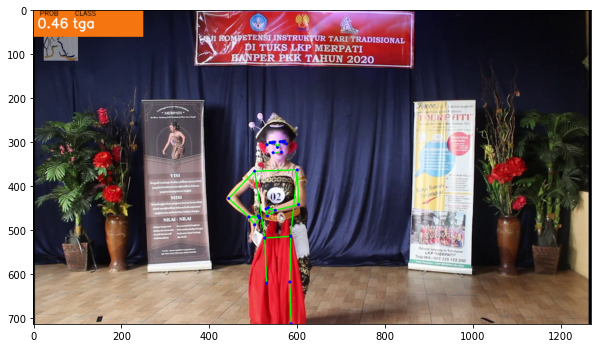

 53%|████████████████████████████████████████▌                                   | 1603/3000.0 [03:02<02:46,  8.41it/s]

tga [0.43 0.45 0.12]
tga [0.43 0.45 0.12]
tga [0.42 0.45 0.13]


 54%|████████████████████████████████████████▋                                   | 1607/3000.0 [03:02<02:19,  9.98it/s]

tga [0.42 0.45 0.13]
tga [0.42 0.45 0.13]
tga [0.42 0.46 0.12]



 54%|████████████████████████████████████████▊                                   | 1609/3000.0 [03:03<02:10, 10.64it/s]

tga [0.42 0.45 0.13]
tga [0.4  0.46 0.14]
tga [0.4  0.47 0.13]


 54%|████████████████████████████████████████▊                                   | 1613/3000.0 [03:03<02:03, 11.27it/s]

tga [0.4  0.46 0.14]
tga [0.4  0.46 0.14]
tga [0.39 0.47 0.14]



 54%|████████████████████████████████████████▉                                   | 1615/3000.0 [03:03<02:01, 11.43it/s]

tga [0.39 0.47 0.14]
tga [0.41 0.45 0.14]
tga [0.42 0.44 0.14]


 54%|█████████████████████████████████████████                                   | 1619/3000.0 [03:03<01:56, 11.82it/s]

tga [0.41 0.45 0.14]
tga [0.4  0.46 0.14]
tga [0.38 0.47 0.15]



 54%|█████████████████████████████████████████                                   | 1621/3000.0 [03:04<01:55, 11.95it/s]

tga [0.38 0.48 0.14]
tga [0.4  0.46 0.14]
tga [0.41 0.46 0.13]


 54%|█████████████████████████████████████████▏                                  | 1625/3000.0 [03:04<01:55, 11.93it/s]

tga [0.42 0.45 0.13]
tga [0.41 0.46 0.13]
tga [0.41 0.46 0.13]



 54%|█████████████████████████████████████████▏                                  | 1627/3000.0 [03:04<01:53, 12.09it/s]

tga [0.42 0.45 0.13]
tga [0.38 0.49 0.13]
tga [0.41 0.45 0.14]


 54%|█████████████████████████████████████████▎                                  | 1631/3000.0 [03:04<01:50, 12.34it/s]

tga [0.38 0.48 0.14]
tga [0.41 0.46 0.13]
tg [0.43 0.43 0.14]



 54%|█████████████████████████████████████████▎                                  | 1633/3000.0 [03:05<01:50, 12.34it/s]

tga [0.42 0.43 0.15]
tga [0.39 0.47 0.14]
tga [0.42 0.43 0.15]


 55%|█████████████████████████████████████████▍                                  | 1637/3000.0 [03:05<01:52, 12.13it/s]

tg [0.46 0.4  0.14]
tga [0.4  0.46 0.14]
tga [0.41 0.45 0.14]



 55%|█████████████████████████████████████████▌                                  | 1639/3000.0 [03:05<01:51, 12.19it/s]

tga [0.4  0.46 0.14]
tga [0.4  0.46 0.14]
tga [0.41 0.46 0.13]


 55%|█████████████████████████████████████████▌                                  | 1643/3000.0 [03:05<01:49, 12.43it/s]

tga [0.39 0.47 0.14]
tga [0.38 0.48 0.14]
tga [0.41 0.46 0.13]



 55%|█████████████████████████████████████████▋                                  | 1645/3000.0 [03:05<01:46, 12.69it/s]

tga [0.41 0.46 0.13]
tga [0.41 0.46 0.13]
tga [0.41 0.45 0.14]


 55%|█████████████████████████████████████████▊                                  | 1649/3000.0 [03:06<01:44, 12.91it/s]

tga [0.4  0.46 0.14]
tga [0.38 0.48 0.14]
tga [0.4  0.47 0.13]
tga [0.38 0.48 0.14]
tga [0.42 0.44 0.14]


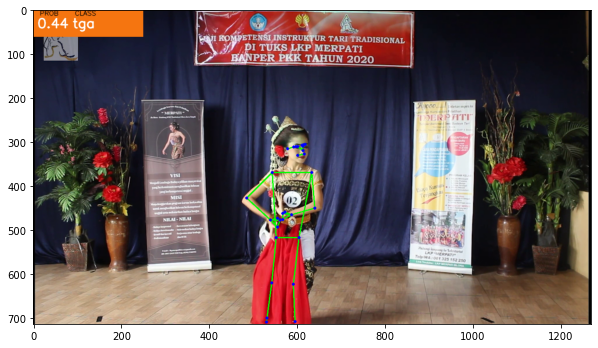

 55%|█████████████████████████████████████████▉                                  | 1653/3000.0 [03:06<02:32,  8.81it/s]

tga [0.39 0.49 0.12]
tga [0.43 0.44 0.13]
tga [0.4  0.46 0.14]


 55%|█████████████████████████████████████████▉                                  | 1657/3000.0 [03:07<02:11, 10.20it/s]

tga [0.37 0.47 0.16]
tga [0.35 0.51 0.14]
tga [0.36 0.5  0.14]



 55%|██████████████████████████████████████████                                  | 1659/3000.0 [03:07<02:03, 10.88it/s]

tga [0.38 0.49 0.13]
tga [0.38 0.48 0.14]
tga [0.43 0.44 0.13]


 55%|██████████████████████████████████████████▏                                 | 1663/3000.0 [03:07<01:53, 11.76it/s]

tga [0.41 0.48 0.11]
tg [0.44 0.44 0.12]
tg [0.45 0.43 0.12]



 56%|██████████████████████████████████████████▏                                 | 1665/3000.0 [03:07<01:51, 11.95it/s]

tga [0.43 0.45 0.12]
tga [0.42 0.45 0.13]
tga [0.43 0.45 0.12]


 56%|██████████████████████████████████████████▎                                 | 1669/3000.0 [03:08<01:47, 12.41it/s]

tga [0.44 0.45 0.11]
tga [0.43 0.44 0.13]
tga [0.43 0.45 0.12]



 56%|██████████████████████████████████████████▎                                 | 1671/3000.0 [03:08<01:46, 12.53it/s]

tga [0.43 0.46 0.11]
tga [0.43 0.46 0.11]
tga [0.42 0.46 0.12]


 56%|██████████████████████████████████████████▍                                 | 1675/3000.0 [03:08<01:46, 12.47it/s]

tga [0.42 0.46 0.12]
tga [0.4  0.45 0.15]
tga [0.4  0.45 0.15]



 56%|██████████████████████████████████████████▍                                 | 1677/3000.0 [03:08<01:44, 12.71it/s]

tga [0.34 0.52 0.14]
tga [0.32 0.52 0.16]
tga [0.33 0.51 0.16]



 56%|██████████████████████████████████████████▌                                 | 1679/3000.0 [03:09<01:45, 12.51it/s]

tga [0.35 0.51 0.14]
tga [0.32 0.52 0.16]
tga [0.39 0.47 0.14]


 56%|██████████████████████████████████████████▋                                 | 1683/3000.0 [03:09<01:54, 11.47it/s]

tga [0.42 0.43 0.15]
tga [0.41 0.45 0.14]
tga [0.39 0.46 0.15]



 56%|██████████████████████████████████████████▋                                 | 1685/3000.0 [03:09<01:57, 11.23it/s]

tga [0.4  0.45 0.15]
tg [0.43 0.42 0.15]
tga [0.41 0.44 0.15]


 56%|██████████████████████████████████████████▊                                 | 1689/3000.0 [03:09<01:56, 11.24it/s]

tga [0.4  0.45 0.15]
tga [0.38 0.47 0.15]



 56%|██████████████████████████████████████████▊                                 | 1691/3000.0 [03:10<01:59, 10.97it/s]

tg [0.44 0.44 0.12]
tga [0.33 0.5  0.17]
tga [0.32 0.53 0.15]


 56%|██████████████████████████████████████████▉                                 | 1695/3000.0 [03:10<01:53, 11.51it/s]

tga [0.32 0.52 0.16]
tga [0.31 0.54 0.15]
tga [0.34 0.52 0.14]



 57%|██████████████████████████████████████████▉                                 | 1697/3000.0 [03:10<01:54, 11.42it/s]

tga [0.33 0.52 0.15]
tga [0.35 0.5  0.15]
tga [0.44 0.47 0.09]



 57%|███████████████████████████████████████████                                 | 1699/3000.0 [03:10<01:55, 11.31it/s]

tga [0.41 0.47 0.12]
tga [0.41 0.49 0.1 ]
tga [0.44 0.46 0.1 ]


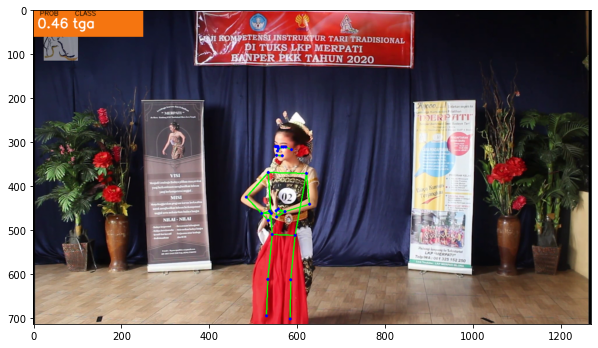

 57%|███████████████████████████████████████████▏                                | 1703/3000.0 [03:11<02:45,  7.81it/s]

tga [0.39 0.49 0.12]
tga [0.43 0.46 0.11]
tga [0.43 0.47 0.1 ]


 57%|███████████████████████████████████████████▏                                | 1707/3000.0 [03:11<02:16,  9.45it/s]

tga [0.41 0.49 0.1 ]
tga [0.42 0.46 0.12]
tga [0.36 0.5  0.14]



 57%|███████████████████████████████████████████▎                                | 1709/3000.0 [03:12<02:05, 10.26it/s]

tga [0.32 0.52 0.16]
tga [0.33 0.52 0.15]
tga [0.33 0.52 0.15]


 57%|███████████████████████████████████████████▍                                | 1713/3000.0 [03:12<01:56, 11.07it/s]

tga [0.37 0.5  0.13]
tga [0.36 0.51 0.13]
tga [0.33 0.52 0.15]



 57%|███████████████████████████████████████████▍                                | 1715/3000.0 [03:12<01:53, 11.31it/s]

tga [0.36 0.51 0.13]
tga [0.39 0.46 0.15]
tga [0.39 0.49 0.12]


 57%|███████████████████████████████████████████▌                                | 1719/3000.0 [03:12<01:48, 11.76it/s]

tg [0.44 0.44 0.12]
tga [0.41 0.49 0.1 ]
tg [0.47 0.41 0.12]



 57%|███████████████████████████████████████████▌                                | 1721/3000.0 [03:13<01:46, 12.02it/s]

tga [0.41 0.49 0.1 ]
tga [0.43 0.45 0.12]
tga [0.42 0.47 0.11]



 57%|███████████████████████████████████████████▋                                | 1723/3000.0 [03:13<01:50, 11.61it/s]

tga [0.43 0.46 0.11]
tga [0.43 0.48 0.09]
tga [0.39 0.49 0.12]


 58%|███████████████████████████████████████████▊                                | 1727/3000.0 [03:13<01:50, 11.50it/s]

tga [0.36 0.53 0.11]
tga [0.36 0.53 0.11]
tga [0.36 0.51 0.13]



 58%|███████████████████████████████████████████▊                                | 1729/3000.0 [03:13<01:51, 11.42it/s]

tga [0.33 0.55 0.12]
tga [0.38 0.52 0.1 ]
tga [0.43 0.46 0.11]


 58%|███████████████████████████████████████████▉                                | 1733/3000.0 [03:14<01:58, 10.74it/s]

tga [0.36 0.53 0.11]
tga [0.36 0.52 0.12]
tga [0.38 0.52 0.1 ]


 58%|████████████████████████████████████████████                                | 1737/3000.0 [03:14<01:55, 10.91it/s]

tga [0.37 0.5  0.13]
tga [0.34 0.52 0.14]
tga [0.29 0.57 0.14]



 58%|████████████████████████████████████████████                                | 1739/3000.0 [03:14<01:59, 10.59it/s]

tga [0.29 0.57 0.14]
tga [0.31 0.56 0.13]
tga [0.33 0.54 0.13]



 58%|████████████████████████████████████████████                                | 1741/3000.0 [03:14<02:02, 10.29it/s]

tga [0.36 0.52 0.12]
tga [0.34 0.53 0.13]



 58%|████████████████████████████████████████████▏                               | 1743/3000.0 [03:15<02:04, 10.12it/s]

tga [0.38 0.48 0.14]
tga [0.38 0.49 0.13]


 58%|████████████████████████████████████████████▏                               | 1746/3000.0 [03:15<02:19,  8.98it/s]

tga [0.43 0.44 0.13]
tga [0.36 0.5  0.14]
tga [0.41 0.48 0.11]


 58%|████████████████████████████████████████████▎                               | 1749/3000.0 [03:15<02:06,  9.85it/s]

tga [0.41 0.48 0.11]
tga [0.42 0.47 0.11]
tga [0.39 0.48 0.13]
tga [0.41 0.48 0.11]


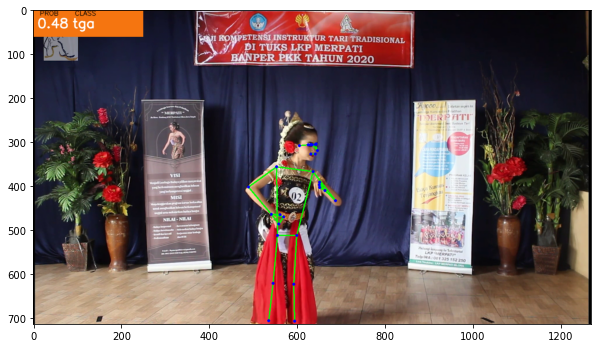

 58%|████████████████████████████████████████████▍                               | 1752/3000.0 [03:16<03:29,  5.94it/s]

tga [0.42 0.47 0.11]
tga [0.42 0.47 0.11]
tga [0.39 0.48 0.13]


 59%|████████████████████████████████████████████▍                               | 1756/3000.0 [03:16<02:33,  8.13it/s]

tga [0.39 0.47 0.14]
tga [0.37 0.48 0.15]
tga [0.37 0.49 0.14]


 59%|████████████████████████████████████████████▌                               | 1759/3000.0 [03:17<02:30,  8.22it/s]

tga [0.38 0.48 0.14]
tga [0.38 0.49 0.13]


 59%|████████████████████████████████████████████▌                               | 1761/3000.0 [03:17<02:27,  8.39it/s]

tga [0.39 0.48 0.13]
tga [0.39 0.47 0.14]


 59%|████████████████████████████████████████████▋                               | 1763/3000.0 [03:17<02:38,  7.78it/s]

tga [0.39 0.48 0.13]
tga [0.4  0.47 0.13]


 59%|████████████████████████████████████████████▋                               | 1765/3000.0 [03:18<02:27,  8.35it/s]

tga [0.42 0.46 0.12]
tga [0.42 0.46 0.12]


 59%|████████████████████████████████████████████▊                               | 1767/3000.0 [03:18<02:41,  7.65it/s]

tga [0.4  0.43 0.17]
tga [0.31 0.52 0.17]


 59%|████████████████████████████████████████████▊                               | 1769/3000.0 [03:18<02:54,  7.06it/s]

tga [0.29 0.54 0.17]
tga [0.28 0.58 0.14]



 59%|████████████████████████████████████████████▊                               | 1770/3000.0 [03:18<02:43,  7.51it/s]

tga [0.32 0.54 0.14]
tga [0.3  0.55 0.15]


 59%|████████████████████████████████████████████▉                               | 1773/3000.0 [03:19<02:29,  8.22it/s]

tga [0.31 0.53 0.16]
tga [0.33 0.51 0.16]



 59%|████████████████████████████████████████████▉                               | 1775/3000.0 [03:19<02:11,  9.30it/s]

tga [0.33 0.52 0.15]
tga [0.24 0.61 0.15]
tga [0.32 0.5  0.18]


 59%|█████████████████████████████████████████████                               | 1779/3000.0 [03:19<01:52, 10.86it/s]

tga [0.3  0.47 0.23]
tga [0.34 0.41 0.25]
tga [0.35 0.4  0.25]



 59%|█████████████████████████████████████████████                               | 1781/3000.0 [03:19<01:48, 11.19it/s]

tg [0.37 0.36 0.27]
tga [0.37 0.49 0.14]
tga [0.36 0.48 0.16]


 60%|█████████████████████████████████████████████▏                              | 1785/3000.0 [03:20<01:41, 12.02it/s]

tga [0.38 0.46 0.16]
tga [0.33 0.49 0.18]
tga [0.39 0.47 0.14]



 60%|█████████████████████████████████████████████▎                              | 1787/3000.0 [03:20<01:41, 11.92it/s]

tga [0.39 0.44 0.17]
tga [0.36 0.47 0.17]



 60%|█████████████████████████████████████████████▎                              | 1789/3000.0 [03:20<01:52, 10.79it/s]

tga [0.39 0.47 0.14]
tga [0.32 0.49 0.19]



 60%|█████████████████████████████████████████████▎                              | 1791/3000.0 [03:20<01:51, 10.87it/s]

tga [0.33 0.45 0.22]
tga [0.31 0.54 0.15]
tga [0.31 0.46 0.23]



 60%|█████████████████████████████████████████████▍                              | 1793/3000.0 [03:20<01:50, 10.96it/s]

tga [0.26 0.53 0.21]
tga [0.32 0.54 0.14]
tga [0.29 0.57 0.14]


 60%|█████████████████████████████████████████████▌                              | 1797/3000.0 [03:21<01:51, 10.82it/s]

tga [0.28 0.53 0.19]
tga [0.28 0.49 0.23]
tga 


 60%|█████████████████████████████████████████████▌                              | 1799/3000.0 [03:21<01:49, 10.92it/s]

[0.31 0.47 0.22]
tga [0.32 0.48 0.2 ]
tga [0.31 0.49 0.2 ]
tga [0.32 0.45 0.23]


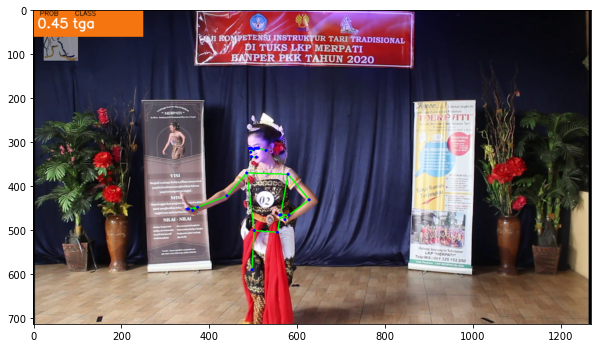

 60%|█████████████████████████████████████████████▋                              | 1803/3000.0 [03:22<02:33,  7.80it/s]

tga [0.31 0.48 0.21]
tga [0.33 0.45 0.22]
tga [0.32 0.5  0.18]



 60%|█████████████████████████████████████████████▋                              | 1805/3000.0 [03:22<02:18,  8.65it/s]

tga [0.35 0.5  0.15]
tga [0.36 0.51 0.13]
tga [0.4 0.5 0.1]


 60%|█████████████████████████████████████████████▊                              | 1809/3000.0 [03:22<02:00,  9.86it/s]

tga [0.41 0.48 0.11]
tga [0.42 0.46 0.12]
tga [0.43 0.46 0.11]


 60%|█████████████████████████████████████████████▉                              | 1813/3000.0 [03:23<02:00,  9.83it/s]

tga [0.36 0.48 0.16]
tga [0.36 0.5  0.14]
tga [0.39 0.48 0.13]



 60%|█████████████████████████████████████████████▉                              | 1815/3000.0 [03:23<02:07,  9.26it/s]

tga [0.36 0.5  0.14]
tga [0.33 0.54 0.13]


 61%|██████████████████████████████████████████████                              | 1817/3000.0 [03:23<02:10,  9.05it/s]

tga [0.4  0.49 0.11]
tga [0.41 0.48 0.11]
tga [0.39 0.49 0.12]


 61%|██████████████████████████████████████████████▏                             | 1821/3000.0 [03:23<01:48, 10.86it/s]

tga [0.38 0.5  0.12]
tga [0.39 0.49 0.12]
tga [0.37 0.49 0.14]



 61%|██████████████████████████████████████████████▏                             | 1823/3000.0 [03:23<01:46, 11.03it/s]

tga [0.35 0.52 0.13]
tga [0.34 0.53 0.13]
tga [0.4  0.48 0.12]



 61%|██████████████████████████████████████████████▏                             | 1825/3000.0 [03:24<01:49, 10.69it/s]

tga [0.39 0.49 0.12]
tga [0.39 0.48 0.13]


 61%|██████████████████████████████████████████████▎                             | 1828/3000.0 [03:24<02:20,  8.33it/s]

tga [0.41 0.48 0.11]
tga [0.41 0.48 0.11]


 61%|██████████████████████████████████████████████▎                             | 1830/3000.0 [03:24<02:28,  7.90it/s]

tga [0.4  0.49 0.11]
tga [0.39 0.49 0.12]


 61%|██████████████████████████████████████████████▍                             | 1832/3000.0 [03:25<02:31,  7.73it/s]

tga [0.39 0.48 0.13]
tga [0.41 0.46 0.13]



 61%|██████████████████████████████████████████████▍                             | 1834/3000.0 [03:25<02:12,  8.82it/s]

tga [0.4  0.45 0.15]
tga [0.41 0.46 0.13]
tga [0.41 0.47 0.12]


 61%|██████████████████████████████████████████████▌                             | 1837/3000.0 [03:25<02:16,  8.49it/s]

tga [0.44 0.45 0.11]
tg [0.46 0.43 0.11]


 61%|██████████████████████████████████████████████▌                             | 1839/3000.0 [03:26<02:21,  8.19it/s]

tg [0.47 0.42 0.11]
tg [0.45 0.44 0.11]
tg [0.45 0.42 0.13]



 61%|██████████████████████████████████████████████▋                             | 1841/3000.0 [03:26<02:01,  9.56it/s]

tg [0.47 0.4  0.13]
tg [0.48 0.39 0.13]
tg 

 62%|██████████████████████████████████████████████▋                             | 1845/3000.0 [03:26<01:48, 10.65it/s]

[0.48 0.38 0.14]
tg [0.49 0.38 0.13]
tg [0.48 0.39 0.13]



 62%|██████████████████████████████████████████████▊                             | 1847/3000.0 [03:26<02:08,  8.94it/s]

tg [0.49 0.39 0.12]
tg [0.47 0.39 0.14]


 62%|██████████████████████████████████████████████▊                             | 1850/3000.0 [03:27<01:59,  9.65it/s]

tg [0.47 0.4  0.13]
tg [0.5  0.38 0.12]
tg [0.49 0.39 0.12]
tg [0.45 0.43 0.12]


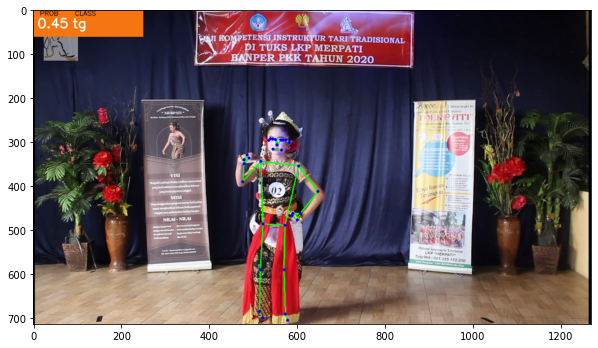

 62%|██████████████████████████████████████████████▉                             | 1854/3000.0 [03:27<02:22,  8.04it/s]

tg [0.47 0.42 0.11]
tg [0.46 0.42 0.12]
tg [0.49 0.41 0.1 ]



 62%|███████████████████████████████████████████████                             | 1856/3000.0 [03:27<02:03,  9.27it/s]

tg [0.49 0.4  0.11]
tg [0.51 0.4  0.09]
tg [0.46 0.43 0.11]


 62%|███████████████████████████████████████████████                             | 1860/3000.0 [03:28<01:41, 11.19it/s]

tg [0.47 0.41 0.12]
tg [0.47 0.41 0.12]
tg [0.48 0.4  0.12]



 62%|███████████████████████████████████████████████▏                            | 1862/3000.0 [03:28<01:38, 11.51it/s]

tg [0.48 0.41 0.11]
tg [0.49 0.4  0.11]
tg [0.48 0.38 0.14]


 62%|███████████████████████████████████████████████▎                            | 1866/3000.0 [03:28<01:31, 12.41it/s]

tg [0.49 0.39 0.12]
tg [0.48 0.39 0.13]
tg [0.46 0.4  0.14]



 62%|███████████████████████████████████████████████▎                            | 1868/3000.0 [03:28<01:31, 12.41it/s]

tg [0.48 0.41 0.11]
tg [0.48 0.39 0.13]
tg [0.52 0.37 0.11]


 62%|███████████████████████████████████████████████▍                            | 1872/3000.0 [03:29<01:30, 12.43it/s]

tg [0.52 0.37 0.11]
tg [0.5  0.38 0.12]
tg [0.5  0.37 0.13]



 62%|███████████████████████████████████████████████▍                            | 1874/3000.0 [03:29<01:31, 12.27it/s]

tg [0.5  0.37 0.13]
tg [0.53 0.34 0.13]
tg [0.51 0.37 0.12]


 63%|███████████████████████████████████████████████▌                            | 1878/3000.0 [03:29<01:28, 12.64it/s]

tg [0.53 0.36 0.11]
tg [0.51 0.37 0.12]
tg [0.5  0.38 0.12]



 63%|███████████████████████████████████████████████▋                            | 1880/3000.0 [03:29<01:26, 12.89it/s]

tg [0.5  0.39 0.11]
tg [0.52 0.36 0.12]
tg [0.51 0.38 0.11]


 63%|███████████████████████████████████████████████▋                            | 1884/3000.0 [03:30<01:27, 12.74it/s]

tg [0.52 0.36 0.12]
tg [0.53 0.36 0.11]
tg [0.53 0.36 0.11]



 63%|███████████████████████████████████████████████▊                            | 1886/3000.0 [03:30<01:28, 12.55it/s]

tg [0.53 0.36 0.11]
tg [0.52 0.36 0.12]
tg [0.51 0.35 0.14]


 63%|███████████████████████████████████████████████▉                            | 1890/3000.0 [03:30<01:27, 12.69it/s]

tg [0.49 0.37 0.14]
tg [0.51 0.37 0.12]
tg [0.5  0.38 0.12]



 63%|███████████████████████████████████████████████▉                            | 1892/3000.0 [03:30<01:28, 12.54it/s]

tg [0.51 0.38 0.11]
tg [0.51 0.38 0.11]
tg [0.51 0.38 0.11]


 63%|████████████████████████████████████████████████                            | 1896/3000.0 [03:31<01:27, 12.64it/s]

tg [0.51 0.38 0.11]
tg [0.5  0.39 0.11]
tg [0.47 0.4  0.13]



 63%|████████████████████████████████████████████████                            | 1898/3000.0 [03:31<01:27, 12.60it/s]

tg [0.45 0.39 0.16]
tg [0.44 0.42 0.14]
tg [0.45 0.41 0.14]



 63%|████████████████████████████████████████████████▏                           | 1900/3000.0 [03:31<01:28, 12.48it/s]

tg [0.46 0.41 0.13]
tg [0.46 0.42 0.12]


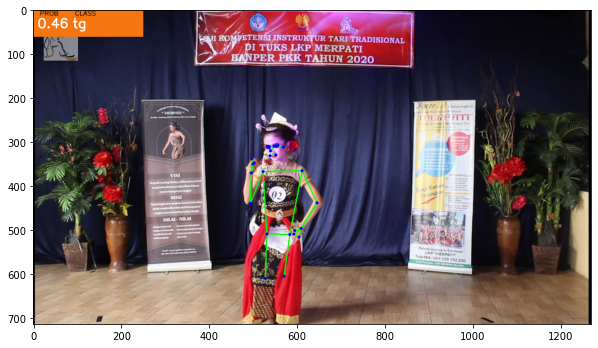


 63%|████████████████████████████████████████████████▏                           | 1902/3000.0 [03:32<02:38,  6.92it/s]

tg [0.46 0.4  0.14]
tg 

 63%|████████████████████████████████████████████████▏                           | 1904/3000.0 [03:32<02:39,  6.88it/s]

[0.45 0.39 0.16]
tga [0.34 0.45 0.21]


 64%|████████████████████████████████████████████████▎                           | 1906/3000.0 [03:32<02:22,  7.67it/s]

tga [0.3  0.53 0.17]
tga [0.28 0.53 0.19]
tga [0.29 0.52 0.19]


 64%|████████████████████████████████████████████████▎                           | 1909/3000.0 [03:32<02:04,  8.73it/s]

tga [0.28 0.52 0.2 ]
tga [0.32 0.53 0.15]


 64%|████████████████████████████████████████████████▍                           | 1911/3000.0 [03:33<02:04,  8.76it/s]

tga [0.31 0.55 0.14]
tga [0.41 0.44 0.15]


 64%|████████████████████████████████████████████████▍                           | 1913/3000.0 [03:33<01:59,  9.06it/s]

tga [0.37 0.48 0.15]
tga [0.37 0.47 0.16]


 64%|████████████████████████████████████████████████▌                           | 1915/3000.0 [03:33<02:03,  8.76it/s]

tga [0.36 0.52 0.12]
tga [0.35 0.53 0.12]


 64%|████████████████████████████████████████████████▌                           | 1917/3000.0 [03:33<02:01,  8.94it/s]

tga [0.36 0.51 0.13]
tga [0.36 0.5  0.14]



 64%|████████████████████████████████████████████████▌                           | 1918/3000.0 [03:33<02:03,  8.73it/s]

tga [0.36 0.51 0.13]
tga [0.39 0.49 0.12]
tga [0.37 0.5  0.13]


 64%|████████████████████████████████████████████████▋                           | 1922/3000.0 [03:34<01:40, 10.73it/s]

tga [0.37 0.49 0.14]
tga [0.4  0.48 0.12]
tga [0.38 0.49 0.13]


 64%|████████████████████████████████████████████████▊                           | 1926/3000.0 [03:34<01:30, 11.83it/s]

tga [0.36 0.49 0.15]
tga [0.33 0.52 0.15]
tga [0.37 0.51 0.12]



 64%|████████████████████████████████████████████████▊                           | 1928/3000.0 [03:34<01:28, 12.16it/s]

tga [0.33 0.54 0.13]
tga [0.36 0.51 0.13]
tga [0.4  0.48 0.12]


 64%|████████████████████████████████████████████████▉                           | 1932/3000.0 [03:34<01:27, 12.25it/s]

tga [0.37 0.47 0.16]
tga [0.34 0.52 0.14]
tga [0.28 0.58 0.14]



 64%|████████████████████████████████████████████████▉                           | 1934/3000.0 [03:35<01:26, 12.28it/s]

tga [0.28 0.59 0.13]
tga [0.29 0.59 0.12]
tga [0.31 0.6  0.09]


 65%|█████████████████████████████████████████████████                           | 1938/3000.0 [03:35<01:29, 11.86it/s]

tga [0.33 0.55 0.12]
tga [0.34 0.54 0.12]
tga [0.4  0.48 0.12]



 65%|█████████████████████████████████████████████████▏                          | 1940/3000.0 [03:35<01:29, 11.87it/s]

tga [0.45 0.47 0.08]
tga [0.4  0.52 0.08]
tg [0.5  0.36 0.14]


 65%|█████████████████████████████████████████████████▏                          | 1944/3000.0 [03:35<01:28, 11.99it/s]

tg [0.5  0.47 0.03]
tg [0.51 0.4  0.09]
tg [0.47 0.45 0.08]



 65%|█████████████████████████████████████████████████▎                          | 1946/3000.0 [03:36<01:27, 12.01it/s]

tg [0.51 0.39 0.1 ]
tg [0.54 0.39 0.07]
tg [0.54 0.4  0.06]


 65%|█████████████████████████████████████████████████▍                          | 1950/3000.0 [03:36<01:27, 12.02it/s]

tg [0.53 0.39 0.08]
tg [0.47 0.41 0.12]
tg [0.52 0.39 0.09]
tg [0.53 0.4  0.07]


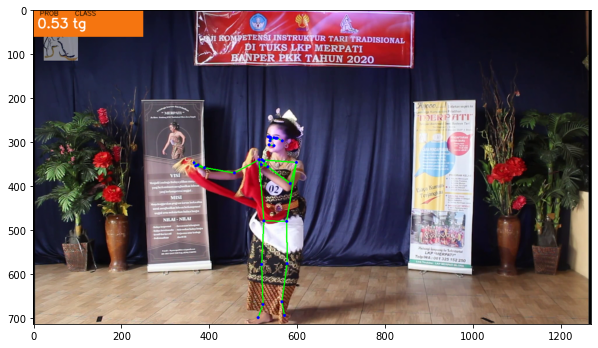

 65%|█████████████████████████████████████████████████▍                          | 1953/3000.0 [03:37<02:36,  6.70it/s]

tg [0.51 0.41 0.08]
tg [0.52 0.4  0.08]


 65%|█████████████████████████████████████████████████▌                          | 1956/3000.0 [03:37<02:11,  7.92it/s]

tg [0.5 0.4 0.1]
tg [0.52 0.4  0.08]
tg [0.56 0.38 0.06]


 65%|█████████████████████████████████████████████████▌                          | 1958/3000.0 [03:37<02:15,  7.70it/s]

tg [0.52 0.41 0.07]
tg [0.53 0.37 0.1 ]



 65%|█████████████████████████████████████████████████▋                          | 1959/3000.0 [03:37<02:12,  7.86it/s]

tg [0.49 0.4  0.11]
tg [0.49 0.4  0.11]
tg [0.5 0.4 0.1]


 65%|█████████████████████████████████████████████████▋                          | 1963/3000.0 [03:38<01:45,  9.79it/s]

tg [0.48 0.42 0.1 ]
tg [0.46 0.4  0.14]
tg [0.46 0.41 0.13]



 66%|█████████████████████████████████████████████████▊                          | 1965/3000.0 [03:38<01:41, 10.23it/s]

tg [0.5  0.39 0.11]
tg [0.53 0.36 0.11]


 66%|█████████████████████████████████████████████████▊                          | 1968/3000.0 [03:38<01:57,  8.78it/s]

tg [0.5  0.42 0.08]
tg [0.5  0.42 0.08]


 66%|█████████████████████████████████████████████████▉                          | 1970/3000.0 [03:39<02:11,  7.84it/s]

tg [0.49 0.42 0.09]
tg [0.52 0.38 0.1 ]


 66%|█████████████████████████████████████████████████▉                          | 1972/3000.0 [03:39<02:19,  7.38it/s]

tg [0.49 0.41 0.1 ]
tg [0.51 0.42 0.07]



 66%|█████████████████████████████████████████████████▉                          | 1973/3000.0 [03:39<02:15,  7.57it/s]

tg [0.46 0.4  0.14]
tg [0.45 0.42 0.13]
tg [0.47 0.36 0.17]


 66%|██████████████████████████████████████████████████                          | 1976/3000.0 [03:39<01:59,  8.57it/s]

tga [0.41 0.42 0.17]
tga [0.4  0.41 0.19]
tg

 66%|██████████████████████████████████████████████████▏                         | 1979/3000.0 [03:40<01:53,  9.03it/s]

 [0.5  0.35 0.15]
tg [0.52 0.33 0.15]


 66%|██████████████████████████████████████████████████▏                         | 1981/3000.0 [03:40<01:59,  8.55it/s]

tg [0.5  0.36 0.14]
tg [0.51 0.37 0.12]



 66%|██████████████████████████████████████████████████▏                         | 1983/3000.0 [03:40<01:52,  9.01it/s]

tg [0.54 0.36 0.1 ]
tg [0.51 0.35 0.14]


 66%|██████████████████████████████████████████████████▎                         | 1985/3000.0 [03:40<01:54,  8.83it/s]

tg [0.51 0.35 0.14]
tg [0.52 0.36 0.12]


 66%|██████████████████████████████████████████████████▎                         | 1987/3000.0 [03:41<01:55,  8.80it/s]

tg [0.55 0.36 0.09]
tg [0.58 0.37 0.05]


 66%|██████████████████████████████████████████████████▍                         | 1989/3000.0 [03:41<01:54,  8.80it/s]

tg [0.56 0.38 0.06]
tg [0.51 0.43 0.06]



 66%|██████████████████████████████████████████████████▍                         | 1990/3000.0 [03:41<01:55,  8.77it/s]

tg [0.51 0.43 0.06]
tg [0.51 0.42 0.07]
tg 

 66%|██████████████████████████████████████████████████▍                         | 1993/3000.0 [03:41<01:52,  8.96it/s]

[0.52 0.42 0.06]
tg [0.51 0.41 0.08]


 66%|██████████████████████████████████████████████████▌                         | 1995/3000.0 [03:42<02:03,  8.11it/s]

tg [0.49 0.42 0.09]
tg [0.47 0.42 0.11]



 67%|██████████████████████████████████████████████████▌                         | 1997/3000.0 [03:42<01:50,  9.08it/s]

tga [0.43 0.47 0.1 ]
tg [0.47 0.43 0.1 ]
tga [0.42 0.48 0.1 ]



 67%|██████████████████████████████████████████████████▋                         | 1999/3000.0 [03:42<01:41,  9.82it/s]

tga [0.43 0.45 0.12]
tg [0.47 0.44 0.09]
tga [0.46 0.48 0.06]


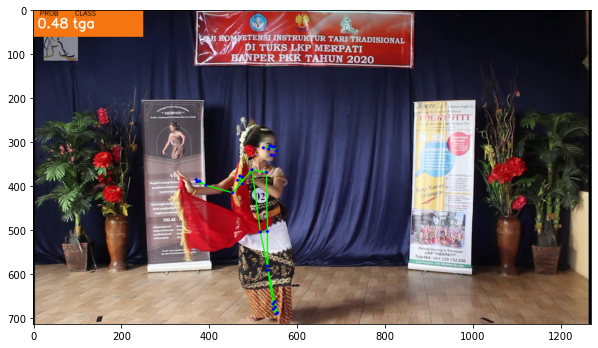

 67%|██████████████████████████████████████████████████▋                         | 2003/3000.0 [03:43<02:09,  7.67it/s]

tg [0.45 0.45 0.1 ]
tga [0.45 0.46 0.09]
tga [0.45 0.46 0.09]


 67%|██████████████████████████████████████████████████▊                         | 2007/3000.0 [03:43<01:45,  9.38it/s]

tga [0.45 0.46 0.09]
tga [0.46 0.49 0.05]
tga [0.45 0.46 0.09]



 67%|██████████████████████████████████████████████████▉                         | 2009/3000.0 [03:43<01:37, 10.14it/s]

tga [0.45 0.46 0.09]
tg [0.48 0.44 0.08]
tg [0.49 0.43 0.08]


 67%|██████████████████████████████████████████████████▉                         | 2013/3000.0 [03:43<01:29, 11.02it/s]

tg [0.47 0.47 0.06]
tg [0.51 0.4  0.09]
tg [0.51 0.4  0.09]



 67%|███████████████████████████████████████████████████                         | 2015/3000.0 [03:44<01:25, 11.48it/s]

tg [0.51 0.39 0.1 ]
tg [0.51 0.4  0.09]
tg [0.53 0.4  0.07]


 67%|███████████████████████████████████████████████████▏                        | 2019/3000.0 [03:44<01:23, 11.70it/s]

tg [0.48 0.43 0.09]
tga [0.43 0.47 0.1 ]
tga [0.44 0.46 0.1 ]



 67%|███████████████████████████████████████████████████▏                        | 2021/3000.0 [03:44<01:23, 11.78it/s]

tg [0.46 0.45 0.09]
tga [0.43 0.45 0.12]
tga [0.44 0.47 0.09]


 68%|███████████████████████████████████████████████████▎                        | 2025/3000.0 [03:44<01:21, 11.97it/s]

tga [0.45 0.46 0.09]
tg [0.46 0.46 0.08]
tg [0.46 0.46 0.08]



 68%|███████████████████████████████████████████████████▎                        | 2027/3000.0 [03:45<01:19, 12.21it/s]

tga [0.42 0.47 0.11]
tga [0.45 0.47 0.08]
tg [0.45 0.45 0.1 ]


 68%|███████████████████████████████████████████████████▍                        | 2031/3000.0 [03:45<01:18, 12.29it/s]

tga [0.44 0.46 0.1 ]
tga [0.41 0.49 0.1 ]
tga [0.46 0.47 0.07]



 68%|███████████████████████████████████████████████████▌                        | 2033/3000.0 [03:45<01:18, 12.37it/s]

tga [0.44 0.46 0.1 ]
tg [0.46 0.45 0.09]
tg [0.5 0.4 0.1]


 68%|███████████████████████████████████████████████████▌                        | 2037/3000.0 [03:45<01:17, 12.44it/s]

tg [0.51 0.39 0.1 ]
tg [0.52 0.39 0.09]
tg [0.5  0.41 0.09]



 68%|███████████████████████████████████████████████████▋                        | 2039/3000.0 [03:46<01:19, 12.03it/s]

tga [0.45 0.46 0.09]
tga [0.44 0.46 0.1 ]
tga [0.44 0.49 0.07]


 68%|███████████████████████████████████████████████████▊                        | 2043/3000.0 [03:46<01:20, 11.93it/s]

tg [0.46 0.46 0.08]
tg [0.47 0.45 0.08]
tg [0.47 0.45 0.08]



 68%|███████████████████████████████████████████████████▊                        | 2045/3000.0 [03:46<01:18, 12.09it/s]

tga [0.45 0.46 0.09]
tg [0.46 0.43 0.11]
tga [0.44 0.45 0.11]


 68%|███████████████████████████████████████████████████▉                        | 2049/3000.0 [03:46<01:19, 12.01it/s]

tga [0.42 0.49 0.09]
tga [0.4  0.51 0.09]
tg [0.46 0.44 0.1 ]
tg [0.52 0.41 0.07]
tg [0.53 0.41 0.06]


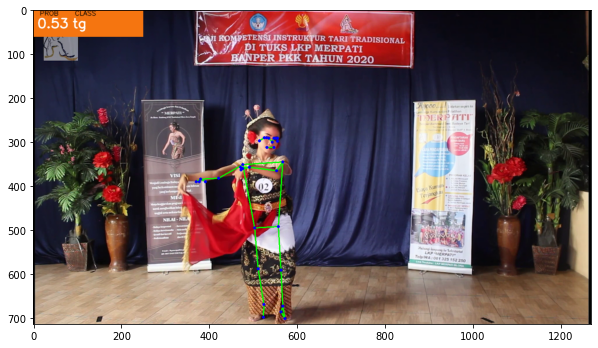

 68%|████████████████████████████████████████████████████                        | 2054/3000.0 [03:47<01:45,  8.99it/s]

tg [0.5  0.41 0.09]
tg [0.5 0.4 0.1]
tg [0.44 0.44 0.12]



 69%|████████████████████████████████████████████████████                        | 2056/3000.0 [03:47<01:35,  9.85it/s]

tg [0.47 0.42 0.11]
tg [0.49 0.42 0.09]
tg [0.53 0.39 0.08]


 69%|████████████████████████████████████████████████████▏                       | 2060/3000.0 [03:48<01:23, 11.31it/s]

tg [0.55 0.38 0.07]
tg [0.47 0.43 0.1 ]
tg [0.52 0.4  0.08]



 69%|████████████████████████████████████████████████████▏                       | 2062/3000.0 [03:48<01:20, 11.65it/s]

tg [0.47 0.44 0.09]
tg [0.49 0.4  0.11]
tg [0.51 0.38 0.11]


 69%|████████████████████████████████████████████████████▎                       | 2066/3000.0 [03:48<01:16, 12.24it/s]

tg [0.49 0.4  0.11]
tg [0.44 0.43 0.13]
tg [0.44 0.4  0.16]



 69%|████████████████████████████████████████████████████▍                       | 2068/3000.0 [03:48<01:15, 12.41it/s]

tg [0.53 0.37 0.1 ]
tg [0.48 0.37 0.15]
tg [0.51 0.37 0.12]


 69%|████████████████████████████████████████████████████▍                       | 2072/3000.0 [03:49<01:13, 12.71it/s]

tg [0.51 0.37 0.12]
tg [0.53 0.36 0.11]
tg [0.52 0.37 0.11]



 69%|████████████████████████████████████████████████████▌                       | 2074/3000.0 [03:49<01:11, 12.87it/s]

tg [0.5 0.4 0.1]
tg [0.53 0.38 0.09]
tg [0.51 0.39 0.1 ]


 69%|████████████████████████████████████████████████████▋                       | 2078/3000.0 [03:49<01:11, 12.84it/s]

tg [0.51 0.39 0.1 ]
tg [0.46 0.42 0.12]
tg [0.45 0.45 0.1 ]



 69%|████████████████████████████████████████████████████▋                       | 2080/3000.0 [03:49<01:12, 12.69it/s]

tg [0.46 0.43 0.11]
tg [0.49 0.4  0.11]
tg [0.53 0.38 0.09]


 69%|████████████████████████████████████████████████████▊                       | 2084/3000.0 [03:50<01:11, 12.80it/s]

tg [0.52 0.4  0.08]
tg [0.47 0.41 0.12]
tg [0.49 0.41 0.1 ]



 70%|████████████████████████████████████████████████████▊                       | 2086/3000.0 [03:50<01:10, 12.91it/s]

tg [0.47 0.42 0.11]
tg [0.5 0.4 0.1]
tg [0.51 0.4  0.09]


 70%|████████████████████████████████████████████████████▉                       | 2090/3000.0 [03:50<01:13, 12.32it/s]

tg [0.5  0.43 0.07]
tg [0.51 0.41 0.08]
tg [0.47 0.42 0.11]



 70%|████████████████████████████████████████████████████▉                       | 2092/3000.0 [03:50<01:17, 11.72it/s]

tg [0.49 0.41 0.1 ]
tg [0.54 0.38 0.08]
tg [0.52 0.39 0.09]


 70%|█████████████████████████████████████████████████████                       | 2096/3000.0 [03:51<01:16, 11.83it/s]

tg [0.5  0.42 0.08]
tg [0.5  0.39 0.11]
tg [0.5 0.4 0.1]



 70%|█████████████████████████████████████████████████████▏                      | 2098/3000.0 [03:51<01:15, 12.03it/s]

tg [0.51 0.41 0.08]
tg [0.5  0.42 0.08]
tg [0.49 0.43 0.08]



 70%|█████████████████████████████████████████████████████▏                      | 2100/3000.0 [03:51<01:16, 11.82it/s]

tg [0.46 0.45 0.09]
tg [0.47 0.42 0.11]


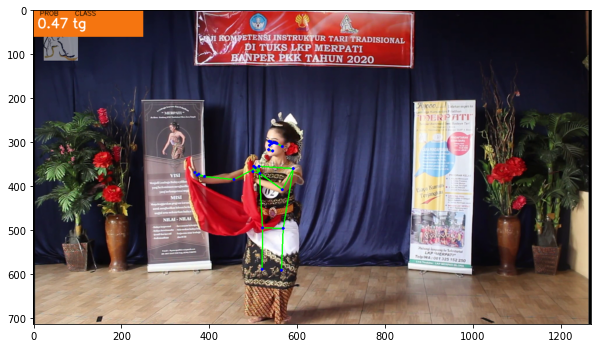

 70%|█████████████████████████████████████████████████████▎                      | 2104/3000.0 [03:52<01:54,  7.83it/s]

tg [0.45 0.43 0.12]
tg [0.45 0.44 0.11]
tga [0.44 0.45 0.11]



 70%|█████████████████████████████████████████████████████▎                      | 2106/3000.0 [03:52<01:47,  8.32it/s]

tg [0.45 0.43 0.12]
tg [0.47 0.43 0.1 ]
tg 


 70%|█████████████████████████████████████████████████████▍                      | 2108/3000.0 [03:52<01:35,  9.30it/s]

[0.46 0.44 0.1 ]
tg [0.51 0.39 0.1 ]
tg [0.48 0.41 0.11]


 70%|█████████████████████████████████████████████████████▌                      | 2112/3000.0 [03:52<01:26, 10.23it/s]

tg [0.48 0.41 0.11]
tg [0.47 0.44 0.09]
tga [0.36 0.51 0.13]



 70%|█████████████████████████████████████████████████████▌                      | 2114/3000.0 [03:52<01:23, 10.60it/s]

tga [0.4  0.46 0.14]
tg [0.5  0.41 0.09]
tg [0.43 0.4  0.17]


 71%|█████████████████████████████████████████████████████▋                      | 2118/3000.0 [03:53<01:19, 11.06it/s]

tg [0.56 0.36 0.08]
tg [0.5  0.37 0.13]
tg [0.55 0.31 0.14]



 71%|█████████████████████████████████████████████████████▋                      | 2120/3000.0 [03:53<01:18, 11.15it/s]

tg [0.49 0.38 0.13]
tg [0.48 0.36 0.16]
tg [0.55 0.39 0.06]


 71%|█████████████████████████████████████████████████████▊                      | 2124/3000.0 [03:53<01:16, 11.49it/s]

tg [0.51 0.38 0.11]
tg [0.51 0.42 0.07]
tg [0.48 0.44 0.08]



 71%|█████████████████████████████████████████████████████▊                      | 2126/3000.0 [03:54<01:16, 11.47it/s]

tg [0.46 0.45 0.09]
tg [0.52 0.39 0.09]
tg [0.47 0.44 0.09]


 71%|█████████████████████████████████████████████████████▉                      | 2130/3000.0 [03:54<01:12, 12.05it/s]

tg [0.46 0.45 0.09]
tg [0.48 0.44 0.08]
tg [0.49 0.4  0.11]



 71%|██████████████████████████████████████████████████████                      | 2132/3000.0 [03:54<01:10, 12.27it/s]

tg [0.45 0.41 0.14]
tg [0.47 0.43 0.1 ]
tg [0.46 0.42 0.12]



 71%|██████████████████████████████████████████████████████                      | 2134/3000.0 [03:54<01:14, 11.61it/s]

tg [0.46 0.42 0.12]
tg [0.45 0.44 0.11]
tg [0.47 0.43 0.1 ]

 71%|██████████████████████████████████████████████████████▏                     | 2138/3000.0 [03:55<01:16, 11.34it/s]


tg [0.46 0.44 0.1 ]
tg [0.47 0.44 0.09]



 71%|██████████████████████████████████████████████████████▏                     | 2140/3000.0 [03:55<01:15, 11.42it/s]

tg [0.46 0.46 0.08]
tga [0.45 0.47 0.08]
tg [0.46 0.46 0.08]



 71%|██████████████████████████████████████████████████████▎                     | 2142/3000.0 [03:55<01:22, 10.42it/s]

tg [0.47 0.45 0.08]
tg [0.46 0.44 0.1 ]



 71%|██████████████████████████████████████████████████████▎                     | 2144/3000.0 [03:55<01:25, 10.04it/s]

tg [0.46 0.43 0.11]
tg [0.47 0.42 0.11]
tg [0.47 0.41 0.12]


 72%|██████████████████████████████████████████████████████▍                     | 2148/3000.0 [03:56<01:29,  9.53it/s]

tg [0.47 0.41 0.12]
tg [0.47 0.41 0.12]



 72%|██████████████████████████████████████████████████████▍                     | 2149/3000.0 [03:56<01:47,  7.92it/s]

tg [0.49 0.39 0.12]
tg [0.47 0.43 0.1 ]



 72%|██████████████████████████████████████████████████████▍                     | 2150/3000.0 [03:56<01:58,  7.18it/s]

tg [0.45 0.43 0.12]


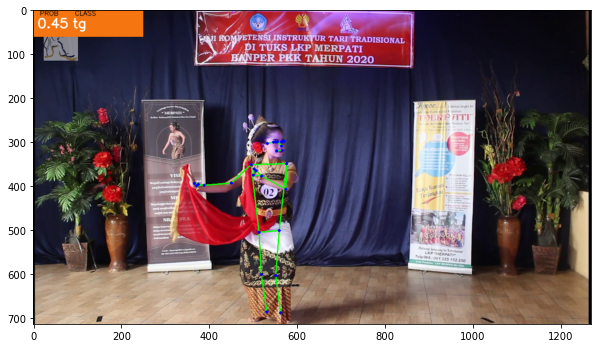

 72%|██████████████████████████████████████████████████████▌                     | 2153/3000.0 [03:57<02:34,  5.49it/s]

tg [0.45 0.44 0.11]
tg [0.46 0.44 0.1 ]
tg [0.46 0.44 0.1 ]



 72%|██████████████████████████████████████████████████████▌                     | 2155/3000.0 [03:57<02:09,  6.55it/s]

tg [0.45 0.45 0.1 ]
tg [0.46 0.44 0.1 ]
tg 


 72%|██████████████████████████████████████████████████████▋                     | 2157/3000.0 [03:57<01:52,  7.53it/s]

[0.52 0.37 0.11]
tg [0.48 0.43 0.09]
tg [0.46 0.45 0.09]


 72%|██████████████████████████████████████████████████████▋                     | 2160/3000.0 [03:57<01:38,  8.51it/s]

tg [0.48 0.41 0.11]
tg [0.48 0.42 0.1 ]
tg [0.47 0.43 0.1 ]


 72%|██████████████████████████████████████████████████████▊                     | 2164/3000.0 [03:58<01:26,  9.67it/s]

tg [0.46 0.45 0.09]
tga [0.44 0.46 0.1 ]
tga [0.43 0.47 0.1 ]



 72%|██████████████████████████████████████████████████████▊                     | 2166/3000.0 [03:58<01:21, 10.30it/s]

tga [0.43 0.47 0.1 ]
tga [0.43 0.47 0.1 ]



 72%|██████████████████████████████████████████████████████▉                     | 2168/3000.0 [03:58<01:40,  8.24it/s]

tg [0.45 0.45 0.1 ]



 72%|██████████████████████████████████████████████████████▉                     | 2169/3000.0 [03:59<01:59,  6.96it/s]

tg [0.47 0.44 0.09]


 72%|██████████████████████████████████████████████████████▉                     | 2171/3000.0 [03:59<02:07,  6.49it/s]

tg [0.49 0.42 0.09]
tg [0.49 0.42 0.09]


 72%|███████████████████████████████████████████████████████                     | 2174/3000.0 [03:59<01:39,  8.33it/s]

tg [0.5  0.41 0.09]
tg [0.48 0.42 0.1 ]
tg [0.49 0.41 0.1 ]



 73%|███████████████████████████████████████████████████████▏                    | 2176/3000.0 [03:59<01:29,  9.20it/s]

tg [0.49 0.41 0.1 ]
tg [0.46 0.43 0.11]
tg [0.49 0.42 0.09]



 73%|███████████████████████████████████████████████████████▏                    | 2178/3000.0 [04:00<01:23,  9.80it/s]

tg [0.45 0.45 0.1 ]
tg [0.48 0.44 0.08]
tga [0.44 0.47 0.09]


 73%|███████████████████████████████████████████████████████▎                    | 2182/3000.0 [04:00<01:23,  9.79it/s]

tg [0.47 0.43 0.1 ]
tg [0.47 0.43 0.1 ]
tg [0.46 0.44 0.1 ]


 73%|███████████████████████████████████████████████████████▍                    | 2186/3000.0 [04:00<01:16, 10.60it/s]

tga [0.45 0.46 0.09]
tg [0.48 0.42 0.1 ]
tga [0.45 0.46 0.09]



 73%|███████████████████████████████████████████████████████▍                    | 2188/3000.0 [04:01<01:16, 10.68it/s]

tg [0.47 0.44 0.09]
tg [0.5 0.4 0.1]
tg [0.49 0.43 0.08]



 73%|███████████████████████████████████████████████████████▍                    | 2190/3000.0 [04:01<01:18, 10.36it/s]

tg [0.45 0.45 0.1 ]
tg [0.49 0.41 0.1 ]
tg [0.49 0.41 0.1 ]


 73%|███████████████████████████████████████████████████████▌                    | 2194/3000.0 [04:01<01:25,  9.39it/s]

tg [0.51 0.39 0.1 ]
tg [0.48 0.39 0.13]



 73%|███████████████████████████████████████████████████████▋                    | 2196/3000.0 [04:01<01:24,  9.51it/s]

tg [0.48 0.42 0.1 ]
tg [0.48 0.43 0.09]


 73%|███████████████████████████████████████████████████████▋                    | 2198/3000.0 [04:02<01:25,  9.34it/s]

tg [0.45 0.41 0.14]
tg [0.44 0.4  0.16]
tg [0.4  0.26 0.34]


 73%|███████████████████████████████████████████████████████▋                    | 2200/3000.0 [04:02<01:28,  9.08it/s]

tga [0.28 0.54 0.18]
tga [0.38 0.41 0.21]


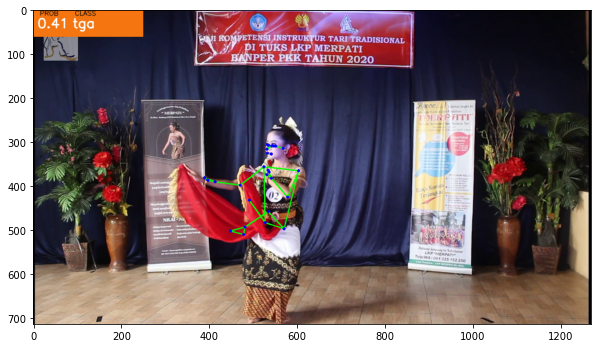

 73%|███████████████████████████████████████████████████████▊                    | 2203/3000.0 [04:03<02:11,  6.06it/s]

tga [0.32 0.39 0.29]
tga [0.36 0.42 0.22]


 74%|███████████████████████████████████████████████████████▊                    | 2205/3000.0 [04:03<01:49,  7.27it/s]

tg [0.39 0.35 0.26]
tga [0.34 0.37 0.29]


 74%|███████████████████████████████████████████████████████▉                    | 2208/3000.0 [04:03<01:25,  9.29it/s]

tg [0.38 0.36 0.26]
tga [0.36 0.4  0.24]
tga [0.36 0.37 0.27]


 74%|███████████████████████████████████████████████████████▉                    | 2210/3000.0 [04:03<01:25,  9.24it/s]

tga [0.38 0.4  0.22]
tg [0.52 0.33 0.15]
tg [0.47 0.35 0.18]


 74%|████████████████████████████████████████████████████████                    | 2213/3000.0 [04:04<01:20,  9.82it/s]

tg [0.49 0.35 0.16]
tg [0.47 0.36 0.17]


 74%|████████████████████████████████████████████████████████                    | 2215/3000.0 [04:04<01:36,  8.12it/s]

tg [0.45 0.36 0.19]
tga [0.4  0.43 0.17]


 74%|████████████████████████████████████████████████████████▏                   | 2217/3000.0 [04:04<01:47,  7.28it/s]

tg [0.44 0.43 0.13]
tga [0.38 0.4  0.22]


 74%|████████████████████████████████████████████████████████▏                   | 2219/3000.0 [04:05<01:56,  6.69it/s]

tga [0.36 0.44 0.2 ]
tg [0.45 0.37 0.18]


 74%|████████████████████████████████████████████████████████▎                   | 2221/3000.0 [04:05<01:47,  7.23it/s]

tg [0.42 0.39 0.19]
tg [0.41 0.39 0.2 ]



 74%|████████████████████████████████████████████████████████▎                   | 2222/3000.0 [04:05<01:51,  6.95it/s]

tg [0.41 0.37 0.22]
tg [0.43 0.43 0.14]
tg [0.42 0.38 0.2 ]


 74%|████████████████████████████████████████████████████████▍                   | 2226/3000.0 [04:05<01:31,  8.45it/s]

tg [0.44 0.4  0.16]
tg [0.43 0.43 0.14]


 74%|████████████████████████████████████████████████████████▍                   | 2229/3000.0 [04:06<01:20,  9.58it/s]

tga [0.41 0.45 0.14]
tga [0.4  0.45 0.15]
tg [0.46 0.37 0.17]


 74%|████████████████████████████████████████████████████████▌                   | 2231/3000.0 [04:06<01:37,  7.87it/s]

tg [0.44 0.43 0.13]
tg [0.45 0.44 0.11]


 74%|████████████████████████████████████████████████████████▌                   | 2233/3000.0 [04:06<01:41,  7.59it/s]

tg [0.39 0.38 0.23]
tg [0.47 0.38 0.15]


 74%|████████████████████████████████████████████████████████▌                   | 2235/3000.0 [04:07<01:47,  7.09it/s]

tg [0.49 0.4  0.11]
tga [0.42 0.44 0.14]


 75%|████████████████████████████████████████████████████████▋                   | 2237/3000.0 [04:07<01:51,  6.86it/s]

tga [0.39 0.44 0.17]
tg [0.45 0.43 0.12]


 75%|████████████████████████████████████████████████████████▋                   | 2239/3000.0 [04:07<01:41,  7.49it/s]

tga [0.38 0.45 0.17]
tg [0.46 0.33 0.21]



 75%|████████████████████████████████████████████████████████▋                   | 2240/3000.0 [04:07<01:42,  7.40it/s]

tg [0.47 0.41 0.12]
tg [0.44 0.4  0.16]
tga [0.4  0.42 0.18]


 75%|████████████████████████████████████████████████████████▊                   | 2244/3000.0 [04:08<01:34,  7.99it/s]

tg [0.45 0.44 0.11]
tg [0.45 0.43 0.12]



 75%|████████████████████████████████████████████████████████▊                   | 2245/3000.0 [04:08<01:36,  7.84it/s]

tg [0.46 0.42 0.12]
tg [0.44 0.43 0.13]
tg [0.48 0.41 0.11]


 75%|████████████████████████████████████████████████████████▉                   | 2249/3000.0 [04:08<01:18,  9.61it/s]

tg [0.47 0.42 0.11]
tg [0.47 0.42 0.11]



 75%|█████████████████████████████████████████████████████████                   | 2250/3000.0 [04:08<01:25,  8.76it/s]

tg [0.48 0.41 0.11]
tg [0.51 0.4  0.09]


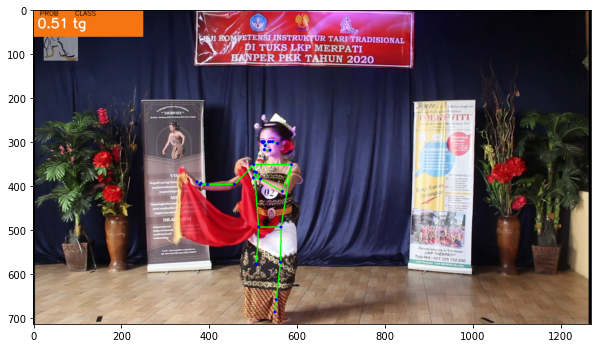

 75%|█████████████████████████████████████████████████████████                   | 2253/3000.0 [04:09<02:24,  5.18it/s]

tg [0.41 0.41 0.18]
tga [0.31 0.55 0.14]



 75%|█████████████████████████████████████████████████████████                   | 2254/3000.0 [04:09<02:05,  5.96it/s]

tg [0.42 0.39 0.19]
tg [0.46 0.37 0.17]
tga [0.4  0.41 0.19]


 75%|█████████████████████████████████████████████████████████▏                  | 2258/3000.0 [04:10<01:24,  8.79it/s]

tg [0.41 0.33 0.26]
tga [0.4  0.46 0.14]
tg [0.54 0.35 0.11]


 75%|█████████████████████████████████████████████████████████▎                  | 2262/3000.0 [04:10<01:09, 10.63it/s]

tg [0.5  0.44 0.06]
tg [0.5  0.43 0.07]
tg [0.47 0.44 0.09]



 75%|█████████████████████████████████████████████████████████▎                  | 2264/3000.0 [04:10<01:06, 11.04it/s]

tg [0.47 0.46 0.07]
tg [0.48 0.44 0.08]
tg [0.46 0.42 0.12]


 76%|█████████████████████████████████████████████████████████▍                  | 2268/3000.0 [04:11<01:03, 11.51it/s]

tg [0.47 0.45 0.08]
tga [0.45 0.49 0.06]
tg [0.47 0.46 0.07]



 76%|█████████████████████████████████████████████████████████▌                  | 2270/3000.0 [04:11<01:03, 11.43it/s]

tga [0.46 0.47 0.07]
tg [0.47 0.44 0.09]
tga [0.43 0.44 0.13]



 76%|█████████████████████████████████████████████████████████▌                  | 2272/3000.0 [04:11<01:03, 11.39it/s]

tga [0.42 0.47 0.11]
tga [0.41 0.47 0.12]
tga [0.41 0.44 0.15]


 76%|█████████████████████████████████████████████████████████▋                  | 2276/3000.0 [04:11<01:00, 11.88it/s]

tga [0.41 0.47 0.12]
tga [0.42 0.48 0.1 ]
tga [0.41 0.45 0.14]


 76%|█████████████████████████████████████████████████████████▊                  | 2280/3000.0 [04:12<00:58, 12.22it/s]

tga [0.4  0.46 0.14]
tga [0.42 0.45 0.13]
tga [0.38 0.47 0.15]



 76%|█████████████████████████████████████████████████████████▊                  | 2282/3000.0 [04:12<00:59, 12.15it/s]

tga [0.39 0.47 0.14]
tga [0.41 0.48 0.11]
tga [0.42 0.46 0.12]


 76%|█████████████████████████████████████████████████████████▉                  | 2286/3000.0 [04:12<00:59, 12.05it/s]

tga [0.42 0.45 0.13]
tg [0.44 0.44 0.12]
tg [0.46 0.42 0.12]



 76%|█████████████████████████████████████████████████████████▉                  | 2288/3000.0 [04:12<00:58, 12.23it/s]

tg [0.46 0.41 0.13]
tg [0.46 0.39 0.15]
tg [0.48 0.36 0.16]


 76%|██████████████████████████████████████████████████████████                  | 2292/3000.0 [04:12<00:57, 12.30it/s]

tg [0.46 0.38 0.16]
tg [0.45 0.37 0.18]
tg [0.43 0.37 0.2 ]



 76%|██████████████████████████████████████████████████████████                  | 2294/3000.0 [04:13<00:59, 11.83it/s]

tg [0.42 0.4  0.18]
tg [0.43 0.41 0.16]
tga [0.38 0.41 0.21]


 77%|██████████████████████████████████████████████████████████▏                 | 2298/3000.0 [04:13<00:59, 11.76it/s]

tga [0.36 0.48 0.16]
tga [0.33 0.42 0.25]
tga [0.33 0.38 0.29]



 77%|██████████████████████████████████████████████████████████▎                 | 2300/3000.0 [04:13<00:57, 12.10it/s]

tga [0.35 0.41 0.24]
tga [0.34 0.42 0.24]
tga [0.34 0.38 0.28]


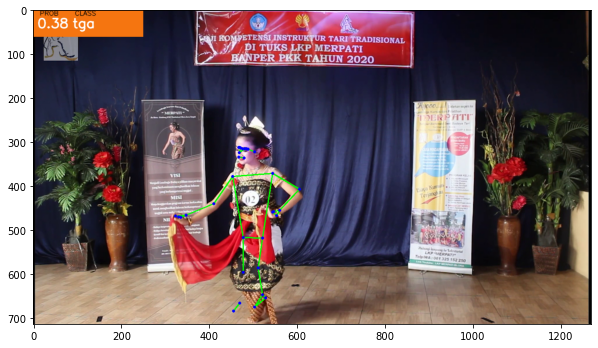

 77%|██████████████████████████████████████████████████████████▎                 | 2304/3000.0 [04:14<01:25,  8.15it/s]

tg [0.37 0.37 0.26]
tg [0.38 0.33 0.29]
tga [0.32 0.41 0.27]



 77%|██████████████████████████████████████████████████████████▍                 | 2306/3000.0 [04:14<01:16,  9.06it/s]

tg [0.36 0.35 0.29]
tga [0.35 0.42 0.23]
tga [0.38 0.44 0.18]


 77%|██████████████████████████████████████████████████████████▌                 | 2310/3000.0 [04:14<01:06, 10.34it/s]

tga [0.34 0.43 0.23]
tga [0.36 0.43 0.21]
tga [0.32 0.41 0.27]



 77%|██████████████████████████████████████████████████████████▌                 | 2312/3000.0 [04:15<01:03, 10.83it/s]

tg [0.39 0.39 0.22]
tga [0.34 0.42 0.24]
tga [0.33 0.42 0.25]


 77%|██████████████████████████████████████████████████████████▋                 | 2316/3000.0 [04:15<01:00, 11.25it/s]

tga [0.33 0.44 0.23]
tga [0.3  0.43 0.27]
tga [0.38 0.39 0.23]



 77%|██████████████████████████████████████████████████████████▋                 | 2318/3000.0 [04:15<01:00, 11.36it/s]

tga [0.31 0.42 0.27]
tga [0.37 0.4  0.23]
tga [0.29 0.44 0.27]


 77%|██████████████████████████████████████████████████████████▊                 | 2322/3000.0 [04:15<00:57, 11.72it/s]

tga [0.34 0.43 0.23]
tga [0.31 0.46 0.23]
tga [0.34 0.4  0.26]



 77%|██████████████████████████████████████████████████████████▊                 | 2324/3000.0 [04:16<01:08,  9.90it/s]

tga [0.32 0.47 0.21]
tga [0.37 0.48 0.15]



 78%|██████████████████████████████████████████████████████████▉                 | 2326/3000.0 [04:16<01:13,  9.17it/s]

tga [0.4  0.45 0.15]
tga [0.35 0.46 0.19]


 78%|██████████████████████████████████████████████████████████▉                 | 2328/3000.0 [04:16<01:12,  9.33it/s]

tga [0.36 0.41 0.23]
tga [0.35 0.42 0.23]
tga 


 78%|███████████████████████████████████████████████████████████                 | 2330/3000.0 [04:16<01:09,  9.68it/s]

[0.36 0.44 0.2 ]
tga [0.34 0.43 0.23]


 78%|███████████████████████████████████████████████████████████                 | 2332/3000.0 [04:17<01:17,  8.57it/s]

tga [0.36 0.45 0.19]
tga [0.36 0.47 0.17]



 78%|███████████████████████████████████████████████████████████                 | 2333/3000.0 [04:17<01:19,  8.42it/s]

tga [0.35 0.48 0.17]
tga [0.33 0.53 0.14]
tga [0.37 0.52 0.11]


 78%|███████████████████████████████████████████████████████████▏                | 2337/3000.0 [04:17<01:08,  9.67it/s]

tga [0.41 0.49 0.1 ]
tga [0.39 0.47 0.14]


 78%|███████████████████████████████████████████████████████████▎                | 2340/3000.0 [04:17<01:05, 10.07it/s]

tga [0.39 0.45 0.16]
tga [0.41 0.51 0.08]
tga [0.33 0.57 0.1 ]


 78%|███████████████████████████████████████████████████████████▍                | 2344/3000.0 [04:18<00:59, 11.06it/s]

tga [0.09 0.85 0.06]



 78%|███████████████████████████████████████████████████████████▍                | 2346/3000.0 [04:18<01:04, 10.09it/s]

tga [0.27 0.55 0.18]
tga [0.27 0.57 0.16]
tga [0.29 0.58 0.13]


 78%|███████████████████████████████████████████████████████████▌                | 2350/3000.0 [04:18<01:01, 10.58it/s]

tga [0.33 0.53 0.14]
tga [0.37 0.5  0.13]
tga [0.35 0.51 0.14]


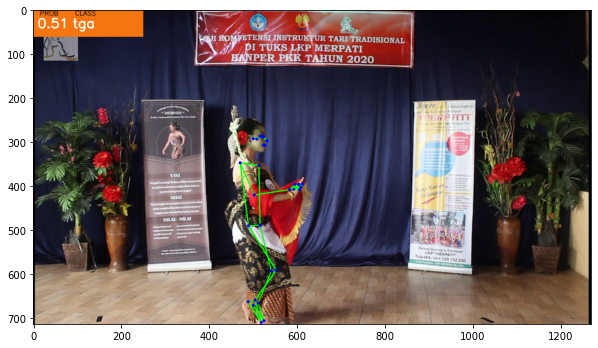

 78%|███████████████████████████████████████████████████████████▋                | 2354/3000.0 [04:19<01:23,  7.74it/s]

tga [0.35 0.5  0.15]
tga [0.29 0.55 0.16]
tga [0.31 0.51 0.18]



 79%|███████████████████████████████████████████████████████████▋                | 2356/3000.0 [04:19<01:13,  8.75it/s]

tga [0.33 0.48 0.19]
tga [0.3  0.55 0.15]
tga [0.32 0.53 0.15]


 79%|███████████████████████████████████████████████████████████▊                | 2360/3000.0 [04:19<01:00, 10.57it/s]

tga [0.29 0.59 0.12]
tga [0.31 0.53 0.16]
tga [0.32 0.54 0.14]



 79%|███████████████████████████████████████████████████████████▊                | 2362/3000.0 [04:20<00:57, 11.16it/s]

tga [0.29 0.57 0.14]
tga [0.32 0.62 0.06]
tga [0.25 0.64 0.11]


 79%|███████████████████████████████████████████████████████████▉                | 2366/3000.0 [04:20<00:52, 12.06it/s]

tga [0.22 0.6  0.18]
tga [0.21 0.49 0.3 ]
tga [0.27 0.39 0.34]



 79%|███████████████████████████████████████████████████████████▉                | 2368/3000.0 [04:20<00:52, 12.10it/s]

tga [0.25 0.52 0.23]
tga [0.34 0.4  0.26]
tga [0.28 0.42 0.3 ]


 79%|████████████████████████████████████████████████████████████                | 2372/3000.0 [04:20<00:49, 12.63it/s]

tga [0.23 0.47 0.3 ]
tga [0.25 0.43 0.32]
tga [0.27 0.42 0.31]



 79%|████████████████████████████████████████████████████████████▏               | 2374/3000.0 [04:21<00:49, 12.62it/s]

tga [0.3  0.41 0.29]
tga [0.32 0.43 0.25]
tga [0.3  0.49 0.21]


 79%|████████████████████████████████████████████████████████████▏               | 2378/3000.0 [04:21<00:48, 12.80it/s]

tga [0.22 0.5  0.28]
tga [0.28 0.43 0.29]
tga [0.29 0.41 0.3 ]



 79%|████████████████████████████████████████████████████████████▎               | 2380/3000.0 [04:21<00:47, 12.98it/s]

tga [0.31 0.41 0.28]
tga [0.27 0.45 0.28]


 80%|████████████████████████████████████████████████████████████▍               | 2388/3000.0 [04:22<00:47, 12.83it/s]

tg [0.41 0.28 0.31]
tg [0.39 0.33 0.28]


 80%|████████████████████████████████████████████████████████████▊               | 2400/3000.0 [04:23<00:50, 11.85it/s]

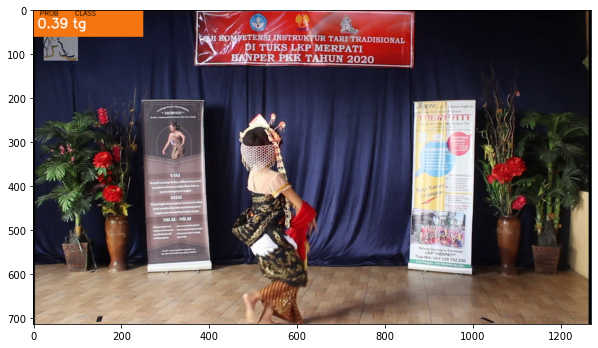

 80%|████████████████████████████████████████████████████████████▉               | 2406/3000.0 [04:24<01:07,  8.82it/s]

tg [0.42 0.31 0.27]
tga [0.33 0.56 0.11]



 80%|█████████████████████████████████████████████████████████████               | 2408/3000.0 [04:24<01:05,  9.10it/s]

tga [0.39 0.52 0.09]
tga [0.35 0.57 0.08]



 80%|█████████████████████████████████████████████████████████████               | 2410/3000.0 [04:24<01:04,  9.21it/s]

tga [0.33 0.56 0.11]
tga [0.32 0.53 0.15]
tga 


 80%|█████████████████████████████████████████████████████████████               | 2412/3000.0 [04:24<00:59,  9.92it/s]

[0.33 0.53 0.14]
tga [0.36 0.46 0.18]
tga [0.25 0.62 0.13]


 81%|█████████████████████████████████████████████████████████████▏              | 2416/3000.0 [04:24<00:52, 11.18it/s]

tga [0.35 0.57 0.08]
tga [0.41 0.5  0.09]
tga [0.31 0.57 0.12]



 81%|█████████████████████████████████████████████████████████████▎              | 2418/3000.0 [04:25<00:50, 11.55it/s]

tga [0.3  0.55 0.15]
tga [0.31 0.57 0.12]
tga [0.32 0.56 0.12]


 81%|█████████████████████████████████████████████████████████████▎              | 2422/3000.0 [04:25<00:48, 11.99it/s]

tga [0.32 0.59 0.09]
tga [0.35 0.59 0.06]
tga [0.31 0.57 0.12]



 81%|█████████████████████████████████████████████████████████████▍              | 2424/3000.0 [04:25<00:48, 11.92it/s]

tga [0.3 0.6 0.1]
tga [0.33 0.56 0.11]
tga [0.34 0.56 0.1 ]


 81%|█████████████████████████████████████████████████████████████▌              | 2428/3000.0 [04:25<00:47, 12.12it/s]

tga [0.34 0.57 0.09]
tga [0.34 0.61 0.05]
tga [0.32 0.63 0.05]



 81%|█████████████████████████████████████████████████████████████▌              | 2430/3000.0 [04:26<00:47, 11.99it/s]

tga [0.28 0.66 0.06]
tga [0.29 0.63 0.08]
tga [0.31 0.63 0.06]


 81%|█████████████████████████████████████████████████████████████▋              | 2434/3000.0 [04:26<00:47, 11.98it/s]

tga [0.36 0.56 0.08]
tga [0.39 0.52 0.09]
tga [0.37 0.53 0.1 ]



 81%|█████████████████████████████████████████████████████████████▋              | 2436/3000.0 [04:26<00:46, 12.11it/s]

tga [0.38 0.52 0.1 ]
tga [0.36 0.54 0.1 ]
tga [0.36 0.53 0.11]


 81%|█████████████████████████████████████████████████████████████▊              | 2440/3000.0 [04:26<00:46, 12.06it/s]

tga [0.36 0.54 0.1 ]
tga [0.36 0.57 0.07]
tga [0.36 0.56 0.08]



 81%|█████████████████████████████████████████████████████████████▊              | 2442/3000.0 [04:27<00:45, 12.19it/s]

tga [0.34 0.53 0.13]
tga [0.32 0.55 0.13]
tga [0.32 0.58 0.1 ]


 82%|█████████████████████████████████████████████████████████████▉              | 2446/3000.0 [04:27<00:45, 12.12it/s]

tga [0.33 0.54 0.13]
tga [0.34 0.54 0.12]
tga [0.34 0.53 0.13]



 82%|██████████████████████████████████████████████████████████████              | 2448/3000.0 [04:27<00:45, 12.19it/s]

tga [0.34 0.54 0.12]
tga [0.34 0.55 0.11]
tga [0.32 0.58 0.1 ]



 82%|██████████████████████████████████████████████████████████████              | 2450/3000.0 [04:27<00:45, 12.17it/s]

tga [0.34 0.59 0.07]
tga [0.33 0.59 0.08]


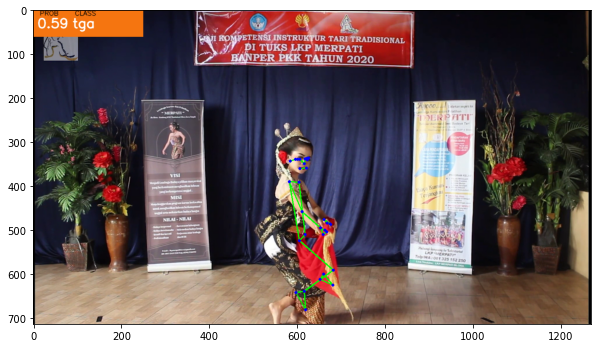

 82%|██████████████████████████████████████████████████████████████▏             | 2454/3000.0 [04:28<01:04,  8.47it/s]

tga [0.32 0.61 0.07]
tga [0.35 0.57 0.08]
tga [0.37 0.55 0.08]



 82%|██████████████████████████████████████████████████████████████▏             | 2456/3000.0 [04:28<00:57,  9.39it/s]

tga [0.36 0.56 0.08]
tga [0.3  0.62 0.08]
tga [0.27 0.66 0.07]


 82%|██████████████████████████████████████████████████████████████▎             | 2460/3000.0 [04:28<00:50, 10.62it/s]

tga [0.32 0.62 0.06]
tga [0.29 0.62 0.09]
tga [0.3  0.63 0.07]



 82%|██████████████████████████████████████████████████████████████▎             | 2462/3000.0 [04:29<00:49, 10.97it/s]

tga [0.31 0.59 0.1 ]
tga [0.31 0.62 0.07]
tga [0.34 0.6  0.06]


 82%|██████████████████████████████████████████████████████████████▍             | 2466/3000.0 [04:29<00:46, 11.40it/s]

tga [0.34 0.6  0.06]
tga [0.33 0.6  0.07]
tga [0.32 0.61 0.07]



 82%|██████████████████████████████████████████████████████████████▌             | 2468/3000.0 [04:29<00:45, 11.57it/s]

tga [0.29 0.65 0.06]
tga [0.3  0.64 0.06]
tga [0.27 0.67 0.06]


 82%|██████████████████████████████████████████████████████████████▌             | 2472/3000.0 [04:29<00:44, 11.79it/s]

tga [0.28 0.66 0.06]
tga [0.28 0.59 0.13]
tga [0.25 0.6  0.15]



 82%|██████████████████████████████████████████████████████████████▋             | 2474/3000.0 [04:30<00:44, 11.89it/s]

tga [0.2  0.61 0.19]
tga [0.31 0.55 0.14]
tga [0.32 0.54 0.14]


 83%|██████████████████████████████████████████████████████████████▉             | 2482/3000.0 [04:30<00:42, 12.05it/s]

tga [0.27 0.55 0.18]
tga [0.27 0.53 0.2 ]
tga [0.3  0.49 0.21]



 83%|██████████████████████████████████████████████████████████████▉             | 2484/3000.0 [04:30<00:41, 12.31it/s]

tga [0.22 0.57 0.21]
tga [0.24 0.58 0.18]
tga [0.22 0.61 0.17]


 83%|███████████████████████████████████████████████████████████████             | 2488/3000.0 [04:31<00:41, 12.27it/s]

tga [0.2  0.59 0.21]
tga [0.25 0.52 0.23]
tga [0.37 0.53 0.1 ]



 83%|███████████████████████████████████████████████████████████████             | 2490/3000.0 [04:31<00:42, 12.09it/s]

tga [0.31 0.57 0.12]
tga [0.27 0.62 0.11]
tga [0.2  0.67 0.13]


 83%|███████████████████████████████████████████████████████████████▏            | 2494/3000.0 [04:31<00:40, 12.34it/s]

tga [0.24 0.66 0.1 ]
tga [0.25 0.68 0.07]
tga [0.24 0.66 0.1 ]


 83%|███████████████████████████████████████████████████████████████▎            | 2498/3000.0 [04:31<00:37, 13.40it/s]

tga [0.22 0.6  0.18]



 83%|███████████████████████████████████████████████████████████████▎            | 2500/3000.0 [04:32<00:42, 11.81it/s]

tga [0.32 0.43 0.25]


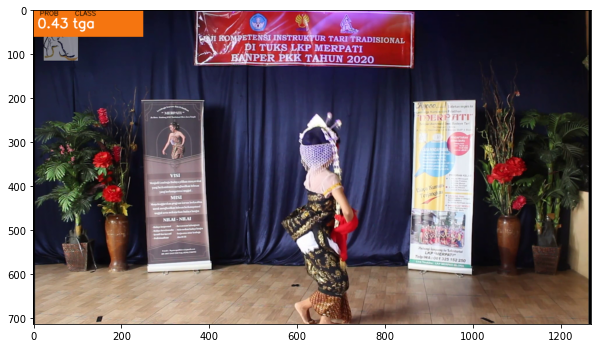

 84%|███████████████████████████████████████████████████████████████▋            | 2512/3000.0 [04:33<00:46, 10.58it/s]

tga [0.38 0.42 0.2 ]


 84%|███████████████████████████████████████████████████████████████▋            | 2516/3000.0 [04:33<00:43, 11.09it/s]

tg [0.37 0.37 0.26]
tg [0.41 0.36 0.23]
tg [0.39 0.39 0.22]



 84%|███████████████████████████████████████████████████████████████▊            | 2518/3000.0 [04:33<00:41, 11.66it/s]

tga [0.39 0.43 0.18]
tg [0.43 0.41 0.16]
tga [0.39 0.4  0.21]


 84%|███████████████████████████████████████████████████████████████▉            | 2522/3000.0 [04:34<00:39, 12.14it/s]

tg [0.4  0.37 0.23]
tga [0.4  0.42 0.18]
tga [0.39 0.41 0.2 ]


 84%|███████████████████████████████████████████████████████████████▉            | 2526/3000.0 [04:34<00:35, 13.38it/s]

tga [0.4  0.41 0.19]
tg [0.45 0.38 0.17]
tg [0.45 0.39 0.16]


 85%|████████████████████████████████████████████████████████████████▏           | 2536/3000.0 [04:35<00:38, 12.05it/s]

tga [0.21 0.67 0.12]
tga [0.39 0.45 0.16]


 85%|████████████████████████████████████████████████████████████████▌           | 2550/3000.0 [04:36<00:38, 11.78it/s]

tga [0.29 0.54 0.17]
tga [0.36 0.48 0.16]
tga [0.36 0.5  0.14]
tga [0.36 0.46 0.18]


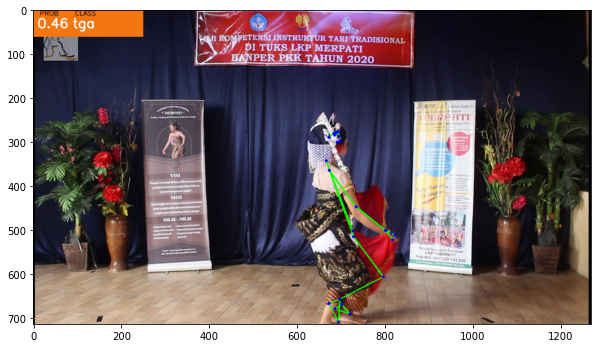

 85%|████████████████████████████████████████████████████████████████▋           | 2554/3000.0 [04:37<00:51,  8.65it/s]

tga [0.41 0.42 0.17]
tga [0.34 0.47 0.19]
tga [0.31 0.53 0.16]



 85%|████████████████████████████████████████████████████████████████▊           | 2556/3000.0 [04:37<00:46,  9.57it/s]

tga [0.31 0.56 0.13]
tga [0.29 0.6  0.11]
tga [0.3  0.61 0.09]


 85%|████████████████████████████████████████████████████████████████▊           | 2560/3000.0 [04:37<00:39, 11.07it/s]

tga [0.31 0.6  0.09]
tga [0.29 0.58 0.13]
tga [0.3  0.59 0.11]



 85%|████████████████████████████████████████████████████████████████▉           | 2562/3000.0 [04:37<00:37, 11.67it/s]

tga [0.29 0.58 0.13]
tga [0.3  0.58 0.12]
tga [0.33 0.56 0.11]


 86%|█████████████████████████████████████████████████████████████████           | 2566/3000.0 [04:38<00:35, 12.33it/s]

tga [0.32 0.57 0.11]
tga [0.3  0.57 0.13]
tga [0.31 0.57 0.12]



 86%|█████████████████████████████████████████████████████████████████           | 2568/3000.0 [04:38<00:35, 12.33it/s]

tga [0.3  0.57 0.13]
tga [0.31 0.55 0.14]
tga [0.29 0.59 0.12]


 86%|█████████████████████████████████████████████████████████████████▏          | 2572/3000.0 [04:38<00:34, 12.58it/s]

tga [0.29 0.58 0.13]
tga [0.32 0.57 0.11]
tga [0.28 0.6  0.12]



 86%|█████████████████████████████████████████████████████████████████▏          | 2574/3000.0 [04:38<00:33, 12.77it/s]

tga [0.3  0.59 0.11]
tga [0.32 0.57 0.11]
tga [0.29 0.58 0.13]


 86%|█████████████████████████████████████████████████████████████████▎          | 2578/3000.0 [04:39<00:32, 13.00it/s]

tga [0.28 0.6  0.12]
tga [0.34 0.56 0.1 ]
tga [0.29 0.58 0.13]



 86%|█████████████████████████████████████████████████████████████████▎          | 2580/3000.0 [04:39<00:31, 13.15it/s]

tga [0.29 0.58 0.13]
tga [0.29 0.58 0.13]
tga [0.31 0.57 0.12]



 86%|█████████████████████████████████████████████████████████████████▍          | 2582/3000.0 [04:39<00:32, 12.73it/s]

tga [0.3  0.57 0.13]
tga [0.3  0.58 0.12]



 86%|█████████████████████████████████████████████████████████████████▍          | 2584/3000.0 [04:39<00:36, 11.52it/s]

tga [0.3  0.58 0.12]
tga [0.29 0.59 0.12]



 86%|█████████████████████████████████████████████████████████████████▌          | 2586/3000.0 [04:39<00:38, 10.63it/s]

tga [0.31 0.57 0.12]
tga [0.29 0.58 0.13]


 86%|█████████████████████████████████████████████████████████████████▌          | 2589/3000.0 [04:40<00:45,  8.95it/s]

tga [0.31 0.56 0.13]
tga [0.32 0.55 0.13]


 86%|█████████████████████████████████████████████████████████████████▋          | 2591/3000.0 [04:40<00:49,  8.30it/s]

tga [0.35 0.53 0.12]
tga [0.33 0.55 0.12]


 86%|█████████████████████████████████████████████████████████████████▋          | 2593/3000.0 [04:40<00:48,  8.42it/s]

tga [0.3  0.58 0.12]
tga [0.3  0.58 0.12]


 86%|█████████████████████████████████████████████████████████████████▋          | 2595/3000.0 [04:40<00:47,  8.61it/s]

tga [0.29 0.58 0.13]
tga [0.31 0.55 0.14]
tga [0.3  0.57 0.13]


 87%|█████████████████████████████████████████████████████████████████▊          | 2598/3000.0 [04:41<00:44,  9.09it/s]

tga [0.32 0.56 0.12]
tga [0.33 0.56 0.11]


 87%|█████████████████████████████████████████████████████████████████▊          | 2600/3000.0 [04:41<00:44,  8.94it/s]

tga [0.32 0.61 0.07]
tga [0.33 0.59 0.08]
tga [0.34 0.58 0.08]


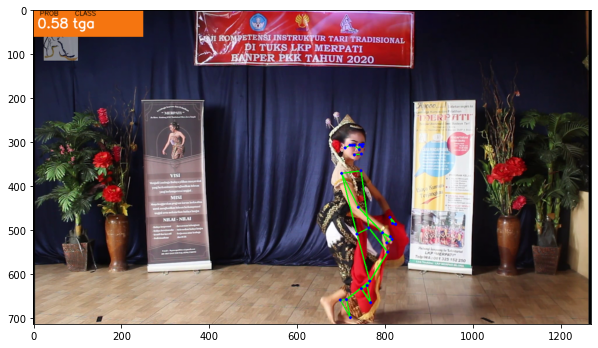

 87%|█████████████████████████████████████████████████████████████████▉          | 2603/3000.0 [04:42<01:16,  5.17it/s]

tga [0.35 0.57 0.08]
tga [0.36 0.56 0.08]


 87%|█████████████████████████████████████████████████████████████████▉          | 2605/3000.0 [04:42<01:08,  5.76it/s]

tga [0.35 0.59 0.06]
tga [0.31 0.63 0.06]


 87%|██████████████████████████████████████████████████████████████████          | 2607/3000.0 [04:42<00:58,  6.72it/s]

tga [0.33 0.58 0.09]
tga [0.29 0.59 0.12]


 87%|██████████████████████████████████████████████████████████████████          | 2609/3000.0 [04:43<00:50,  7.70it/s]

tga [0.34 0.58 0.08]
tga [0.32 0.61 0.07]


 87%|██████████████████████████████████████████████████████████████████▏         | 2611/3000.0 [04:43<00:49,  7.86it/s]

tga [0.32 0.56 0.12]
tga [0.32 0.58 0.1 ]



 87%|██████████████████████████████████████████████████████████████████▏         | 2613/3000.0 [04:43<00:42,  9.15it/s]

tga [0.34 0.59 0.07]
tga [0.31 0.61 0.08]
tga [0.28 0.65 0.07]


 87%|██████████████████████████████████████████████████████████████████▎         | 2617/3000.0 [04:43<00:35, 10.89it/s]

tga [0.21 0.63 0.16]
tga [0.23 0.64 0.13]
tga [0.26 0.62 0.12]



 87%|██████████████████████████████████████████████████████████████████▎         | 2619/3000.0 [04:44<00:34, 11.15it/s]

tga [0.32 0.59 0.09]
tga [0.3  0.61 0.09]
tga [0.3  0.63 0.07]



 87%|██████████████████████████████████████████████████████████████████▍         | 2621/3000.0 [04:44<00:32, 11.56it/s]

tga [0.31 0.51 0.18]
tga [0.29 0.51 0.2 ]
tga [0.29 0.54 0.17]


 88%|██████████████████████████████████████████████████████████████████▌         | 2625/3000.0 [04:44<00:32, 11.44it/s]

tga [0.28 0.56 0.16]
tga [0.29 0.57 0.14]
tga [0.35 0.46 0.19]


 88%|██████████████████████████████████████████████████████████████████▌         | 2629/3000.0 [04:44<00:31, 11.93it/s]

tga [0.29 0.51 0.2 ]
tga [0.26 0.53 0.21]
tga [0.3  0.57 0.13]



 88%|██████████████████████████████████████████████████████████████████▋         | 2631/3000.0 [04:45<00:30, 11.92it/s]

tga [0.29 0.58 0.13]
tga [0.32 0.52 0.16]
tga [0.32 0.57 0.11]


 88%|██████████████████████████████████████████████████████████████████▊         | 2635/3000.0 [04:45<00:30, 11.82it/s]

tga [0.29 0.56 0.15]
tga [0.31 0.55 0.14]
tga [0.32 0.52 0.16]



 88%|██████████████████████████████████████████████████████████████████▊         | 2637/3000.0 [04:45<00:30, 12.00it/s]

tga [0.35 0.53 0.12]
tga [0.36 0.47 0.17]
tga [0.28 0.54 0.18]


 88%|██████████████████████████████████████████████████████████████████▉         | 2641/3000.0 [04:45<00:28, 12.66it/s]

tga [0.34 0.5  0.16]
tga [0.3  0.55 0.15]
tga [0.34 0.52 0.14]



 88%|██████████████████████████████████████████████████████████████████▉         | 2643/3000.0 [04:45<00:28, 12.51it/s]

tga [0.3  0.57 0.13]
tga [0.29 0.58 0.13]
tga [0.3  0.57 0.13]


 88%|███████████████████████████████████████████████████████████████████         | 2647/3000.0 [04:46<00:28, 12.51it/s]

tga [0.32 0.55 0.13]
tga [0.33 0.54 0.13]
tga [0.35 0.51 0.14]



 88%|███████████████████████████████████████████████████████████████████         | 2649/3000.0 [04:46<00:27, 12.67it/s]

tga [0.34 0.52 0.14]
tga [0.29 0.56 0.15]
tga [0.3  0.57 0.13]
tga [0.36 0.54 0.1 ]


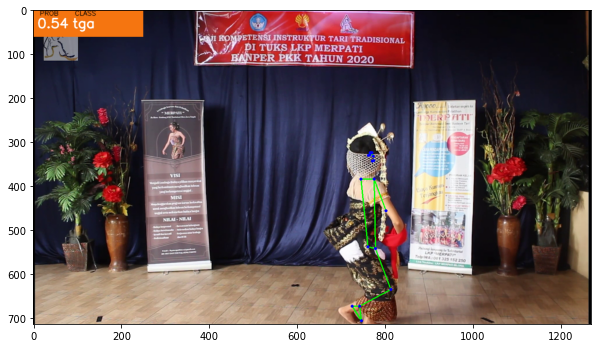

 88%|███████████████████████████████████████████████████████████████████▏        | 2653/3000.0 [04:47<00:39,  8.73it/s]

tga [0.34 0.52 0.14]
tga [0.29 0.61 0.1 ]



 88%|███████████████████████████████████████████████████████████████████▎        | 2655/3000.0 [04:47<00:38,  8.97it/s]

tga [0.3  0.57 0.13]
tga [0.3  0.55 0.15]



 89%|███████████████████████████████████████████████████████████████████▎        | 2657/3000.0 [04:47<00:38,  8.87it/s]

tga [0.32 0.53 0.15]
tga [0.34 0.54 0.12]
tga [0.33 0.55 0.12]


 89%|███████████████████████████████████████████████████████████████████▍        | 2661/3000.0 [04:47<00:32, 10.49it/s]

tga [0.32 0.53 0.15]
tga [0.39 0.47 0.14]
tga [0.36 0.55 0.09]



 89%|███████████████████████████████████████████████████████████████████▍        | 2663/3000.0 [04:48<00:30, 11.19it/s]

tga [0.34 0.54 0.12]
tga [0.35 0.57 0.08]
tga [0.32 0.56 0.12]


 89%|███████████████████████████████████████████████████████████████████▌        | 2667/3000.0 [04:48<00:28, 11.84it/s]

tga [0.36 0.53 0.11]
tga [0.4  0.51 0.09]
tga [0.35 0.56 0.09]



 89%|███████████████████████████████████████████████████████████████████▌        | 2669/3000.0 [04:48<00:27, 11.96it/s]

tga [0.34 0.56 0.1 ]
tga [0.3 0.6 0.1]
tga [0.32 0.59 0.09]



 89%|███████████████████████████████████████████████████████████████████▋        | 2671/3000.0 [04:48<00:26, 12.34it/s]

tga [0.32 0.57 0.11]
tga [0.34 0.55 0.11]
tga [0.32 0.58 0.1 ]


 89%|███████████████████████████████████████████████████████████████████▊        | 2675/3000.0 [04:48<00:27, 11.97it/s]

tga [0.3  0.58 0.12]
tga [0.31 0.57 0.12]
tga [0.36 0.51 0.13]


 89%|███████████████████████████████████████████████████████████████████▊        | 2679/3000.0 [04:49<00:27, 11.84it/s]

tga [0.34 0.53 0.13]
tga [0.33 0.55 0.12]
tga [0.36 0.51 0.13]



 89%|███████████████████████████████████████████████████████████████████▉        | 2681/3000.0 [04:49<00:27, 11.80it/s]

tga [0.34 0.52 0.14]
tga [0.32 0.52 0.16]
tga [0.34 0.52 0.14]


 90%|████████████████████████████████████████████████████████████████████        | 2685/3000.0 [04:49<00:25, 12.12it/s]

tga [0.3  0.57 0.13]
tga [0.29 0.59 0.12]
tga [0.3  0.58 0.12]



 90%|████████████████████████████████████████████████████████████████████        | 2687/3000.0 [04:49<00:25, 12.08it/s]

tga [0.3  0.59 0.11]
tga [0.3  0.59 0.11]
tga [0.29 0.66 0.05]


 90%|████████████████████████████████████████████████████████████████████▏       | 2691/3000.0 [04:50<00:25, 12.19it/s]

tga [0.3  0.59 0.11]
tga [0.29 0.6  0.11]
tga [0.3  0.57 0.13]



 90%|████████████████████████████████████████████████████████████████████▏       | 2693/3000.0 [04:50<00:25, 11.91it/s]

tga [0.33 0.55 0.12]
tga [0.31 0.58 0.11]
tga [0.31 0.59 0.1 ]



 90%|████████████████████████████████████████████████████████████████████▎       | 2695/3000.0 [04:50<00:26, 11.56it/s]

tga [0.32 0.62 0.06]
tga [0.3  0.65 0.05]
tga [0.27 0.67 0.06]


 90%|████████████████████████████████████████████████████████████████████▎       | 2699/3000.0 [04:51<00:26, 11.49it/s]

tga [0.29 0.59 0.12]
tga [0.28 0.59 0.13]
tga [0.3  0.56 0.14]
tga [0.3  0.57 0.13]


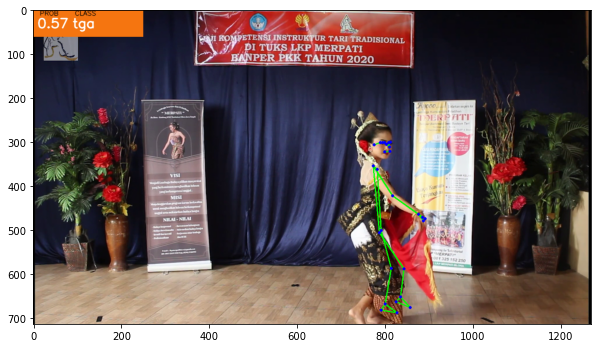

 90%|████████████████████████████████████████████████████████████████████▍       | 2703/3000.0 [04:51<00:39,  7.61it/s]

tga [0.3  0.58 0.12]
tga [0.3  0.59 0.11]
tga [0.32 0.61 0.07]


 90%|████████████████████████████████████████████████████████████████████▌       | 2707/3000.0 [04:52<00:31,  9.26it/s]

tga [0.31 0.57 0.12]
tga [0.32 0.56 0.12]
tga [0.32 0.56 0.12]



 90%|████████████████████████████████████████████████████████████████████▋       | 2709/3000.0 [04:52<00:29,  9.75it/s]

tga [0.33 0.54 0.13]
tga [0.34 0.54 0.12]
tga [0.31 0.57 0.12]



 90%|████████████████████████████████████████████████████████████████████▋       | 2711/3000.0 [04:52<00:28, 10.15it/s]

tga [0.29 0.58 0.13]
tga [0.3  0.57 0.13]


 90%|████████████████████████████████████████████████████████████████████▊       | 2714/3000.0 [04:52<00:31,  9.14it/s]

tga [0.31 0.55 0.14]
tga [0.29 0.58 0.13]
tga [0.29 0.58 0.13]


 91%|████████████████████████████████████████████████████████████████████▊       | 2717/3000.0 [04:53<00:30,  9.37it/s]

tga [0.29 0.59 0.12]
tga [0.33 0.54 0.13]


 91%|████████████████████████████████████████████████████████████████████▉       | 2720/3000.0 [04:53<00:28,  9.95it/s]

tga [0.32 0.56 0.12]
tga [0.31 0.57 0.12]
tga [0.31 0.57 0.12]



 91%|████████████████████████████████████████████████████████████████████▉       | 2722/3000.0 [04:53<00:26, 10.31it/s]

tga [0.35 0.54 0.11]
tga [0.35 0.53 0.12]
tga [0.33 0.54 0.13]


 91%|█████████████████████████████████████████████████████████████████████       | 2726/3000.0 [04:54<00:24, 11.00it/s]

tga [0.29 0.58 0.13]
tga [0.28 0.59 0.13]
tga [0.3  0.58 0.12]



 91%|█████████████████████████████████████████████████████████████████████       | 2728/3000.0 [04:54<00:24, 11.23it/s]

tga [0.29 0.58 0.13]
tga [0.35 0.55 0.1 ]
tga [0.3  0.58 0.12]



 91%|█████████████████████████████████████████████████████████████████████▏      | 2730/3000.0 [04:54<00:24, 10.85it/s]

tga [0.3  0.58 0.12]
tga [0.33 0.56 0.11]
tga [0.35 0.56 0.09]


 91%|█████████████████████████████████████████████████████████████████████▎      | 2734/3000.0 [04:54<00:24, 10.88it/s]

tga [0.35 0.55 0.1 ]
tga [0.35 0.54 0.11]
tga [0.35 0.55 0.1 ]



 91%|█████████████████████████████████████████████████████████████████████▎      | 2736/3000.0 [04:54<00:24, 10.89it/s]

tga [0.37 0.54 0.09]
tga [0.37 0.53 0.1 ]
tga [0.39 0.53 0.08]


 91%|█████████████████████████████████████████████████████████████████████▍      | 2740/3000.0 [04:55<00:23, 11.03it/s]

tga [0.37 0.56 0.07]
tga [0.31 0.57 0.12]
tga [0.26 0.65 0.09]


 91%|█████████████████████████████████████████████████████████████████████▌      | 2744/3000.0 [04:55<00:23, 10.89it/s]

tga [0.22 0.65 0.13]
tga [0.27 0.56 0.17]
tga [0.33 0.59 0.08]



 92%|█████████████████████████████████████████████████████████████████████▌      | 2746/3000.0 [04:55<00:23, 10.90it/s]

tga [0.32 0.61 0.07]
tga [0.29 0.64 0.07]
tga [0.3  0.63 0.07]



 92%|█████████████████████████████████████████████████████████████████████▌      | 2748/3000.0 [04:56<00:23, 10.88it/s]

tga [0.24 0.59 0.17]
tga [0.22 0.61 0.17]
tga [0.25 0.65 0.1 ]



 92%|█████████████████████████████████████████████████████████████████████▋      | 2750/3000.0 [04:56<00:23, 10.45it/s]

tga [0.31 0.58 0.11]


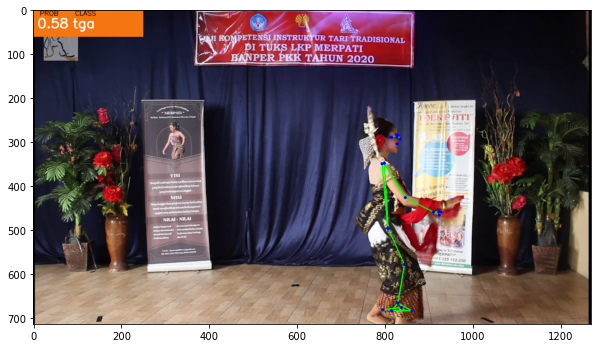

 92%|█████████████████████████████████████████████████████████████████████▊      | 2754/3000.0 [04:56<00:32,  7.55it/s]

tga [0.31 0.56 0.13]
tga [0.31 0.55 0.14]
tga [0.34 0.54 0.12]



 92%|█████████████████████████████████████████████████████████████████████▊      | 2756/3000.0 [04:57<00:28,  8.43it/s]

tga [0.31 0.55 0.14]
tga [0.29 0.57 0.14]
tga [0.33 0.52 0.15]


 92%|█████████████████████████████████████████████████████████████████████▉      | 2760/3000.0 [04:57<00:24,  9.73it/s]

tga [0.34 0.53 0.13]
tga [0.34 0.52 0.14]
tga [0.37 0.49 0.14]



 92%|█████████████████████████████████████████████████████████████████████▉      | 2762/3000.0 [04:57<00:23, 10.20it/s]

tga [0.39 0.46 0.15]
tga [0.36 0.5  0.14]
tga [0.4  0.46 0.14]


 92%|██████████████████████████████████████████████████████████████████████      | 2766/3000.0 [04:58<00:21, 10.72it/s]

tg [0.42 0.36 0.22]
tga [0.38 0.44 0.18]
tga [0.33 0.56 0.11]



 92%|██████████████████████████████████████████████████████████████████████      | 2768/3000.0 [04:58<00:21, 11.03it/s]

tga [0.36 0.49 0.15]
tga [0.36 0.49 0.15]
tga [0.37 0.47 0.16]


 92%|██████████████████████████████████████████████████████████████████████▏     | 2772/3000.0 [04:58<00:20, 11.12it/s]

tga [0.39 0.48 0.13]
tga [0.32 0.51 0.17]
tga [0.3  0.58 0.12]



 92%|██████████████████████████████████████████████████████████████████████▎     | 2774/3000.0 [04:58<00:19, 11.33it/s]

tga [0.35 0.53 0.12]
tga [0.34 0.55 0.11]
tga [0.34 0.54 0.12]


 93%|██████████████████████████████████████████████████████████████████████▍     | 2778/3000.0 [04:59<00:19, 11.36it/s]

tga [0.34 0.54 0.12]
tga [0.35 0.54 0.11]
tga [0.38 0.51 0.11]



 93%|██████████████████████████████████████████████████████████████████████▍     | 2780/3000.0 [04:59<00:18, 11.83it/s]

tga [0.32 0.56 0.12]
tga [0.32 0.55 0.13]
tga [0.33 0.52 0.15]


 93%|██████████████████████████████████████████████████████████████████████▌     | 2784/3000.0 [04:59<00:18, 11.83it/s]

tga [0.31 0.55 0.14]
tga [0.3  0.57 0.13]
tga [0.37 0.55 0.08]



 93%|██████████████████████████████████████████████████████████████████████▌     | 2786/3000.0 [04:59<00:18, 11.40it/s]

tga [0.34 0.55 0.11]
tga [0.31 0.59 0.1 ]
tga [0.3  0.58 0.12]


 93%|██████████████████████████████████████████████████████████████████████▋     | 2790/3000.0 [05:00<00:18, 11.31it/s]

tga [0.31 0.59 0.1 ]
tga [0.31 0.58 0.11]
tga [0.25 0.71 0.04]



 93%|██████████████████████████████████████████████████████████████████████▋     | 2792/3000.0 [05:00<00:18, 11.12it/s]

tga [0.3  0.57 0.13]
tga [0.33 0.55 0.12]



 93%|██████████████████████████████████████████████████████████████████████▊     | 2794/3000.0 [05:00<00:20, 10.14it/s]

tga [0.27 0.59 0.14]
tga [0.29 0.57 0.14]



 93%|██████████████████████████████████████████████████████████████████████▊     | 2796/3000.0 [05:00<00:20, 10.19it/s]

tga [0.27 0.66 0.07]
tga [0.31 0.56 0.13]
tga [0.32 0.58 0.1 ]



 93%|██████████████████████████████████████████████████████████████████████▉     | 2798/3000.0 [05:00<00:19, 10.22it/s]

tga [0.32 0.56 0.12]
tga [0.28 0.65 0.07]



 93%|██████████████████████████████████████████████████████████████████████▉     | 2800/3000.0 [05:01<00:20,  9.67it/s]

tga [0.25 0.6  0.15]
tga [0.35 0.59 0.06]


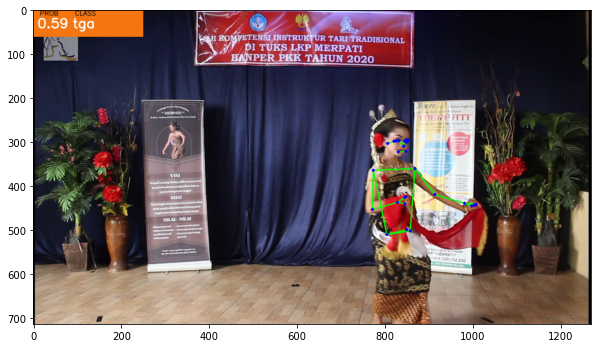

 93%|███████████████████████████████████████████████████████████████████████     | 2803/3000.0 [05:02<00:33,  5.92it/s]

tga [0.28 0.63 0.09]
tga [0.26 0.58 0.16]


 94%|███████████████████████████████████████████████████████████████████████     | 2805/3000.0 [05:02<00:29,  6.59it/s]

tga [0.24 0.61 0.15]
tga [0.28 0.63 0.09]


 94%|███████████████████████████████████████████████████████████████████████     | 2807/3000.0 [05:02<00:27,  6.97it/s]

tga [0.33 0.58 0.09]
tga [0.29 0.58 0.13]


 94%|███████████████████████████████████████████████████████████████████████▏    | 2809/3000.0 [05:02<00:25,  7.54it/s]

tga [0.31 0.57 0.12]
tga [0.28 0.62 0.1 ]


 94%|███████████████████████████████████████████████████████████████████████▏    | 2811/3000.0 [05:03<00:22,  8.25it/s]

tga [0.27 0.58 0.15]
tga [0.26 0.58 0.16]


 94%|███████████████████████████████████████████████████████████████████████▎    | 2813/3000.0 [05:03<00:21,  8.74it/s]

tga [0.32 0.57 0.11]
tga [0.28 0.59 0.13]



 94%|███████████████████████████████████████████████████████████████████████▎    | 2814/3000.0 [05:03<00:21,  8.62it/s]

tga [0.32 0.51 0.17]
tga [0.29 0.56 0.15]
tga [0.31 0.58 0.11]


 94%|███████████████████████████████████████████████████████████████████████▍    | 2818/3000.0 [05:03<00:19,  9.11it/s]

tga [0.33 0.58 0.09]
tga [0.34 0.55 0.11]
tga [0.35 0.57 0.08]


 94%|███████████████████████████████████████████████████████████████████████▍    | 2822/3000.0 [05:04<00:16, 10.59it/s]

tga [0.35 0.58 0.07]
tga [0.33 0.6  0.07]
tga [0.34 0.56 0.1 ]



 94%|███████████████████████████████████████████████████████████████████████▌    | 2824/3000.0 [05:04<00:16, 10.57it/s]

tga [0.3  0.61 0.09]
tga [0.28 0.62 0.1 ]
tga [0.33 0.55 0.12]



 94%|███████████████████████████████████████████████████████████████████████▌    | 2826/3000.0 [05:04<00:17, 10.04it/s]

tga [0.29 0.6  0.11]
tga [0.37 0.46 0.17]
tga [0.37 0.53 0.1 ]


 94%|███████████████████████████████████████████████████████████████████████▋    | 2830/3000.0 [05:04<00:16, 10.44it/s]

tga [0.35 0.55 0.1 ]
tga [0.35 0.48 0.17]
tga [0.35 0.48 0.17]


 94%|███████████████████████████████████████████████████████████████████████▊    | 2834/3000.0 [05:05<00:15, 10.83it/s]

tga [0.42 0.46 0.12]
tga [0.4 0.5 0.1]
tga [0.39 0.51 0.1 ]



 95%|███████████████████████████████████████████████████████████████████████▊    | 2836/3000.0 [05:05<00:15, 10.93it/s]

tga [0.41 0.47 0.12]
tga [0.39 0.49 0.12]
tga [0.36 0.52 0.12]


 95%|███████████████████████████████████████████████████████████████████████▉    | 2840/3000.0 [05:05<00:13, 11.57it/s]

tga [0.33 0.54 0.13]
tga [0.34 0.51 0.15]
tga [0.34 0.51 0.15]



 95%|███████████████████████████████████████████████████████████████████████▉    | 2842/3000.0 [05:05<00:13, 11.35it/s]

tga [0.3  0.55 0.15]
tga [0.37 0.49 0.14]
tga [0.41 0.44 0.15]


 95%|████████████████████████████████████████████████████████████████████████    | 2846/3000.0 [05:06<00:13, 11.22it/s]

tga [0.35 0.54 0.11]
tga [0.43 0.44 0.13]
tga [0.32 0.61 0.07]



 95%|████████████████████████████████████████████████████████████████████████▏   | 2848/3000.0 [05:06<00:13, 11.34it/s]

tga [0.35 0.57 0.08]
tga [0.35 0.58 0.07]
tga [0.37 0.57 0.06]



 95%|████████████████████████████████████████████████████████████████████████▏   | 2850/3000.0 [05:06<00:13, 11.05it/s]

tga [0.34 0.6  0.06]
tga [0.3  0.63 0.07]


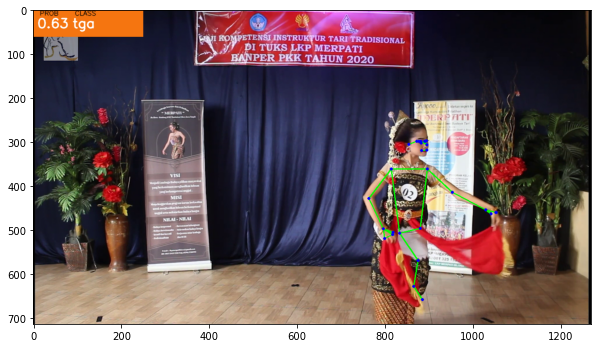

 95%|████████████████████████████████████████████████████████████████████████▎   | 2853/3000.0 [05:07<00:21,  6.91it/s]

tga [0.33 0.57 0.1 ]
tga [0.35 0.58 0.07]
tga [0.31 0.62 0.07]


 95%|████████████████████████████████████████████████████████████████████████▍   | 2857/3000.0 [05:07<00:16,  8.67it/s]

tga [0.3  0.61 0.09]
tga [0.3  0.61 0.09]
tga [0.33 0.57 0.1 ]



 95%|████████████████████████████████████████████████████████████████████████▍   | 2859/3000.0 [05:07<00:15,  9.33it/s]

tga [0.32 0.58 0.1 ]
tga [0.3  0.59 0.11]
tga 


 95%|████████████████████████████████████████████████████████████████████████▍   | 2861/3000.0 [05:08<00:14,  9.43it/s]

[0.31 0.58 0.11]
tga [0.32 0.62 0.06]
tga [0.28 0.63 0.09]



 95%|████████████████████████████████████████████████████████████████████████▌   | 2863/3000.0 [05:08<00:14,  9.42it/s]

tga [0.29 0.61 0.1 ]
tga [0.32 0.58 0.1 ]
tga 

 96%|████████████████████████████████████████████████████████████████████████▋   | 2867/3000.0 [05:08<00:12, 10.34it/s]

[0.38 0.55 0.07]
tga [0.33 0.55 0.12]
tga [0.23 0.62 0.15]



 96%|████████████████████████████████████████████████████████████████████████▋   | 2869/3000.0 [05:08<00:12, 10.20it/s]

tga [0.24 0.61 0.15]
tga [0.27 0.55 0.18]
tga [0.26 0.57 0.17]



 96%|████████████████████████████████████████████████████████████████████████▋   | 2871/3000.0 [05:09<00:12, 10.33it/s]

tga [0.32 0.58 0.1 ]
tga [0.25 0.64 0.11]



 96%|████████████████████████████████████████████████████████████████████████▊   | 2873/3000.0 [05:09<00:12, 10.06it/s]

tga [0.29 0.64 0.07]
tga [0.26 0.66 0.08]
tga [0.22 0.69 0.09]


 96%|████████████████████████████████████████████████████████████████████████▉   | 2877/3000.0 [05:09<00:12, 10.06it/s]

tga [0.27 0.67 0.06]
tga [0.31 0.62 0.07]
tga [0.29 0.66 0.05]


 96%|████████████████████████████████████████████████████████████████████████▉   | 2881/3000.0 [05:10<00:11, 10.47it/s]

tga [0.27 0.68 0.05]
tga [0.28 0.67 0.05]
tga [0.3  0.64 0.06]



 96%|█████████████████████████████████████████████████████████████████████████   | 2883/3000.0 [05:10<00:11, 10.46it/s]

tga [0.33 0.6  0.07]
tga [0.3  0.64 0.06]



 96%|█████████████████████████████████████████████████████████████████████████   | 2885/3000.0 [05:10<00:11, 10.41it/s]

tga [0.31 0.62 0.07]
tga [0.32 0.6  0.08]



 96%|█████████████████████████████████████████████████████████████████████████▏  | 2887/3000.0 [05:10<00:10, 10.28it/s]

tga [0.3  0.58 0.12]
tga [0.3  0.58 0.12]
tga [0.32 0.55 0.13]


 96%|█████████████████████████████████████████████████████████████████████████▏  | 2891/3000.0 [05:11<00:10, 10.39it/s]

tga [0.37 0.5  0.13]
tga [0.31 0.57 0.12]
tga [0.31 0.58 0.11]



 96%|█████████████████████████████████████████████████████████████████████████▎  | 2893/3000.0 [05:11<00:10, 10.31it/s]

tga [0.32 0.57 0.11]
tga [0.32 0.62 0.06]



 96%|█████████████████████████████████████████████████████████████████████████▎  | 2895/3000.0 [05:11<00:10, 10.15it/s]

tga [0.33 0.56 0.11]
tga [0.31 0.59 0.1 ]



 97%|█████████████████████████████████████████████████████████████████████████▍  | 2897/3000.0 [05:11<00:10,  9.80it/s]

tga [0.34 0.61 0.05]
tga [0.33 0.61 0.06]
tga [0.31 0.62 0.07]



 97%|█████████████████████████████████████████████████████████████████████████▍  | 2899/3000.0 [05:11<00:10,  9.88it/s]

tga [0.37 0.55 0.08]
tga [0.32 0.6  0.08]
tga [0.33 0.56 0.11]


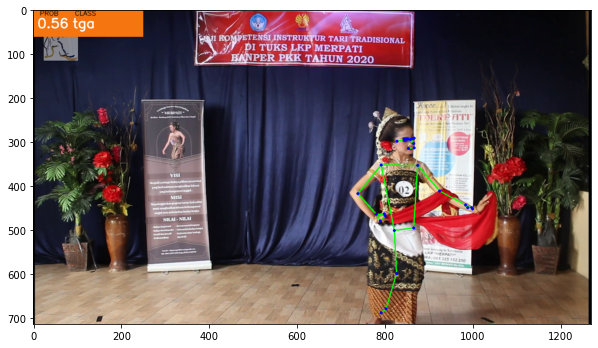

 97%|█████████████████████████████████████████████████████████████████████████▌  | 2904/3000.0 [05:12<00:11,  8.11it/s]

tga [0.35 0.53 0.12]
tga [0.36 0.53 0.11]
tga [0.34 0.55 0.11]


 97%|█████████████████████████████████████████████████████████████████████████▋  | 2907/3000.0 [05:12<00:10,  9.24it/s]

tga [0.33 0.56 0.11]
tga [0.39 0.51 0.1 ]
tga [0.35 0.53 0.12]



 97%|█████████████████████████████████████████████████████████████████████████▋  | 2909/3000.0 [05:13<00:09,  9.93it/s]

tga [0.36 0.56 0.08]
tga [0.34 0.53 0.13]
tga [0.31 0.54 0.15]



 97%|█████████████████████████████████████████████████████████████████████████▋  | 2911/3000.0 [05:13<00:08, 10.45it/s]

tga [0.34 0.51 0.15]
tga [0.35 0.53 0.12]
tga [0.36 0.51 0.13]


 97%|█████████████████████████████████████████████████████████████████████████▊  | 2915/3000.0 [05:13<00:07, 10.72it/s]

tga [0.41 0.48 0.11]
tga [0.38 0.51 0.11]
tga [0.35 0.55 0.1 ]



 97%|█████████████████████████████████████████████████████████████████████████▉  | 2917/3000.0 [05:13<00:07, 10.69it/s]

tga [0.29 0.59 0.12]
tga [0.33 0.57 0.1 ]
tga 


 97%|█████████████████████████████████████████████████████████████████████████▉  | 2919/3000.0 [05:14<00:07, 10.76it/s]

[0.31 0.58 0.11]
tga [0.37 0.51 0.12]
tga


 97%|█████████████████████████████████████████████████████████████████████████▉  | 2921/3000.0 [05:14<00:07, 10.60it/s]

 [0.33 0.56 0.11]
tga [0.37 0.52 0.11]



 97%|██████████████████████████████████████████████████████████████████████████  | 2923/3000.0 [05:14<00:07,  9.85it/s]

tga [0.34 0.55 0.11]
tga [0.33 0.56 0.11]
tga [0.36 0.53 0.11]


 98%|██████████████████████████████████████████████████████████████████████████▏ | 2927/3000.0 [05:14<00:07, 10.32it/s]

tga [0.38 0.53 0.09]
tga [0.41 0.48 0.11]
tga [0.38 0.49 0.13]


 98%|██████████████████████████████████████████████████████████████████████████▎ | 2931/3000.0 [05:15<00:06, 10.68it/s]

tga [0.39 0.51 0.1 ]
tga [0.42 0.46 0.12]
tga [0.43 0.46 0.11]



 98%|██████████████████████████████████████████████████████████████████████████▎ | 2933/3000.0 [05:15<00:06, 10.43it/s]

tga [0.42 0.52 0.06]
tga [0.39 0.55 0.06]
tga [0.42 0.52 0.06]


 98%|██████████████████████████████████████████████████████████████████████████▍ | 2937/3000.0 [05:15<00:05, 11.22it/s]

tga [0.38 0.56 0.06]
tga [0.38 0.56 0.06]
tga [0.41 0.5  0.09]



 98%|██████████████████████████████████████████████████████████████████████████▍ | 2939/3000.0 [05:15<00:05, 10.65it/s]

tga [0.4  0.49 0.11]
tga [0.44 0.46 0.1 ]
tga 


 98%|██████████████████████████████████████████████████████████████████████████▌ | 2941/3000.0 [05:16<00:05, 10.56it/s]

[0.37 0.56 0.07]
tga [0.36 0.56 0.08]
tga [0.34 0.6  0.06]


 98%|██████████████████████████████████████████████████████████████████████████▌ | 2945/3000.0 [05:16<00:05, 10.66it/s]

tga [0.33 0.6  0.07]
tga [0.3  0.54 0.16]
tga [0.29 0.54 0.17]



 98%|██████████████████████████████████████████████████████████████████████████▋ | 2947/3000.0 [05:16<00:05,  9.85it/s]

tga [0.31 0.54 0.15]
tga [0.33 0.5  0.17]



 98%|██████████████████████████████████████████████████████████████████████████▋ | 2949/3000.0 [05:17<00:05,  9.00it/s]

tga [0.32 0.53 0.15]
tga [0.32 0.51 0.17]



 98%|██████████████████████████████████████████████████████████████████████████▋ | 2950/3000.0 [05:17<00:05,  8.74it/s]

tga [0.31 0.55 0.14]
tga [0.31 0.54 0.15]


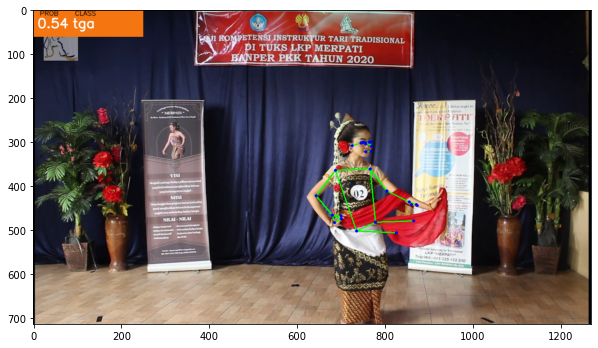

 98%|██████████████████████████████████████████████████████████████████████████▊ | 2952/3000.0 [05:17<00:09,  5.26it/s]

tga [0.33 0.52 0.15]
tga [0.34 0.53 0.13]
tga [0.33 0.53 0.14]


 99%|██████████████████████████████████████████████████████████████████████████▉ | 2956/3000.0 [05:18<00:05,  7.48it/s]

tga [0.34 0.53 0.13]
tga [0.34 0.51 0.15]
tga [0.34 0.54 0.12]


 99%|██████████████████████████████████████████████████████████████████████████▉ | 2960/3000.0 [05:18<00:04,  9.90it/s]

tga [0.32 0.56 0.12]
tga [0.35 0.56 0.09]
tga [0.38 0.53 0.09]



 99%|███████████████████████████████████████████████████████████████████████████ | 2962/3000.0 [05:18<00:03, 10.86it/s]

tga [0.33 0.6  0.07]
tga [0.37 0.56 0.07]
tga [0.37 0.49 0.14]


 99%|███████████████████████████████████████████████████████████████████████████▏| 2966/3000.0 [05:19<00:03, 10.95it/s]

tga [0.39 0.49 0.12]
tga [0.4  0.49 0.11]
tga [0.42 0.47 0.11]



 99%|███████████████████████████████████████████████████████████████████████████▏| 2968/3000.0 [05:19<00:03, 10.59it/s]

tga [0.38 0.54 0.08]
tga [0.38 0.51 0.11]



 99%|███████████████████████████████████████████████████████████████████████████▏| 2970/3000.0 [05:19<00:02, 10.22it/s]

tga [0.39 0.5  0.11]
tga [0.39 0.48 0.13]
tga [0.39 0.49 0.12]



 99%|███████████████████████████████████████████████████████████████████████████▎| 2972/3000.0 [05:19<00:02, 10.31it/s]

tga [0.36 0.53 0.11]
tga [0.38 0.5  0.12]
tga [0.38 0.51 0.11]


 99%|███████████████████████████████████████████████████████████████████████████▍| 2976/3000.0 [05:20<00:02, 10.85it/s]

tga [0.38 0.5  0.12]
tga [0.4  0.51 0.09]
tga [0.36 0.55 0.09]



 99%|███████████████████████████████████████████████████████████████████████████▍| 2978/3000.0 [05:20<00:02, 10.87it/s]

tga [0.37 0.56 0.07]
tga [0.35 0.54 0.11]
tga [0.38 0.52 0.1 ]


 99%|███████████████████████████████████████████████████████████████████████████▌| 2982/3000.0 [05:20<00:01, 10.36it/s]

tga [0.35 0.56 0.09]
tga [0.38 0.49 0.13]
tga [0.42 0.47 0.11]



 99%|███████████████████████████████████████████████████████████████████████████▌| 2984/3000.0 [05:20<00:01, 10.38it/s]

tga [0.4  0.48 0.12]
tga [0.41 0.51 0.08]
tga


100%|███████████████████████████████████████████████████████████████████████████▋| 2986/3000.0 [05:21<00:01, 10.30it/s]

 [0.37 0.55 0.08]
tga [0.35 0.54 0.11]
tga [0.35 0.56 0.09]


100%|███████████████████████████████████████████████████████████████████████████▋| 2990/3000.0 [05:21<00:00, 10.23it/s]

tga [0.27 0.53 0.2 ]
tga [0.36 0.5  0.14]
tga [0.32 0.61 0.07]


100%|███████████████████████████████████████████████████████████████████████████▊| 2994/3000.0 [05:21<00:00, 10.88it/s]

tga [0.36 0.57 0.07]
tga [0.4  0.52 0.08]
tga [0.4  0.51 0.09]



100%|███████████████████████████████████████████████████████████████████████████▉| 2996/3000.0 [05:22<00:00, 10.42it/s]

tga [0.37 0.54 0.09]
tga [0.38 0.53 0.09]
tga 


100%|███████████████████████████████████████████████████████████████████████████▉| 2998/3000.0 [05:22<00:00, 10.51it/s]

[0.38 0.53 0.09]
tga [0.34 0.54 0.12]
tga [0.39 0.49 0.12]


100%|████████████████████████████████████████████████████████████████████████████| 3000/3000.0 [05:22<00:00,  9.31it/s]

tga [0.39 0.51 0.1 ]


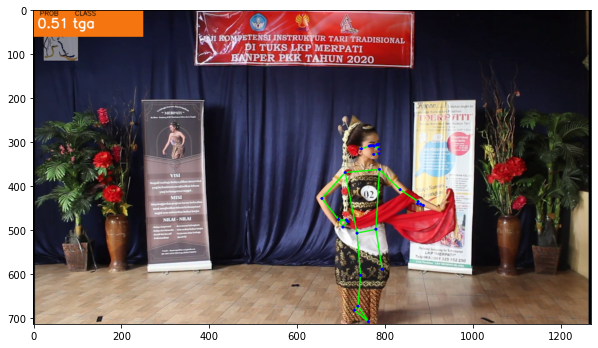

In [ ]:
import os
import tqdm

from mediapipe.python.solutions import drawing_utils as mp_drawing

video_path='D:/SKRIPSI 2021/Bahan skripsi/Dataset/sample.mp4'
out_video_path='dance-sample-out.mov'
pose_tracker = mp_pose.Pose()

video_cap = cv2.VideoCapture(video_path)

# Get some video parameters to generate output video with classificaiton.
video_n_frames = video_cap.get(cv2.CAP_PROP_FRAME_COUNT)
video_fps = video_cap.get(cv2.CAP_PROP_FPS)
video_width = int(video_cap.get(cv2.CAP_PROP_FRAME_WIDTH))
video_height = int(video_cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
print(video_width, video_height)
# Open output video.
out_video = cv2.VideoWriter(out_video_path, cv2.VideoWriter_fourcc(*'mp4v'), video_fps, (video_width, video_height))

frame_idx = 0
output_frame = None
with tqdm.tqdm(total=video_n_frames, position=0, leave=True) as pbar:
  while True:
    # Get next frame of the video.
    success, input_frame = video_cap.read()
    if not success:
      break

    # Run pose tracker.
    input_frame = cv2.cvtColor(input_frame, cv2.COLOR_BGR2RGB)
    result = pose_tracker.process(image=input_frame)
    pose_landmarks = result.pose_landmarks

    # Draw pose prediction.
    output_frame = input_frame.copy()
    if pose_landmarks is not None:
      mp_drawing.draw_landmarks(image=output_frame, landmark_list=pose_landmarks, connections=mp_pose.POSE_CONNECTIONS)
    
    if pose_landmarks is not None:
      # Get landmarks.
      frame_height, frame_width, _ = output_frame.shape
      pose_landmarks = list(np.array([[lmk.x * frame_width, lmk.y * frame_height, lmk.z * frame_width]
                                 for lmk in pose_landmarks.landmark], dtype=np.float32).flatten())
      pose_landmarks = pd.DataFrame([pose_landmarks])

      # Classify the pose on the current frame.
      dance_class = model.predict(pose_landmarks)[0]
      dance_class_prob = model.predict_proba(pose_landmarks)[0]
      print(dance_class, dance_class_prob)

      
    # Draw classification plot and repetition counter.
    cv2.rectangle(output_frame, (0,0), (250, 60), (245, 117, 16), -1)

    # Display Class
    cv2.putText(output_frame, 'CLASS'
            , (95,12), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
    cv2.putText(output_frame, dance_class.split(' ')[0]
            , (90,40), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)

    # Display Probability
    cv2.putText(output_frame, 'PROB'
            , (15,12), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 1, cv2.LINE_AA)
    cv2.putText(output_frame, str(round(dance_class_prob[np.argmax(dance_class_prob)], 2))
            , (10,40), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)

    # Save the output frame.
    out_video.write(cv2.cvtColor(np.array(output_frame), cv2.COLOR_RGB2BGR))

    # Show intermediate frames of the video to track progress.
    if frame_idx % 50 == 0:
      show_image(output_frame)

    frame_idx += 1
    pbar.update()

# Close output video.
out_video.release()

# Release MediaPipe resources.
pose_tracker.close()

# Show the last frame of the video.
if output_frame is not None:
  show_image(output_frame)